# Climate Data Analysis Notebook

**Author:** basil abdelgadir

This notebook contains analysis and visualization of climate data using Python. It explores various aspects of climate data, including temperature, pressure, humidity, and wind speed, using time series analysis techniques and machine learning models.

Feel free to explore the code and visualizations to gain insights into climate patterns and trends.



**Data Description:**

The climate data used in this analysis spans from the start of 2010 to 2017 and is recorded at 10-minute intervals. The dataset includes the following columns:

- `Date Time`: The timestamp of each observation.
- `p (mbar)`: The atmospheric pressure in millibars.
- `T (degC)`: The air temperature in degrees Celsius.
- `Tpot (K)`: The potential temperature in Kelvin.
- `Tdew (degC)`: The dew point temperature in degrees Celsius.
- `rh (%)`: The relative humidity as a percentage.
- `VPmax (mbar)`: The saturation water vapor pressure in millibars.
- `VPact (mbar)`: The actual water vapor pressure in millibars.
- `VPdef (mbar)`: The vapor pressure deficit in millibars.
- `sh (g/kg)`: The specific humidity in grams per kilogram.
- `H2OC (mmol/mol)`: The water vapor concentration in millimoles per mole.
- `rho (g/m**3)`: The air density in grams per cubic meter.
- `wv (m/s)`: The wind velocity in meters per second.
- `max. wv (m/s)`: The maximum wind velocity in meters per second.
- `wd (deg)`: The wind direction in degrees.

The dataset provides a comprehensive record of various climate variables over the specified time period and at a high temporal resolution. This description serves as the foundation for understanding the subsequent analysis and interpretations derived from the data.


**Main Objective:**

The primary objective of this analysis is to gain insights into the climate patterns and trends captured in the provided dataset. Specifically, we aim to understand how various climate variables, including atmospheric pressure, temperature, humidity, and wind characteristics, evolve over the time period from the start of 2010 to 2017.

**Model Selection:**

For this analysis, we employed a Long Short-Term Memory (LSTM) model. LSTMs are a type of recurrent neural network (RNN) that is well-suited for time series forecasting tasks. Given the temporal nature of climate data, the LSTM model is chosen for its ability to capture long-term dependencies and patterns in sequential data. The model is trained to predict future values based on historical observations, allowing us to explore the potential of deep learning techniques in understanding and forecasting climate dynamics.


**Plan of Action :**


1. **Data Loading and Initial Inspection:**
   - Loaded the climate data from the provided CSV file and inspected the columns for initial understanding.

2. **Data Cleaning:**
   - Removed any duplicate rows from the dataset to ensure data integrity.
   - Converted the 'Date Time' column to datetime format for time-based analysis.

3. **Resampling and Handling Missing Values:**
   - Resampled the data with a 10-minute frequency to standardize the time intervals.
   - Reindexed the DataFrame with the new index and filled missing values with 0 to maintain consistency.

4. **Handling Zero Values:**
   - Replaced zero values in specific columns ('wv (m/s)' and 'max. wv (m/s)') with 0 to address data anomalies.

5. **Removing Duplicate Columns:**
   - Checked for and removed any duplicate columns in the DataFrame to avoid redundancy.

6. **Resampling for Aggregating Data:**
   - Calculated daily, weekly, monthly, quarterly, and annual averages of the climate variables to analyze aggregated trends.

7. **Rolling Window Analysis:**
   - Conducted rolling window analysis with varying window sizes to observe short-term trends and variability.

8. **Seasonal Decomposition:**
   - Applied seasonal decomposition using the 'seasonal_decompose' function to decompose the time series into trend, seasonal, and residual components.

9. **Moving Average Smoothing:**
   - Smoothed the data using moving average techniques to reduce noise and visualize long-term trends more effectively.


10. **Feature Engineering:**
    - Extract relevant features from the preprocessed data for modeling, considering factors such as atmospheric pressure, temperature, humidity, etc.

11. **Exploratory Data Analysis (EDA):**
    - Perform exploratory data analysis to gain insights into the distribution and relationships between different climate variables.

12. **Data Preparation for LSTM:**
    - Normalize the features using Min-Max scaling and define the sequence length for LSTM training.

13. **Model Selection:**
    - Choose the LSTM model for time series forecasting based on its ability to capture temporal dependencies.

14. **Training the LSTM Model:**
    - Split the dataset into training and testing sets and train the LSTM model.

15. **Model Evaluation:**
    - Evaluate the performance of the LSTM model using appropriate metrics on the test dataset.

16. **Conclusion and Future Directions:**
    - Summarize key findings and limitations of the analysis, and propose future directions for improvement.


### Time Series Analysis for Climate Data

In this section, we conduct a **time series analysis** to evaluate **climate data**. We start by importing necessary libraries and setting up our plotting environment. We utilize `pandas` for data manipulation, `numpy` for numerical computations, `matplotlib` and `seaborn` for data visualization, and various utilities for handling date and time-related operations.

We also set up the plotting palette for visual consistency across our graphs. Additionally, we **ignore any warning messages** to maintain a clean notebook display. The default display format for floating-point numbers is set to **one decimal place** for better readability.



In [27]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from datetime import datetime
from datetime import timedelta
from dateutil.relativedelta import relativedelta
from IPython.display import display
import os
os.chdir('data')
from colorsetup import colors, palette
sns.set_palette(palette)
# ignore warnings
warnings.filterwarnings('ignore')
pd.options.display.float_format = '{:,.1f}'.format
%matplotlib inline
plotsize = (6, 4)
plt.rcParams['figure.figsize'] = [4, 4]  # [width, height] in inches
plt.rcParams['figure.subplot.wspace'] = 0.4  # Adjust the width space between subplots
plt.rcParams['figure.subplot.hspace'] = 0.4  


### Loading Climate Data

In this section, we load the climate data from the CSV file `jena_climate_2009_2016.csv`. We use the `pd.read_csv()` function from the `pandas` library to read the data into a DataFrame named `df`. After loading the data, we display the column names using the `.columns` attribute of the DataFrame.


In [2]:
path='jena_climate_2009_2016.csv'
df = pd.read_csv(path,)
df.columns

Index(['Date Time', 'p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)',
       'rh (%)', 'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
       'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
       'wd (deg)'],
      dtype='object')

### Examining Climate Data Information

In this section, we examine information about the climate data stored in the DataFrame `df`. We use the `.info()` method of the DataFrame to get a concise summary that includes the column data types, non-null values, and memory usage.


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 420551 entries, 0 to 420550
Data columns (total 15 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Date Time        420551 non-null  object 
 1   p (mbar)         420551 non-null  float64
 2   T (degC)         420551 non-null  float64
 3   Tpot (K)         420551 non-null  float64
 4   Tdew (degC)      420551 non-null  float64
 5   rh (%)           420551 non-null  float64
 6   VPmax (mbar)     420551 non-null  float64
 7   VPact (mbar)     420551 non-null  float64
 8   VPdef (mbar)     420551 non-null  float64
 9   sh (g/kg)        420551 non-null  float64
 10  H2OC (mmol/mol)  420551 non-null  float64
 11  rho (g/m**3)     420551 non-null  float64
 12  wv (m/s)         420551 non-null  float64
 13  max. wv (m/s)    420551 non-null  float64
 14  wd (deg)         420551 non-null  float64
dtypes: float64(14), object(1)
memory usage: 48.1+ MB


### Removing Duplicate Entries

In this section, we remove any duplicate entries from the climate data DataFrame `df`. We use the `.drop_duplicates()` method with the parameter `inplace=True` to modify the DataFrame in place, ensuring that only unique rows remain.


In [4]:
df.drop_duplicates(inplace=True)

### Converting Date Time Column

In this section, we convert the 'Date Time' column in the climate data DataFrame `df` to the datetime data type using the `.astype('datetime64')` method. This conversion allows us to perform time-based operations and analysis on the data effectively.


In [5]:
df['Date Time'] = df['Date Time'].astype('datetime64')

### Grouping Climate Data Variables

In this section, we define a list of `variables` representing different climate data parameters. We then specify `group_variables` as the first variable in the list to group the data by, and `outcome_variable` as the remaining variables to compute the mean of.

We proceed by grouping the climate data DataFrame `df` by the `group_variables` and calculating the mean of the `outcome_variable` for each group. The results are stored in a new DataFrame named `base` for further analysis.


In [6]:
variables = ['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)',
       'rh (%)', 'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
       'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
       'wd (deg)']
group_variables = variables[:1]
outcome_variable = variables[1:]
base = df.groupby(group_variables)[outcome_variable].mean().reset_index()

In [7]:
base.head()

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,913.6,25.1,306.1,15.1,53.7,31.9,17.1,14.8,11.8,18.8,"1,059.5",3.6,5.2,177.2
1,914.1,25.3,306.3,14.5,51.2,32.4,16.6,15.8,11.3,18.1,"1,059.5",3.6,6.4,164.4
2,917.4,25.3,305.9,13.5,48.1,32.2,15.5,16.7,10.6,16.9,"1,064.1",4.5,7.0,179.0
3,918.3,25.6,306.1,13.1,45.9,32.8,15.1,17.8,10.3,16.4,"1,064.3",4.3,6.2,174.8
4,918.5,25.1,305.6,13.1,47.3,31.9,15.1,16.8,10.3,16.4,"1,066.2",4.0,6.5,179.6


In [8]:
print("Columns:", base.columns)
print("Index:", base.index)

Columns: Index(['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
       'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
       'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
       'wd (deg)'],
      dtype='object')
Index: RangeIndex(start=0, stop=6117, step=1)


### Setting Index to Date Time

In this section, we set the index of the climate data DataFrame `df` to the 'Date Time' column using the `.set_index()` method with `inplace=True`. By setting the index to the date and time values, we can easily perform time-based operations and analysis on the data.


In [9]:
df.set_index('Date Time',inplace=True)

In [10]:
df.index.max()

Timestamp('2017-01-01 00:00:00')

### Generating New Date-Time Index

In this section, we generate a new date-time index named `newindex` using the `pd.date_range()` function. The new index spans from the minimum date and time value in the existing index of the climate data DataFrame `df` to the maximum date and time value, with a frequency of every 10 minutes (`freq='10min'`).

This new index will be used to ensure consistent time intervals for the data and facilitate further time-based analysis and processing.



In [11]:
newindex=pd.date_range(df.index.min(),df.index.max(),freq='10min')

In [12]:
newindex

DatetimeIndex(['2009-01-01 00:10:00', '2009-01-01 00:20:00',
               '2009-01-01 00:30:00', '2009-01-01 00:40:00',
               '2009-01-01 00:50:00', '2009-01-01 01:00:00',
               '2009-01-01 01:10:00', '2009-01-01 01:20:00',
               '2009-01-01 01:30:00', '2009-01-01 01:40:00',
               ...
               '2016-12-31 22:30:00', '2016-12-31 22:40:00',
               '2016-12-31 22:50:00', '2016-12-31 23:00:00',
               '2016-12-31 23:10:00', '2016-12-31 23:20:00',
               '2016-12-31 23:30:00', '2016-12-31 23:40:00',
               '2016-12-31 23:50:00', '2017-01-01 00:00:00'],
              dtype='datetime64[ns]', length=420768, freq='10T')

In [13]:
newindex.drop_duplicates('false')

DatetimeIndex(['2009-01-01 00:10:00', '2009-01-01 00:20:00',
               '2009-01-01 00:30:00', '2009-01-01 00:40:00',
               '2009-01-01 00:50:00', '2009-01-01 01:00:00',
               '2009-01-01 01:10:00', '2009-01-01 01:20:00',
               '2009-01-01 01:30:00', '2009-01-01 01:40:00',
               ...
               '2016-12-31 22:30:00', '2016-12-31 22:40:00',
               '2016-12-31 22:50:00', '2016-12-31 23:00:00',
               '2016-12-31 23:10:00', '2016-12-31 23:20:00',
               '2016-12-31 23:30:00', '2016-12-31 23:40:00',
               '2016-12-31 23:50:00', '2017-01-01 00:00:00'],
              dtype='datetime64[ns]', length=420768, freq='10T')

In [14]:
newindex.freq='10min'

In [15]:
df.drop_duplicates(inplace=True)


In [16]:
df

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
Date Time,,,,,,,,,,,,,,
2009-01-01 00:10:00,996.5,-8.0,265.4,-8.9,93.3,3.3,3.1,0.2,1.9,3.1,"1,307.8",1.0,1.8,152.3
2009-01-01 00:20:00,996.6,-8.4,265.0,-9.3,93.4,3.2,3.0,0.2,1.9,3.0,"1,309.8",0.7,1.5,136.1
2009-01-01 00:30:00,996.5,-8.5,264.9,-9.3,93.9,3.2,3.0,0.2,1.9,3.0,"1,310.2",0.2,0.6,171.6
2009-01-01 00:40:00,996.5,-8.3,265.1,-9.1,94.2,3.3,3.1,0.2,1.9,3.1,"1,309.2",0.3,0.5,198.0
2009-01-01 00:50:00,996.5,-8.3,265.1,-9.0,94.1,3.3,3.1,0.2,1.9,3.1,"1,309.0",0.3,0.6,214.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 23:20:00,"1,000.1",-4.0,269.1,-8.1,73.1,4.5,3.3,1.2,2.1,3.3,"1,293.0",0.7,1.5,240.0
2016-12-31 23:30:00,999.9,-3.4,269.8,-8.1,69.7,4.8,3.3,1.4,2.1,3.3,"1,289.4",1.1,1.9,234.3
2016-12-31 23:40:00,999.8,-3.2,270.0,-8.2,67.9,4.8,3.3,1.6,2.0,3.3,"1,288.4",1.1,2.0,215.2


### Reindexing DataFrame with New Date-Time Index

In this section, we reindex the climate data DataFrame `df` with the new date-time index `newindex` using the `.reindex()` method. We specify `fill_value=0` to fill any missing values with zeros in the reindexed DataFrame `df_new`.

Reindexing the DataFrame ensures that all time intervals specified by the new index are accounted for, even if there were missing entries in the original DataFrame. This step prepares the data for further time-based analysis and processing.


In [17]:
df_new=df.reindex(newindex,fill_value=0)



### Handling Duplicate Columns and Rows

In this section, we address duplicate columns and rows in the climate data DataFrame `df`.

- We first check if the column names are unique using the `.is_unique` attribute of the DataFrame's `columns`. This helps ensure data integrity and avoid redundancy in column names.

- Next, we identify and mark duplicate columns using the `.duplicated()` method on the DataFrame's `columns`. This allows us to identify any duplicate columns for further processing.

- We then use boolean indexing to select only the unique columns in the DataFrame, excluding any duplicated columns.

- Lastly, we address duplicate rows by using the `.index.duplicated()` method to identify and select only the unique rows in the DataFrame, ensuring that each row represents distinct data points.

These steps help ensure the consistency and integrity of the climate data for accurate analysis and interpretation.


In [18]:
df.columns.is_unique
df.columns.duplicated()
df.loc[:, ~df.columns.duplicated()]
df.loc[~df.index.duplicated(), :]

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
Date Time,,,,,,,,,,,,,,
2009-01-01 00:10:00,996.5,-8.0,265.4,-8.9,93.3,3.3,3.1,0.2,1.9,3.1,"1,307.8",1.0,1.8,152.3
2009-01-01 00:20:00,996.6,-8.4,265.0,-9.3,93.4,3.2,3.0,0.2,1.9,3.0,"1,309.8",0.7,1.5,136.1
2009-01-01 00:30:00,996.5,-8.5,264.9,-9.3,93.9,3.2,3.0,0.2,1.9,3.0,"1,310.2",0.2,0.6,171.6
2009-01-01 00:40:00,996.5,-8.3,265.1,-9.1,94.2,3.3,3.1,0.2,1.9,3.1,"1,309.2",0.3,0.5,198.0
2009-01-01 00:50:00,996.5,-8.3,265.1,-9.0,94.1,3.3,3.1,0.2,1.9,3.1,"1,309.0",0.3,0.6,214.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 23:20:00,"1,000.1",-4.0,269.1,-8.1,73.1,4.5,3.3,1.2,2.1,3.3,"1,293.0",0.7,1.5,240.0
2016-12-31 23:30:00,999.9,-3.4,269.8,-8.1,69.7,4.8,3.3,1.4,2.1,3.3,"1,289.4",1.1,1.9,234.3
2016-12-31 23:40:00,999.8,-3.2,270.0,-8.2,67.9,4.8,3.3,1.6,2.0,3.3,"1,288.4",1.1,2.0,215.2


In [19]:
df_new.head()

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
2009-01-01 00:10:00,996.5,-8.0,265.4,-8.9,93.3,3.3,3.1,0.2,1.9,3.1,"1,307.8",1.0,1.8,152.3
2009-01-01 00:20:00,996.6,-8.4,265.0,-9.3,93.4,3.2,3.0,0.2,1.9,3.0,"1,309.8",0.7,1.5,136.1
2009-01-01 00:30:00,996.5,-8.5,264.9,-9.3,93.9,3.2,3.0,0.2,1.9,3.0,"1,310.2",0.2,0.6,171.6
2009-01-01 00:40:00,996.5,-8.3,265.1,-9.1,94.2,3.3,3.1,0.2,1.9,3.1,"1,309.2",0.3,0.5,198.0
2009-01-01 00:50:00,996.5,-8.3,265.1,-9.0,94.1,3.3,3.1,0.2,1.9,3.1,"1,309.0",0.3,0.6,214.3


In [20]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 420768 entries, 2009-01-01 00:10:00 to 2017-01-01 00:00:00
Freq: 10T
Data columns (total 14 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   p (mbar)         420768 non-null  float64
 1   T (degC)         420768 non-null  float64
 2   Tpot (K)         420768 non-null  float64
 3   Tdew (degC)      420768 non-null  float64
 4   rh (%)           420768 non-null  float64
 5   VPmax (mbar)     420768 non-null  float64
 6   VPact (mbar)     420768 non-null  float64
 7   VPdef (mbar)     420768 non-null  float64
 8   sh (g/kg)        420768 non-null  float64
 9   H2OC (mmol/mol)  420768 non-null  float64
 10  rho (g/m**3)     420768 non-null  float64
 11  wv (m/s)         420768 non-null  float64
 12  max. wv (m/s)    420768 non-null  float64
 13  wd (deg)         420768 non-null  float64
dtypes: float64(14)
memory usage: 64.3 MB


### Resampling Climate Data

In this section, we resample the climate data DataFrame `df_new` to calculate daily, weekly, monthly, quarterly, and annual averages.

- **Daily Averages:** We resample the data to calculate daily averages using the `.resample('d').mean()` method, which aggregates the data into daily intervals and computes the mean value for each day.
- **Weekly Averages:** We compute weekly averages by resampling the data with a weekly frequency using the `.resample('W').mean()` method.
- **Monthly Averages:** Monthly averages are calculated by resampling the data with a monthly frequency using the `.resample('M').mean()` method.
- **Quarterly Averages:** Quarterly averages are computed by resampling the data with a quarterly frequency using the `.resample('Q').mean()` method.
- **Annual Averages:** Finally, we calculate annual averages by resampling the data with an annual frequency using the `.resample('Y').mean()` method.

Each resampling operation provides insights into the average climate data trends over different time intervals, allowing for a comprehensive analysis of the data across various temporal scales.


In [21]:
df_daily = df_new.resample('d').mean()
print('daily averages')
print(df_daily.head(), '\n')
df_weekly = df_new.resample('W').mean()
print('Weekly averages')
print(df_weekly.head(), '\n')

df_monthly = df_new.resample('M').mean()
print('Monthly averages')
print(df_monthly.head(), '\n')

df_quarterly = df_new.resample('Q').mean()
print('Quarterly averages')
print(df_quarterly.head(), '\n')

df_annual = df_new.resample('Y').mean()
print('Annual averages')
print(df_annual.head())

daily averages
            p (mbar)  T (degC)  Tpot (K)  Tdew (degC)  rh (%)  VPmax (mbar)  \
2009-01-01     999.1      -6.8     266.4         -8.0    91.1           3.7   
2009-01-02     985.8      -3.4     270.9         -5.8    83.5           4.8   
2009-01-03     984.9       5.4     279.8          3.3    86.9           9.1   
2009-01-04     993.9       7.3     280.9         -0.3    61.9          10.8   
2009-01-05     994.1      12.7     286.3          9.4    81.6          15.0   

            VPact (mbar)  VPdef (mbar)  sh (g/kg)  H2OC (mmol/mol)  \
2009-01-01           3.4           0.3        2.1              3.4   
2009-01-02           4.0           0.8        2.5              4.0   
2009-01-03           7.7           1.4        4.9              7.9   
2009-01-04           6.0           4.8        3.8              6.0   
2009-01-05          11.9           3.1        7.5             12.0   

            rho (g/m**3)  wv (m/s)  max. wv (m/s)  wd (deg)  
2009-01-01       1,305.2   

### Applying Rolling Window Function

In this section, we apply a rolling window function to the climate data DataFrame `df_new`. We define the window size as `win_size = 6`.

We use the `.rolling()` method on the DataFrame `df_new` to create a rolling window object with the specified window size. This rolling window object enables us to perform calculations such as mean, sum, standard deviation, etc., over a fixed window size along the data.

The rolling window function is useful for analyzing trends and identifying patterns in the climate data over a specified time period, providing insights into short-term variations and smoothing out noise in the data.


In [22]:
win_size=6
rolling_window=df_new.rolling(win_size)


### Plotting Quarterly, Monthly, and Weekly Trends

In this section, we plot the quarterly, monthly, and weekly trends for each climate data variable in the DataFrame `df_new`.

We iterate through each column in the DataFrame using a for loop. For each column, we create separate plots to visualize the trends over different time intervals:

- Quarterly Trends: We plot the quarterly trends for each variable using the `.plot()` method with the DataFrame `df_quarterly` and specify the column `col`. The plot size is set to `plotsize`, and the title of the plot indicates the variable name with "Quarterly" appended.
  
- Monthly Trends: Similarly, we plot the monthly trends for each variable using the `.plot()` method with the DataFrame `df_monthly` and specify the column `col`. The plot size is set to `plotsize`, and the title of the plot indicates the variable name with "Monthly" appended.
  
- Weekly Trends: We also plot the weekly trends for each variable using the `.plot()` method with the DataFrame `df_weekly` and specify the column `col`. The plot size is set to `plotsize`, and the title of the plot indicates the variable name with "Weekly" appended.

These plots provide visual insights into the seasonal patterns and fluctuations in the climate data over quarterly, monthly, and weekly intervals.


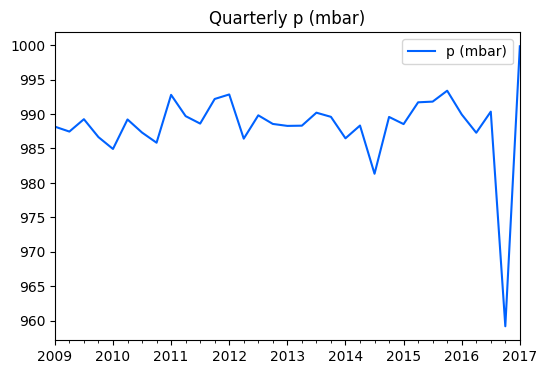

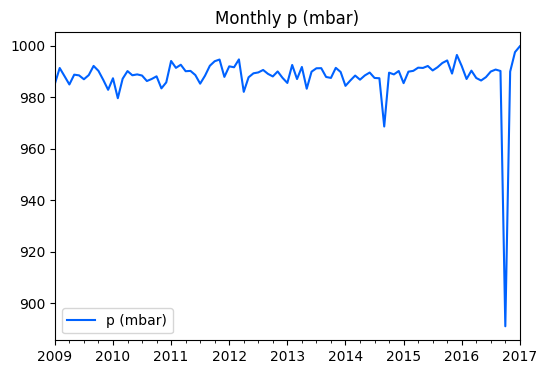

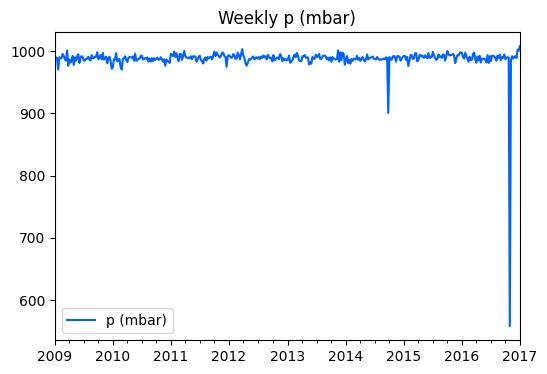

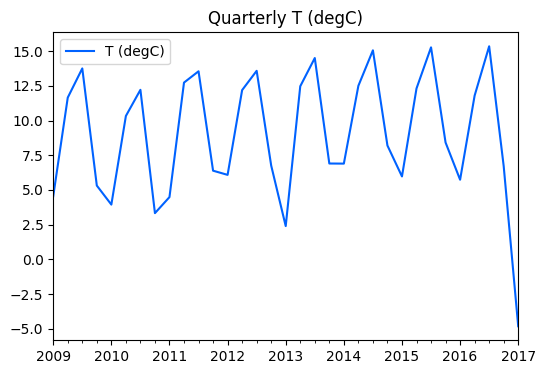

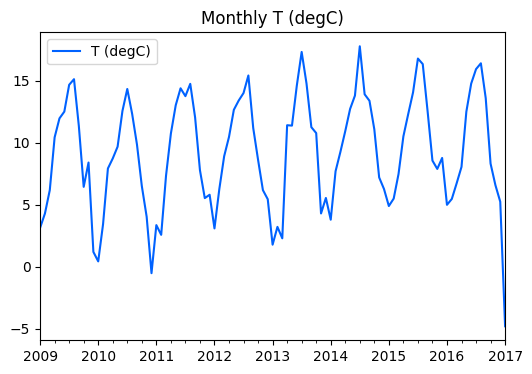

...

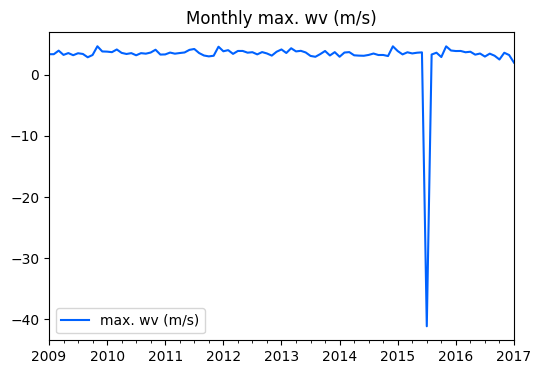

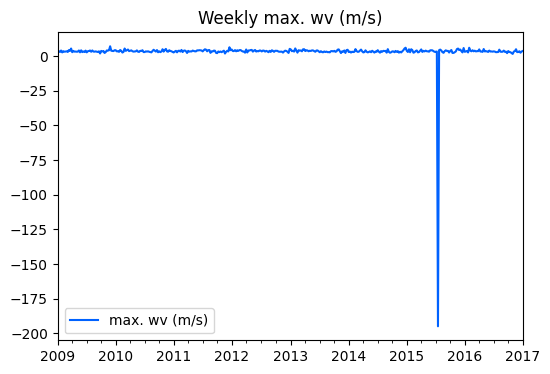

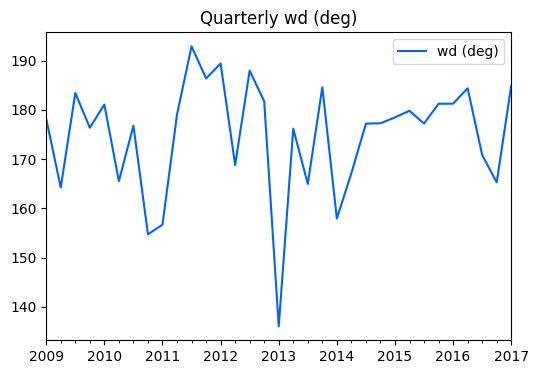

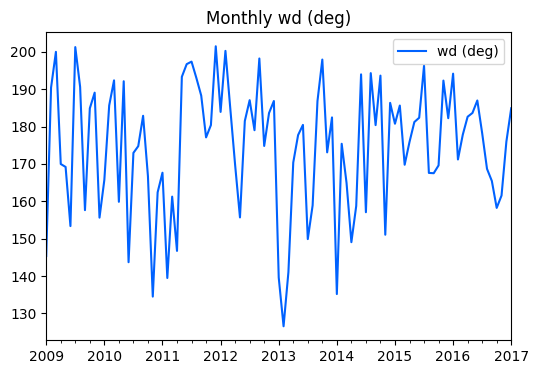

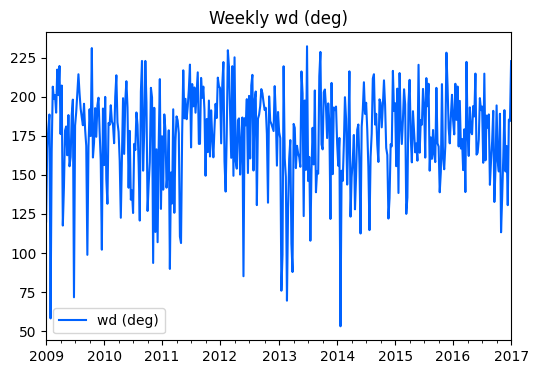

In [28]:
for col in df_new.columns:
 df_quarterly.plot(y=col,figsize=plotsize, title='Quarterly '+col)
#plt.title('Monthly Sales')
 df_monthly.plot(y=col,figsize=plotsize, title='Monthly '+col)
#plt.title('Monthly Sales')
 df_weekly.plot(y=col,figsize=plotsize, title='Weekly '+col)
#plt.title('Monthly Sales')

### Plotting Standard Deviation of 1-Hour Rolling Average

In this section, we plot the standard deviation of the 1-hour rolling average for each climate data variable in the DataFrame `df_new`.

We iterate through each column in the DataFrame using a for loop. For each column, we calculate the standard deviation of the 1-hour rolling average using the `.rolling()` method with a window size of 1 hour and then applying the `.std()` method.

Next, we plot the standard deviation of the 1-hour rolling average for each variable using the `.plot()` method. We specify the DataFrame containing the rolling window calculations (`rolling_window.std()`), specify the column `col`, set the plot size to `plotsize`, and set the title of the plot to indicate the variable name with "standard deviation of 1-hour rolling average" appended.

These plots help visualize the variability and volatility of each climate variable over time, as captured by the standard deviation of the 1-hour rolling average.


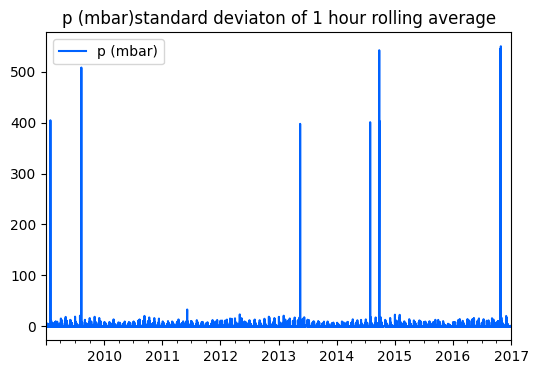

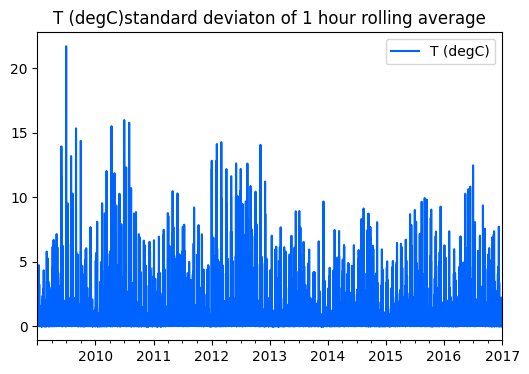

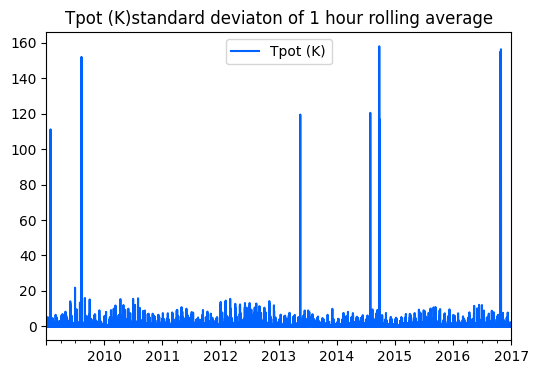

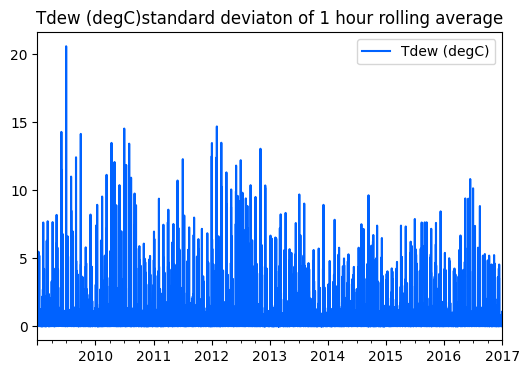

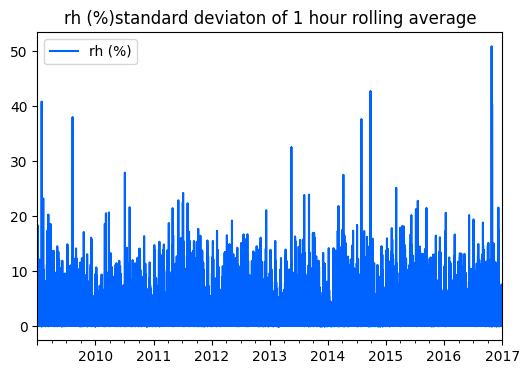

...

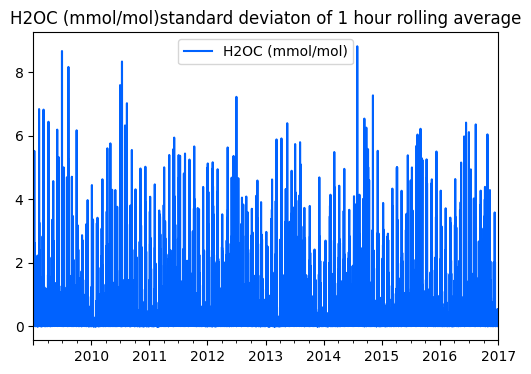

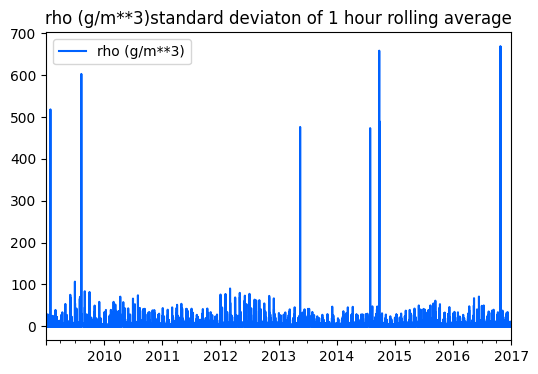

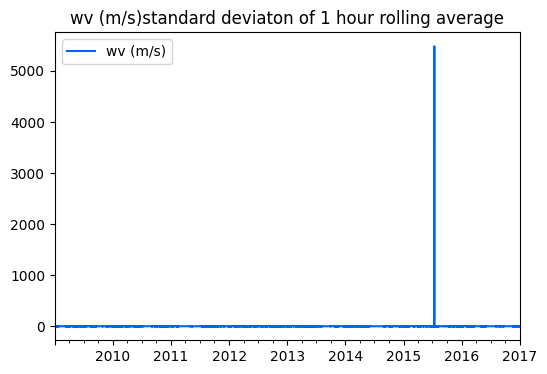

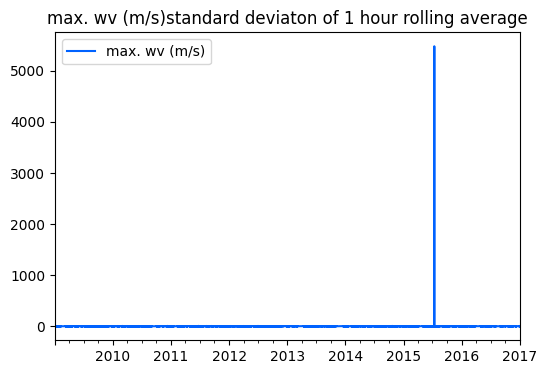

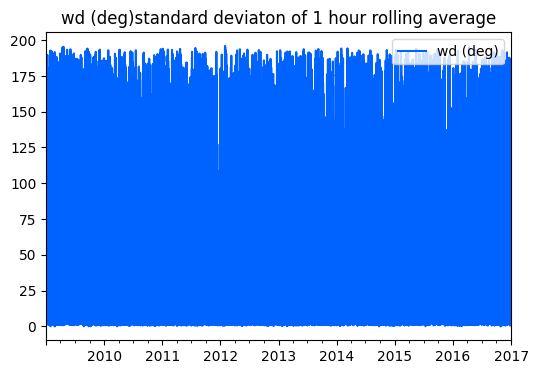

In [29]:
for col in df_new.columns:
    rolling_window.std().plot(y=col,figsize=plotsize,title=col+'standard deviaton of 1 hour rolling average')

### Plotting Weekly Percentage Change

In this section, we plot the weekly percentage change for each climate data variable in the DataFrame `df_new`.

We iterate through each column in the DataFrame using a for loop. For each column, we calculate the weekly percentage change using the `.pct_change()` method with the DataFrame `df_weekly`.

Next, we plot the weekly percentage change for each variable using the `.plot()` method. We specify the DataFrame containing the weekly percentage change calculations (`df_weekly.pct_change()`), specify the column `col`, set the plot size to `plotsize`, and set the title of the plot to indicate the variable name with "weekly % 


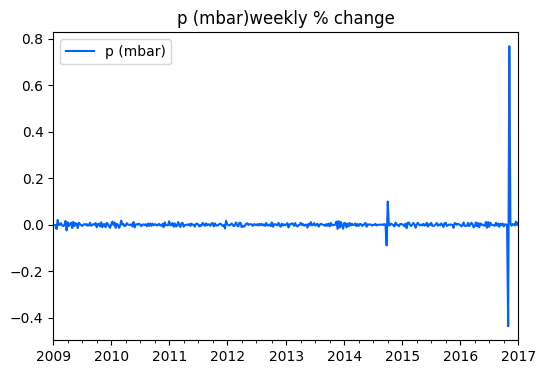

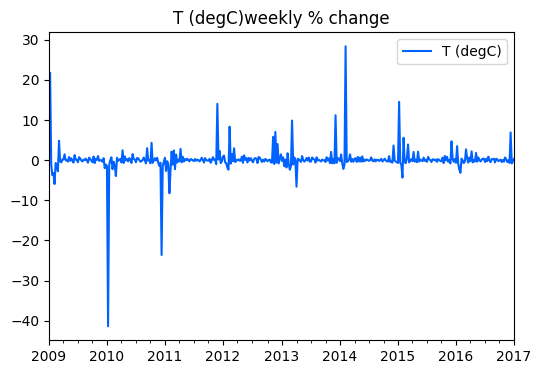

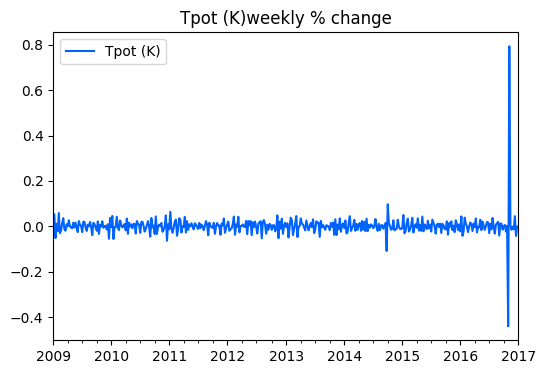

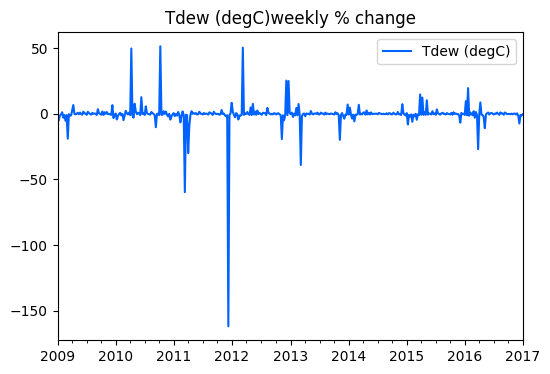

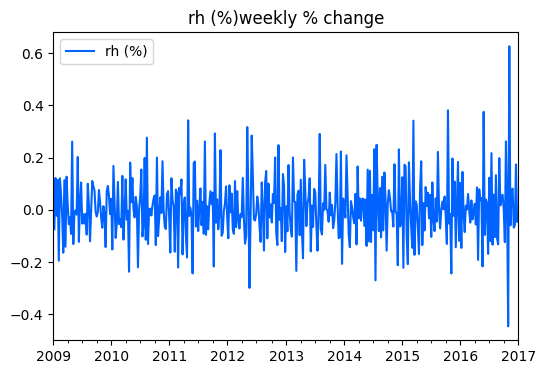

...

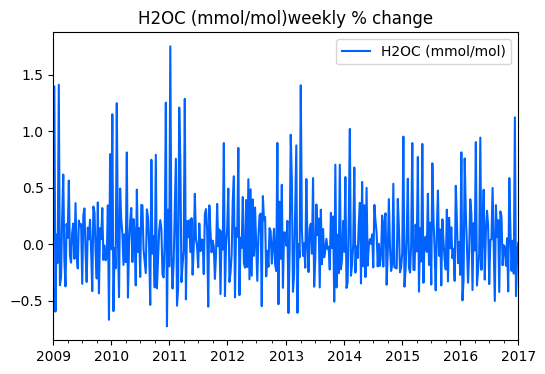

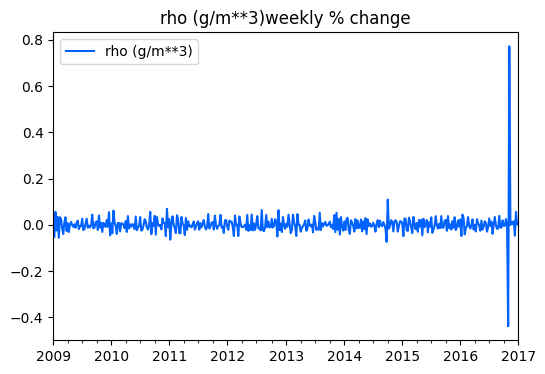

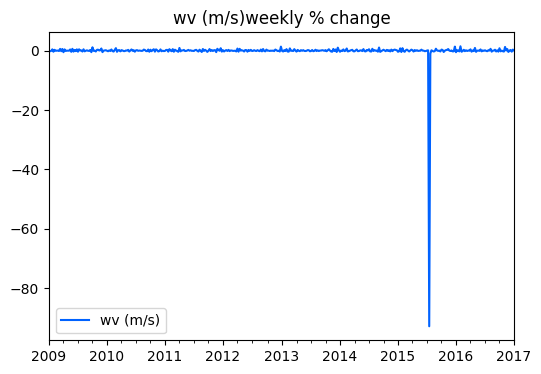

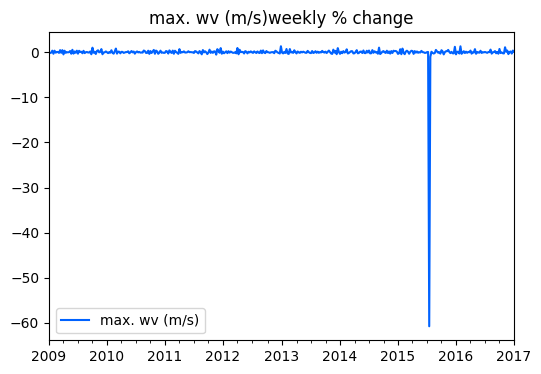

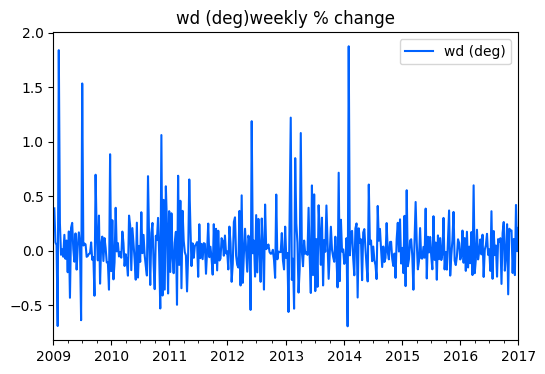

In [30]:
for col in df_new.columns:
    df_weekly.pct_change().plot(y=col,figsize=plotsize,title=col+'weekly % change')

### Plotting Monthly Percentage Change

In this section, we plot the monthly percentage change for each climate data variable in the DataFrame `df_new`.

We iterate through each column in the DataFrame using a for loop. For each column, we calculate the monthly percentage change using the `.pct_change()` method with the DataFrame `df_monthly`.

Next, we plot the monthly percentage change for each variable using the `.plot()` method. We specify the DataFrame containing the monthly percentage change calculations (`df_monthly.pct_change()`), specify the column `col`, set the plot size to `plotsize`, and set the title of the plot to indicate the variable name with "df_monthly % change" appended.

These plots help visualize the monthly percentage change in each climate variable, providing insights into the rate of change over time.


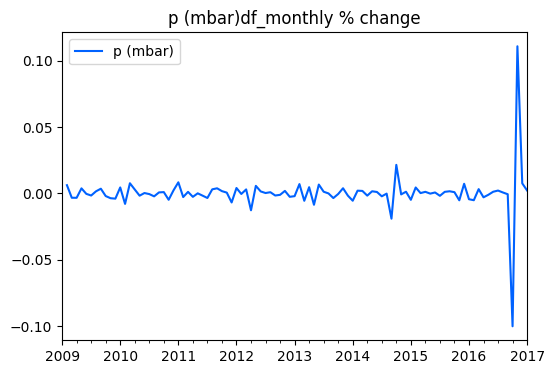

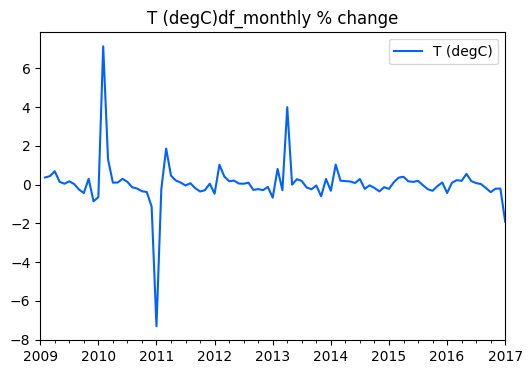

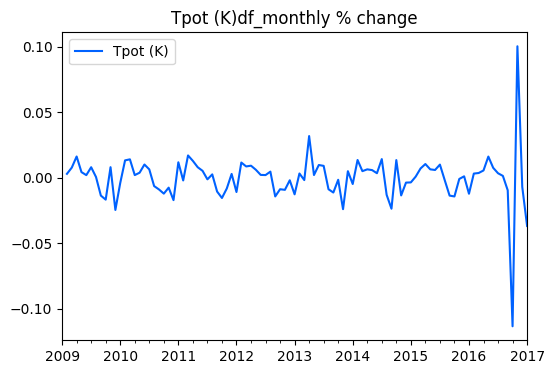

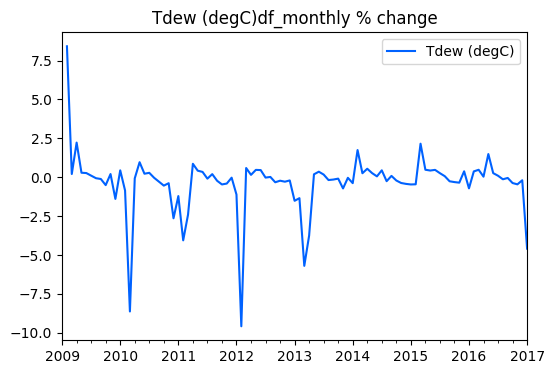

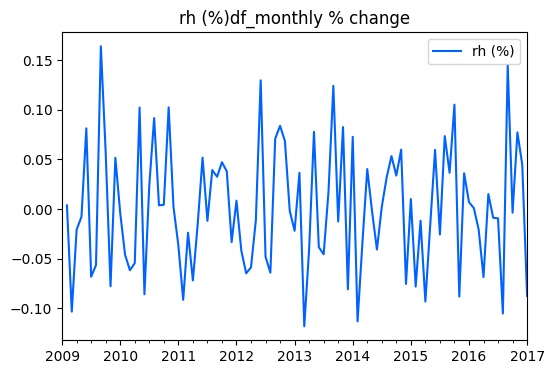

...

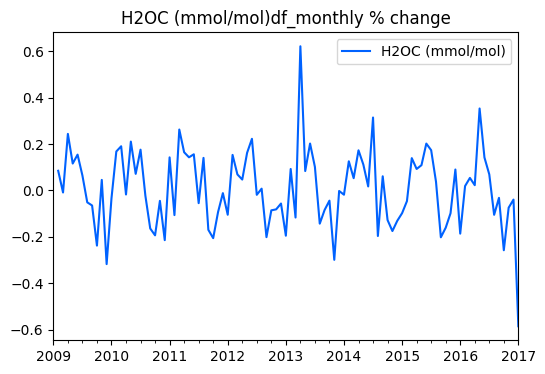

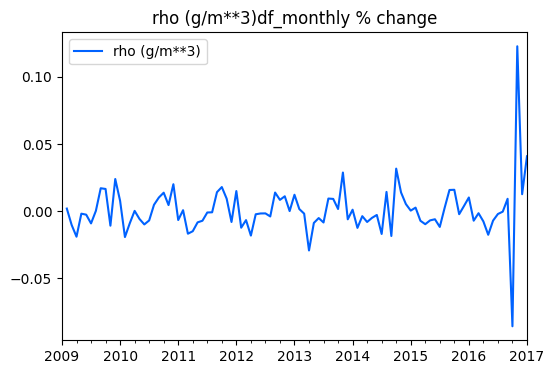

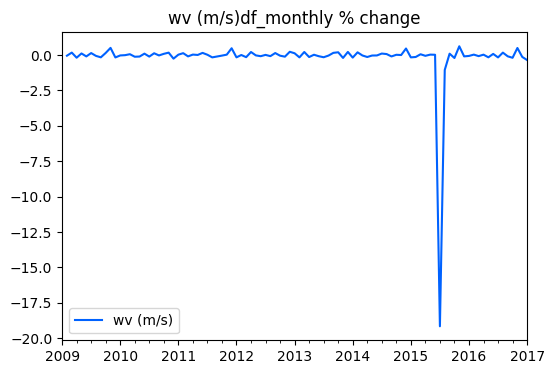

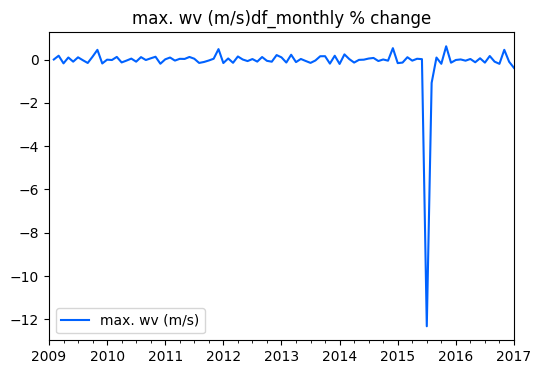

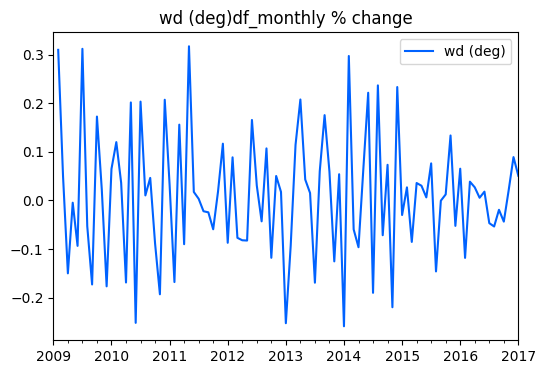

In [31]:
for col in df_new.columns:
    df_monthly.pct_change().plot(y=col,figsize=plotsize,title=col+'df_monthly % change')

### Autocorrelation and Partial Autocorrelation Plots

In this section, we generate autocorrelation and partial autocorrelation plots for each climate data variable in the DataFrame `df_daily` and `df_weekly`.

#### Autocorrelation Plots for Daily Data:
We iterate through each column in the DataFrame `df_daily` using a for loop and generate autocorrelation plots using the `plot_acf()` function from `statsmodels.graphics.tsaplots`. We set the number of lags to 30 and specify the column `col` as the time series data. These plots help us analyze the correlation between a variable's values at different time lags on a daily basis.

#### Partial Autocorrelation Plots for Daily Data:
Similarly, we iterate through each column in the DataFrame `df_daily` and generate partial autocorrelation plots using the `plot_pacf()` function from `statsmodels.graphics.tsaplots`. We set the number of lags to 30 and specify the column `col` as the time series data. These plots help us analyze the direct relationship between a variable's current value and its past values at different time lags on a daily basis.

#### Autocorrelation and Partial Autocorrelation Plots for Weekly Data:
We repeat the above steps for the DataFrame `df_weekly`, generating both autocorrelation and partial autocorrelation plots for each climate data variable. These plots provide insights into the correlation and direct relationship between variable values at different time lags on a weekly basis.

These plots aid in understanding the temporal dependencies and identifying potential patterns in the climate data, essential for time series analysis and forecasting.


autocorelation polt


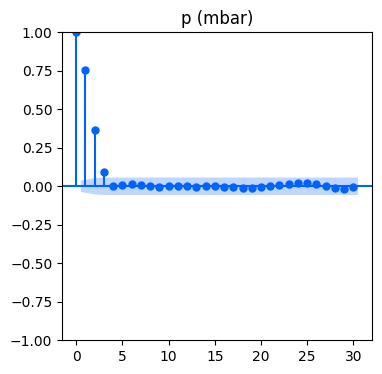

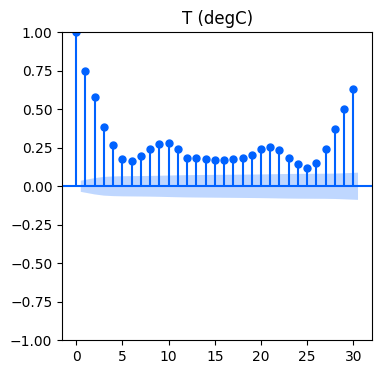

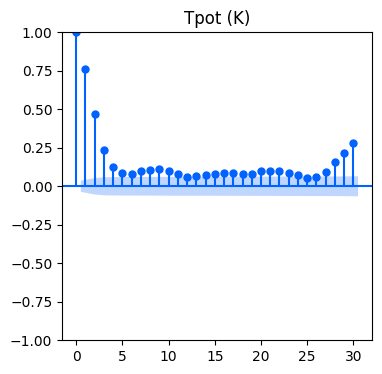

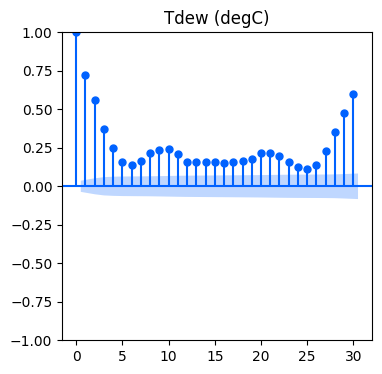

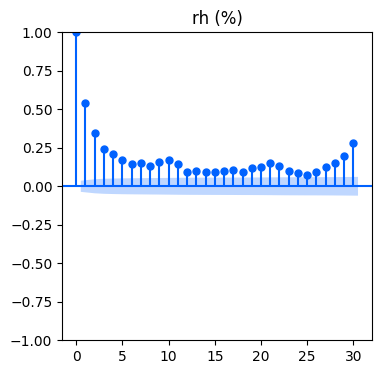

...

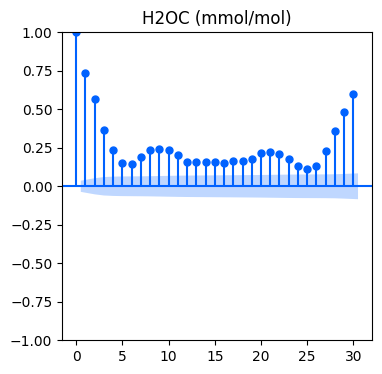

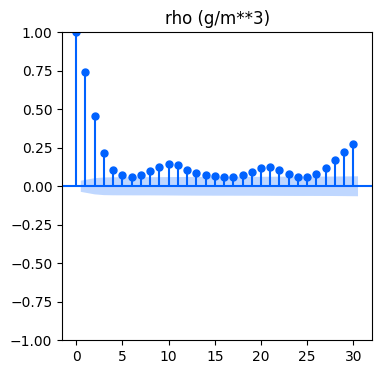

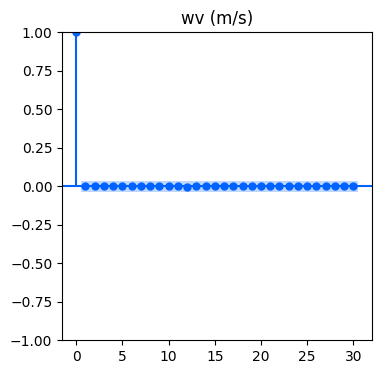

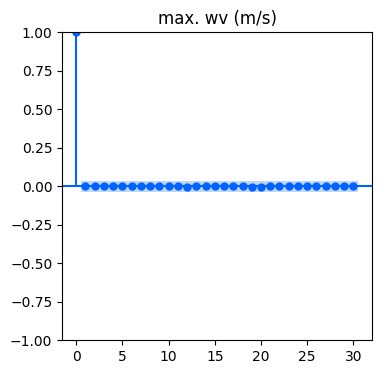

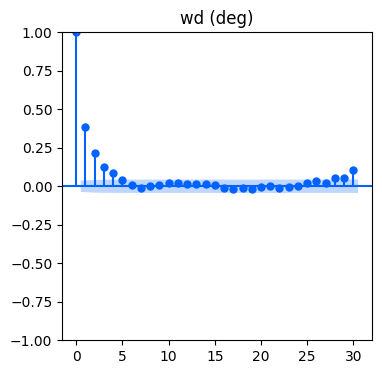

In [32]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, month_plot, quarter_plot
print('autocorelation polt')
for col in df_new.columns:
    plot_acf(df_daily[col],lags=30,title=col)
    

partial autocorelation polt


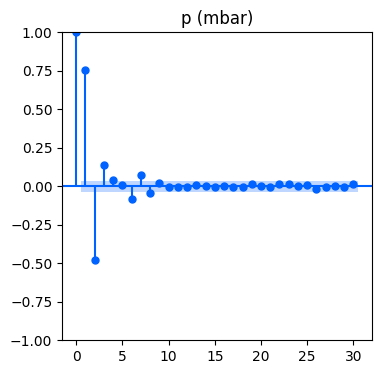

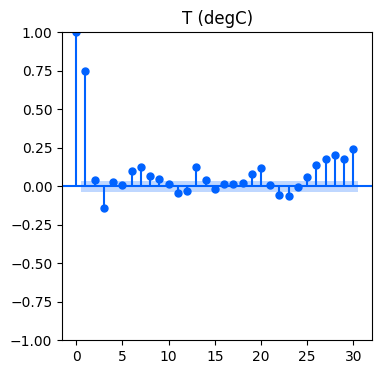

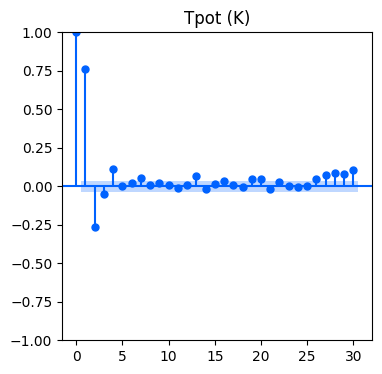

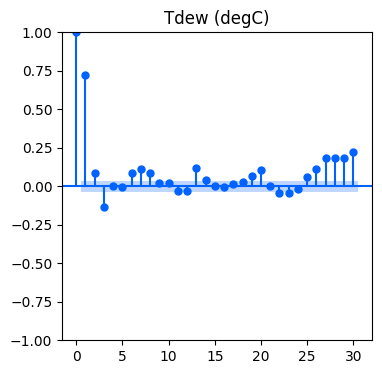

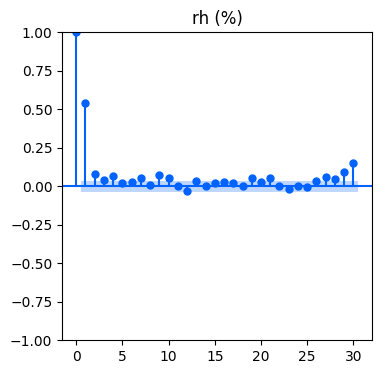

...

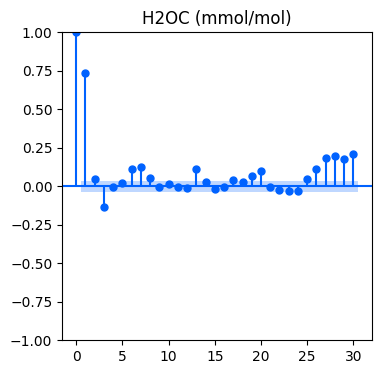

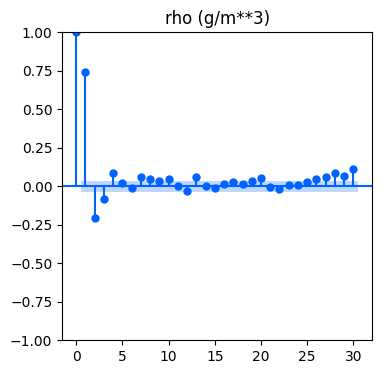

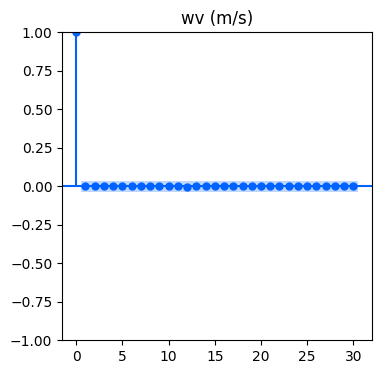

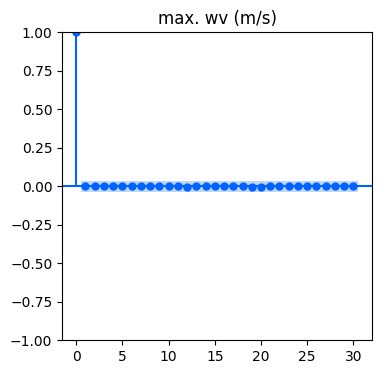

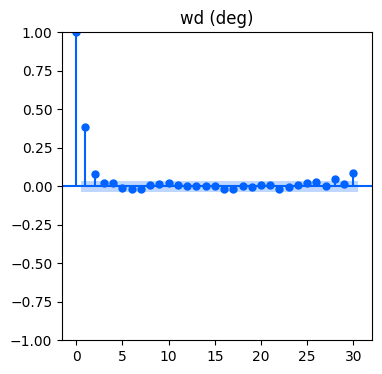

In [33]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, month_plot, quarter_plot
print('partial autocorelation polt')
for col in df_new.columns:
    plot_pacf(df_daily[col],lags=30,title=col)

weekly autocorelation polt


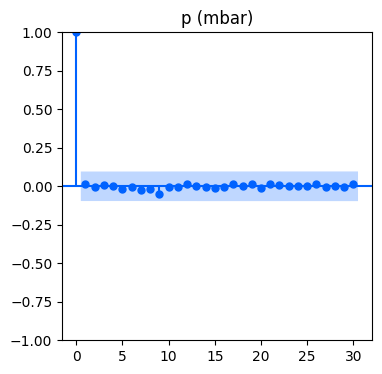

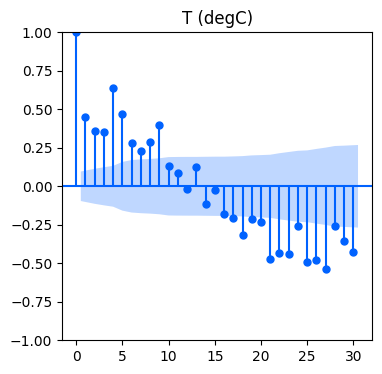

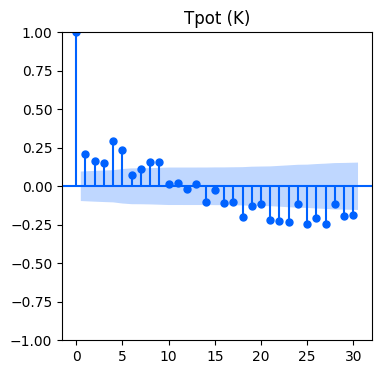

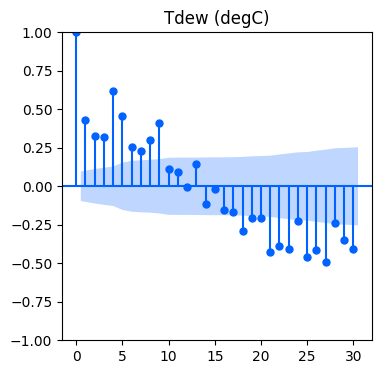

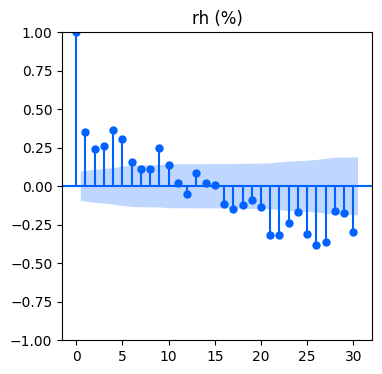

...

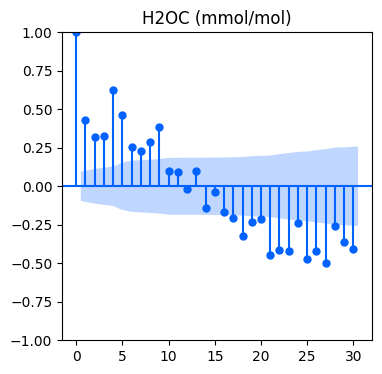

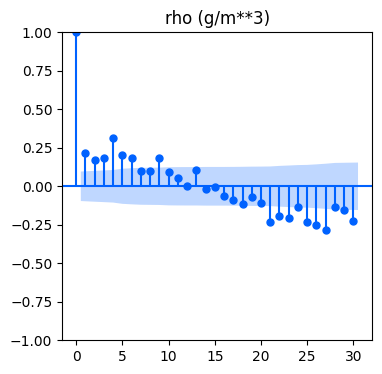

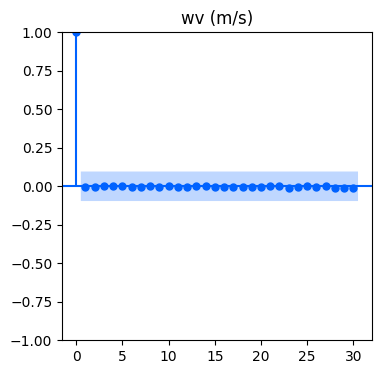

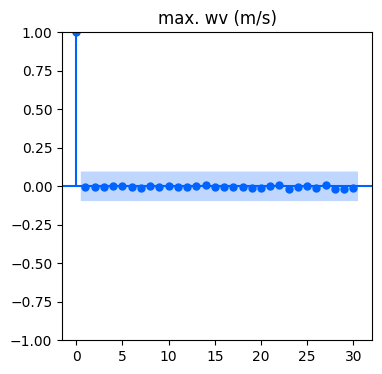

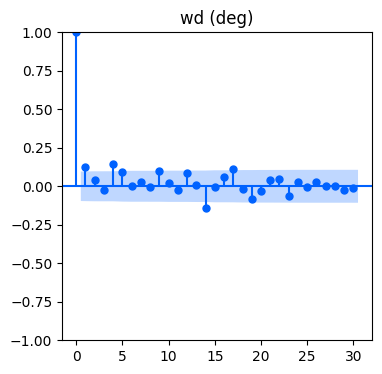

In [34]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, month_plot, quarter_plot
print('weekly autocorelation polt')
for col in df_new.columns:
    plot_acf(df_weekly[col],lags=30,title=col)

weekly partal autocorelation polt


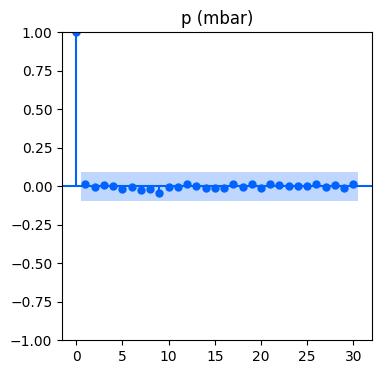

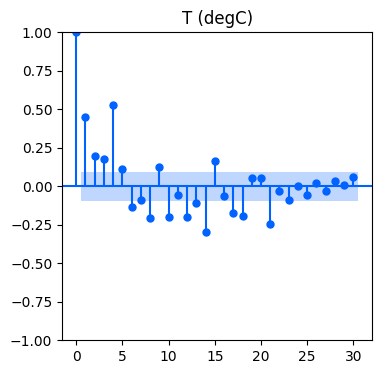

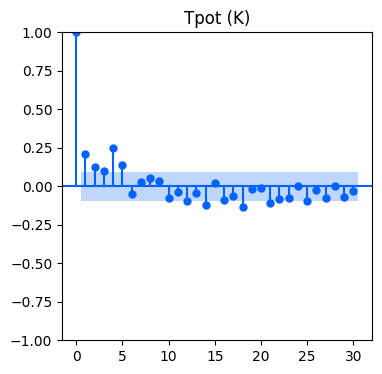

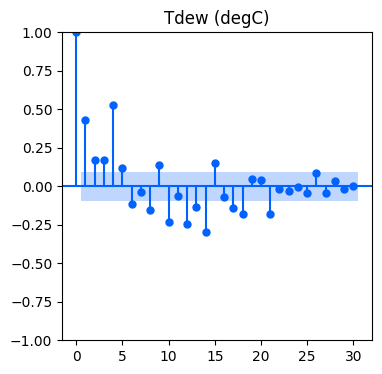

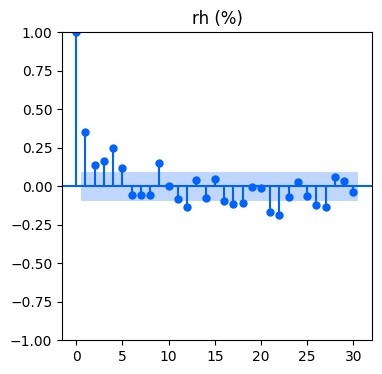

...

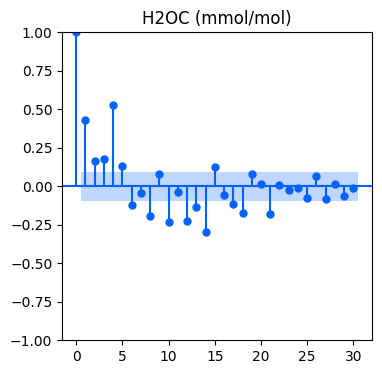

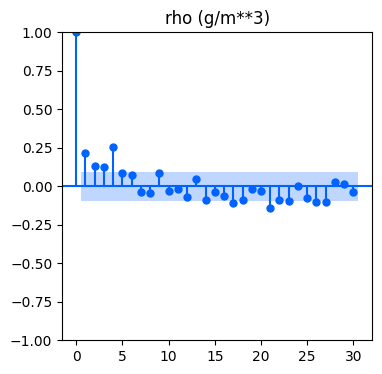

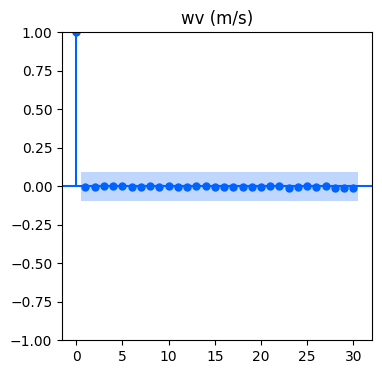

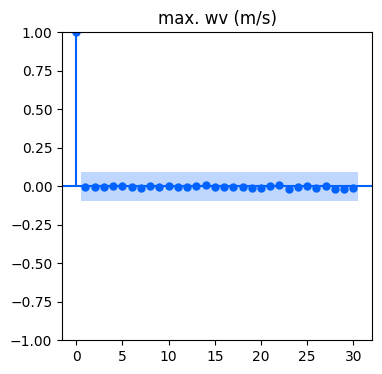

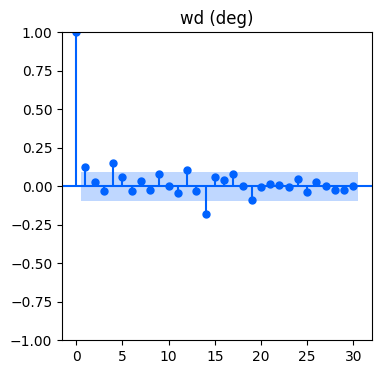

In [35]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, month_plot, quarter_plot
print('weekly partal autocorelation polt')
for col in df_new.columns:
    plot_pacf(df_weekly[col],lags=30,title=col)

### Monthly and Quarterly Seasonal Decomposition Plots

In this section, we generate seasonal decomposition plots for each climate data variable in the DataFrame `df_monthly` and `df_quarterly`.

#### Monthly Seasonal Decomposition Plots:
We iterate through each column in the DataFrame `df_monthly` using a for loop and generate seasonal decomposition plots using the `month_plot()` function from `statsmodels.graphics.tsaplots`. These plots provide insights into the seasonal patterns and trends present in the monthly climate data.

#### Quarterly Seasonal Decomposition Plots:
Similarly, we iterate through each column in the DataFrame `df_quarterly` and generate seasonal decomposition plots using the `quarter_plot()` function from `statsmodels.graphics.tsaplots`. These plots help us analyze the seasonal variations and trends present in the quarterly climate data.

Seasonal decomposition plots are valuable for identifying seasonal patterns, trends, and variations in the climate data, enabling us to better understand and model the underlying seasonal components.


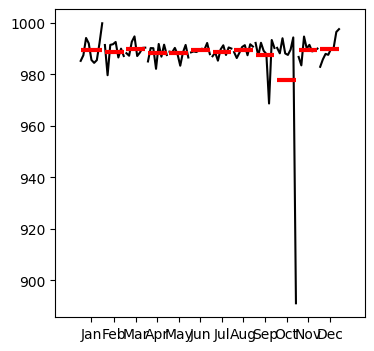

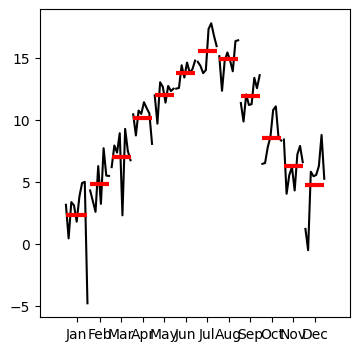

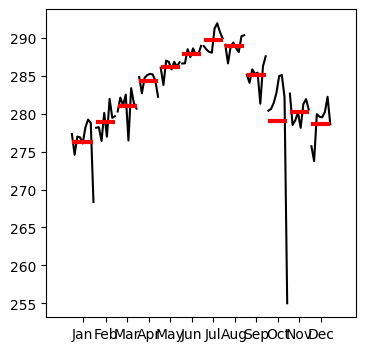

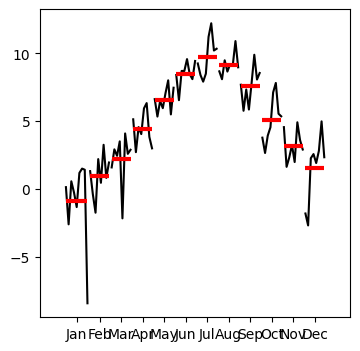

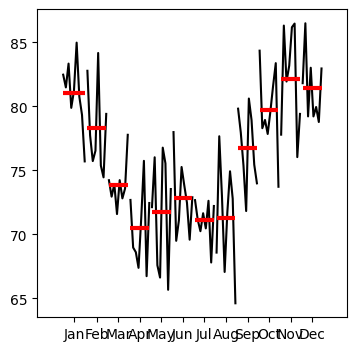

...

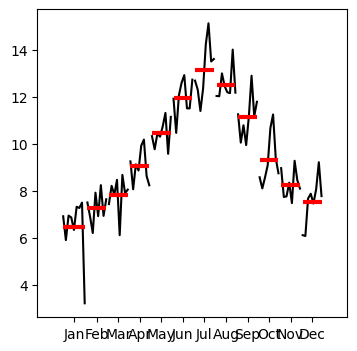

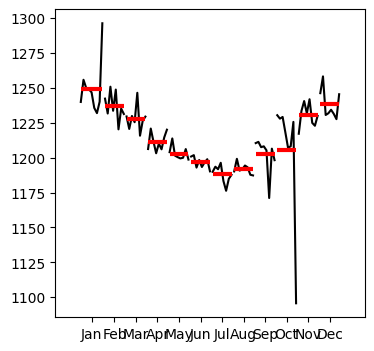

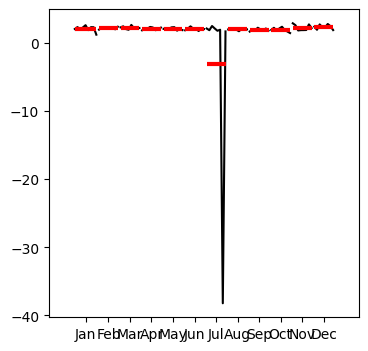

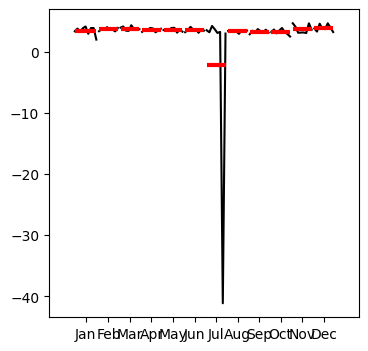

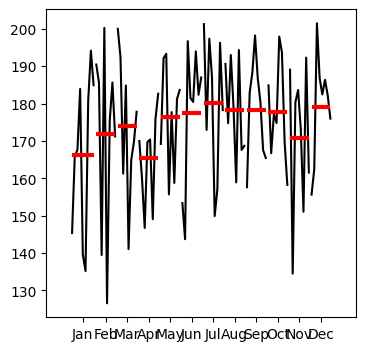

In [36]:
for col in df_new.columns:
   month_plot(df_monthly[col])

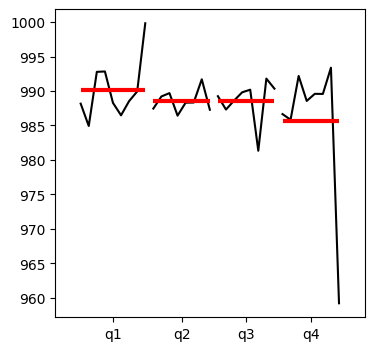

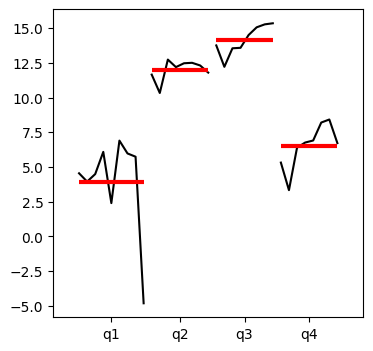

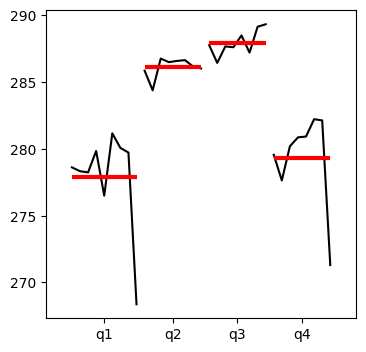

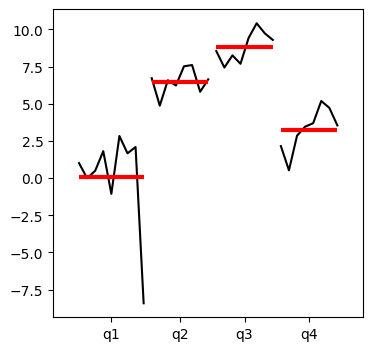

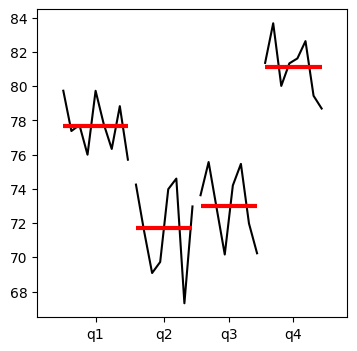

...

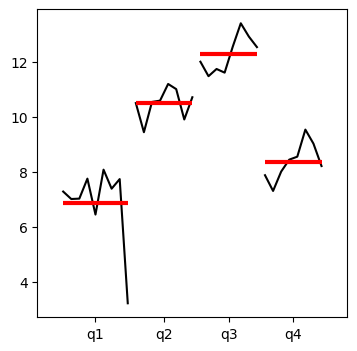

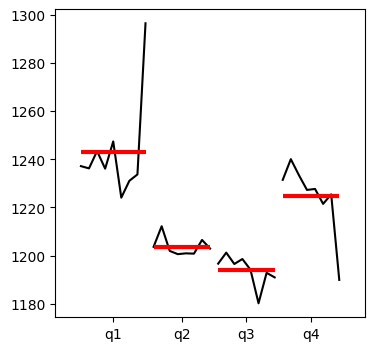

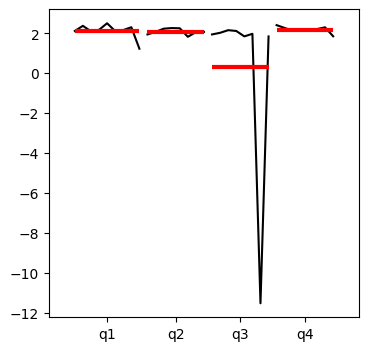

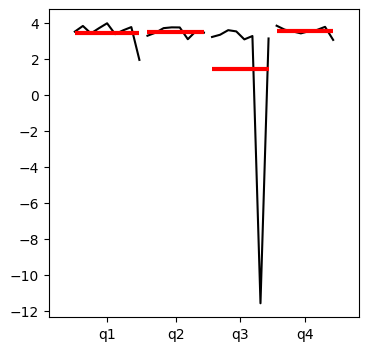

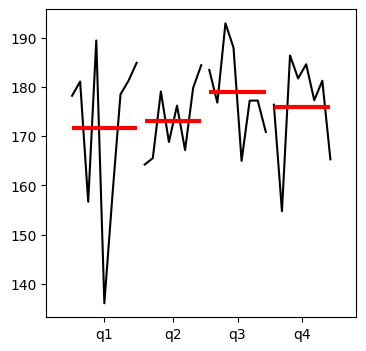

In [37]:
for col in df_new.columns:
   quarter_plot(df_quarterly[col])

In [38]:
df_daily.columns

Index(['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
       'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
       'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
       'wd (deg)'],
      dtype='object')

### Seasonal Decomposition Analysis

In this section, we perform seasonal decomposition analysis for each climate data variable in the DataFrame `df_weekly`.

We iterate through each column in the DataFrame `df_weekly` using a for loop. For each column, we use the `seasonal_decompose()` function from `statsmodels.tsa.seasonal` to decompose the time series into its constituent components: trend, seasonality, and residuals.

- **Trend Component:** The estimated trend component represents the long-term movement or direction of the time series.
- **Seasonality Component:** The estimated seasonality component captures the periodic fluctuations or seasonal patterns in the data.
- **Residual Component:** The estimated residual component represents the remaining variability in the data after removing the trend and seasonal components.

We then visualize the original time series along with its decomposed components using subplots. Each subplot displays one of the components (original, trend, seasonality, residuals) of the time series, providing insights into the underlying patterns and variations.

This analysis helps us understand the individual contributions of trend, seasonality, and randomness to the overall behavior of each climate variable, facilitating better forecasting and modeling of the data.


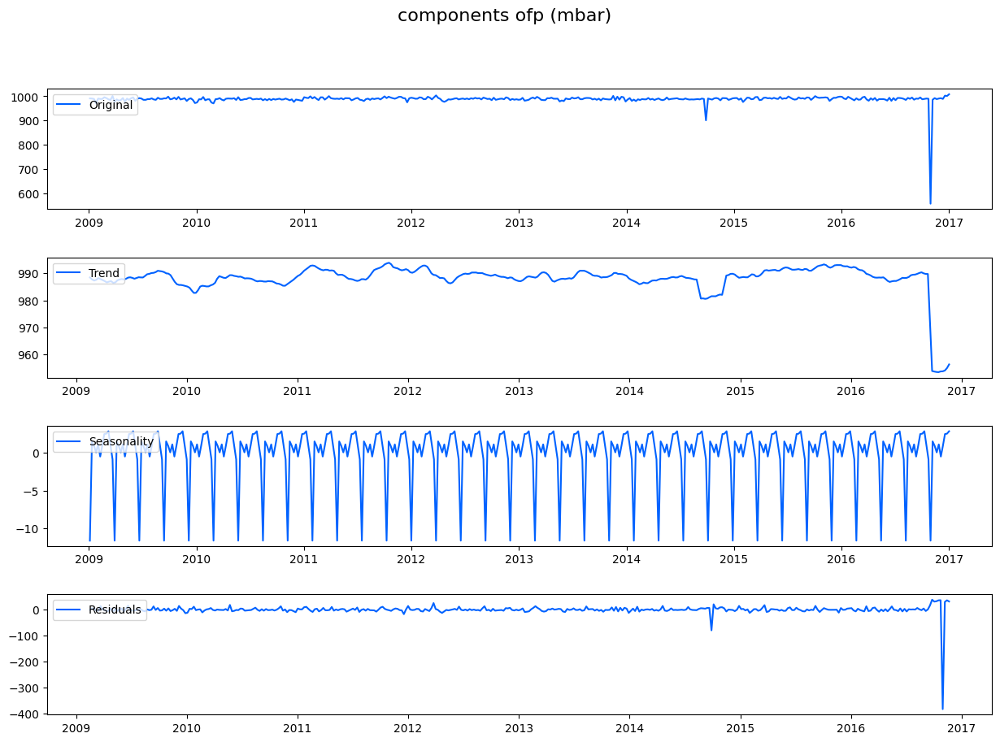

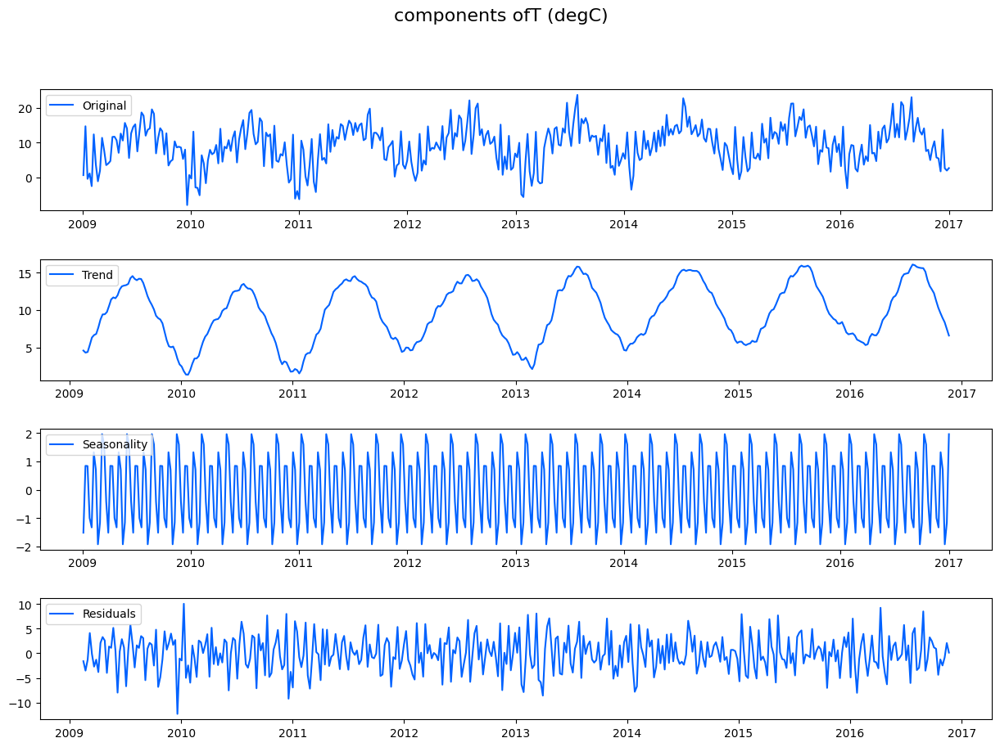

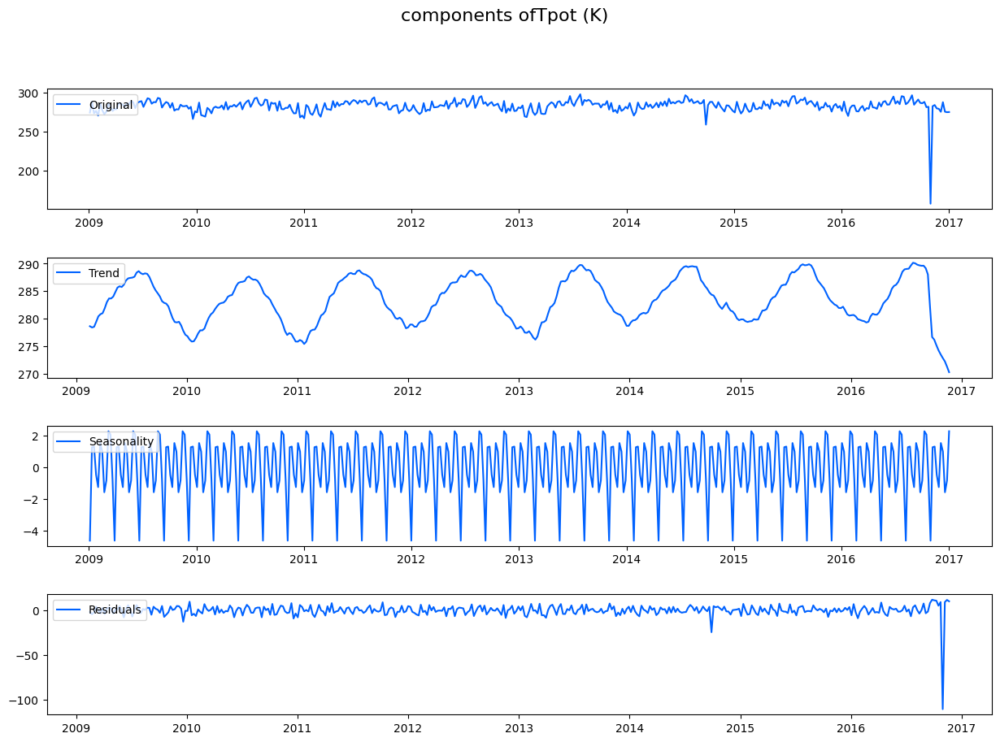

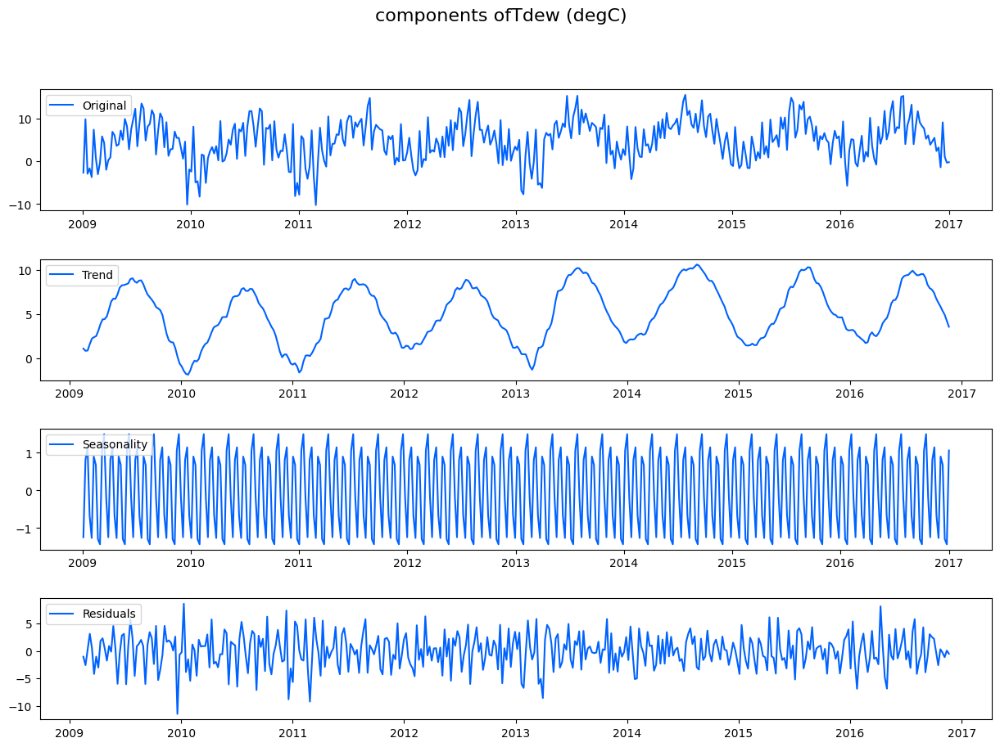

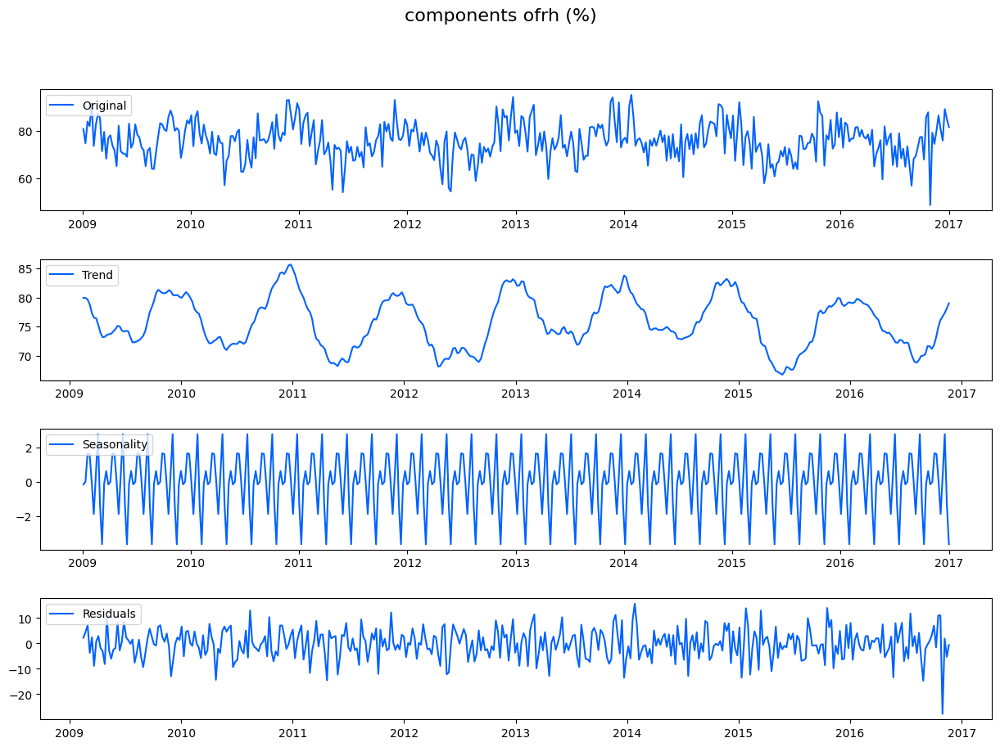

...

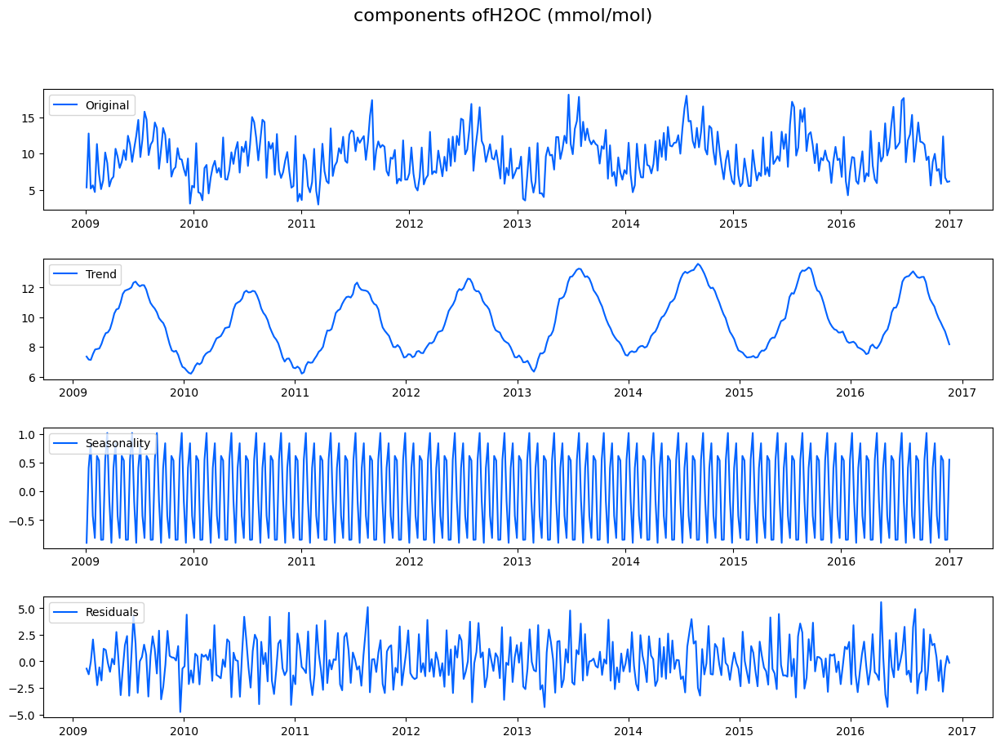

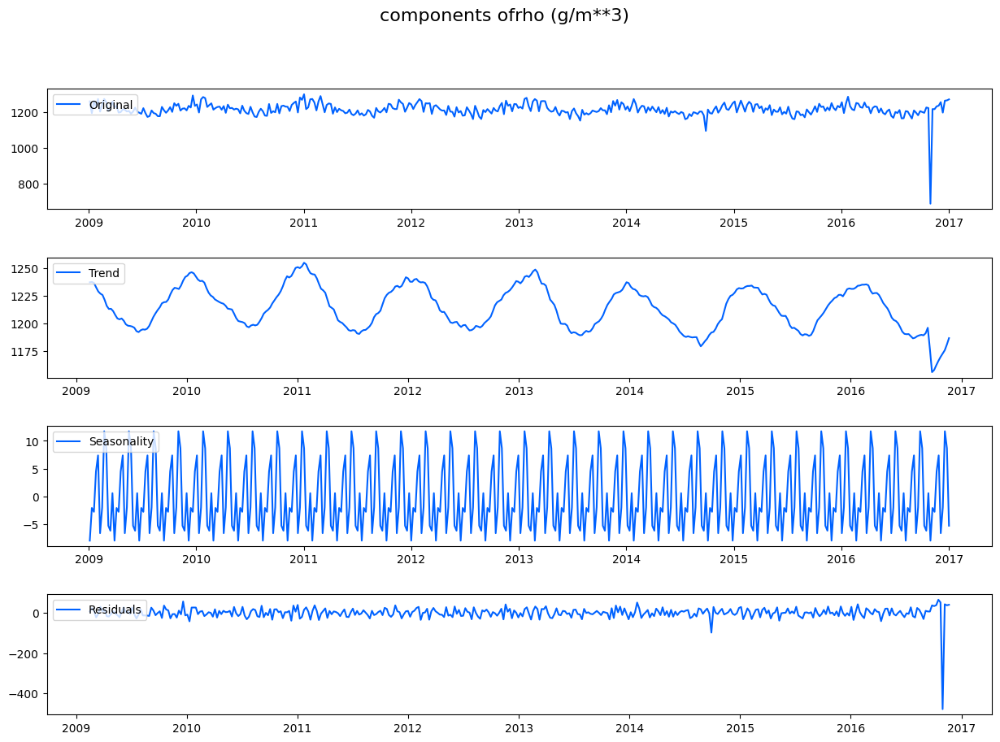

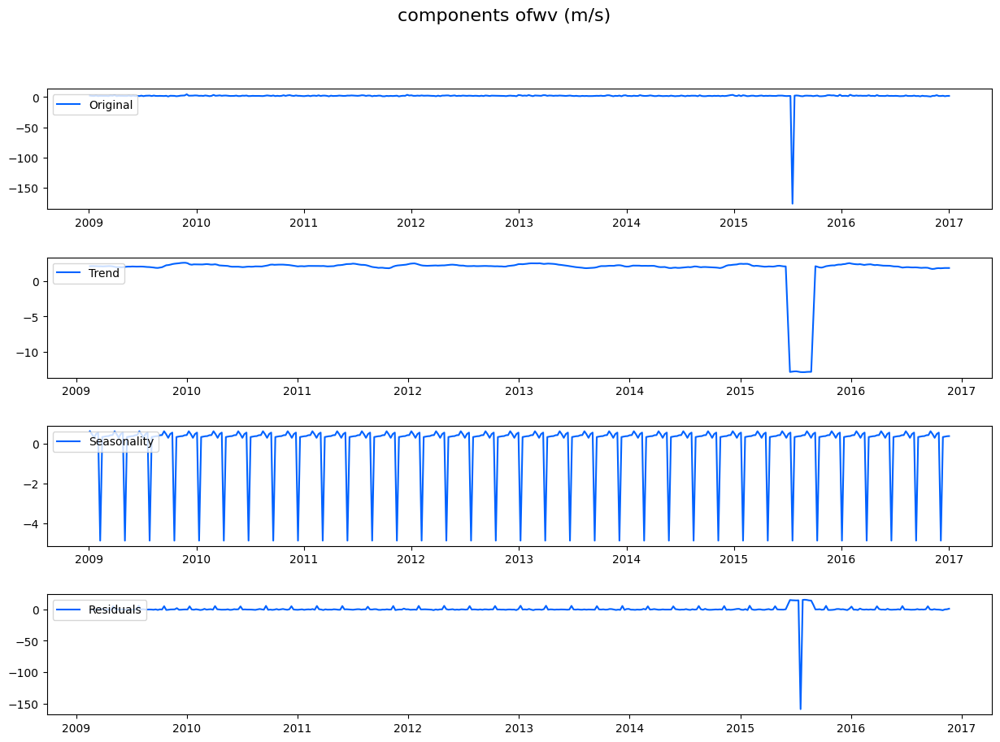

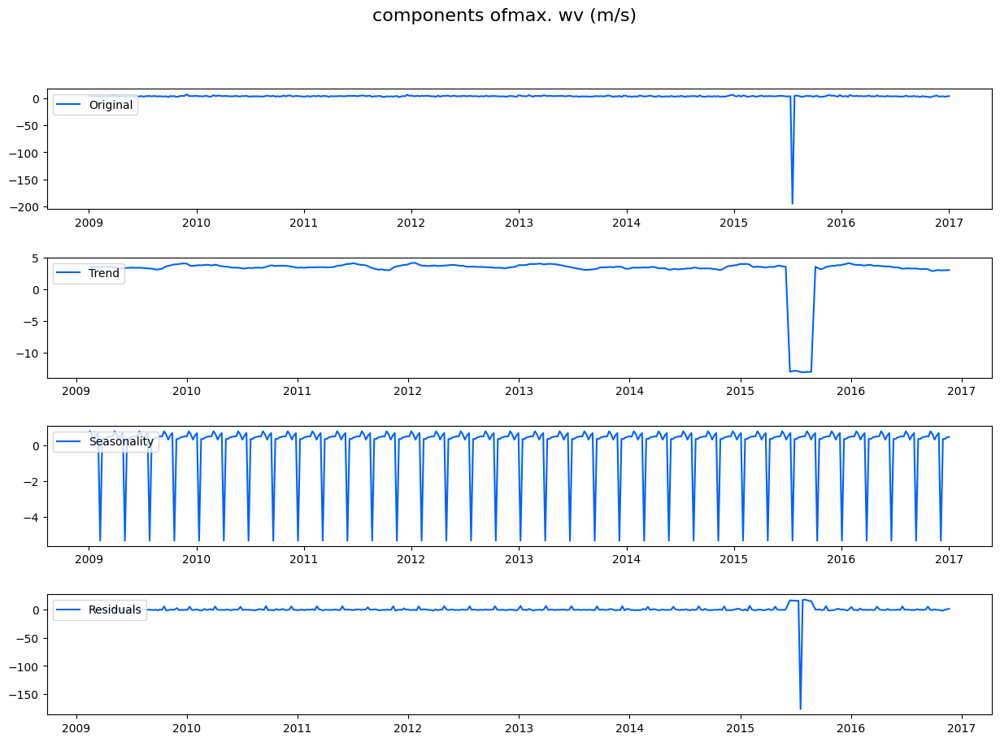

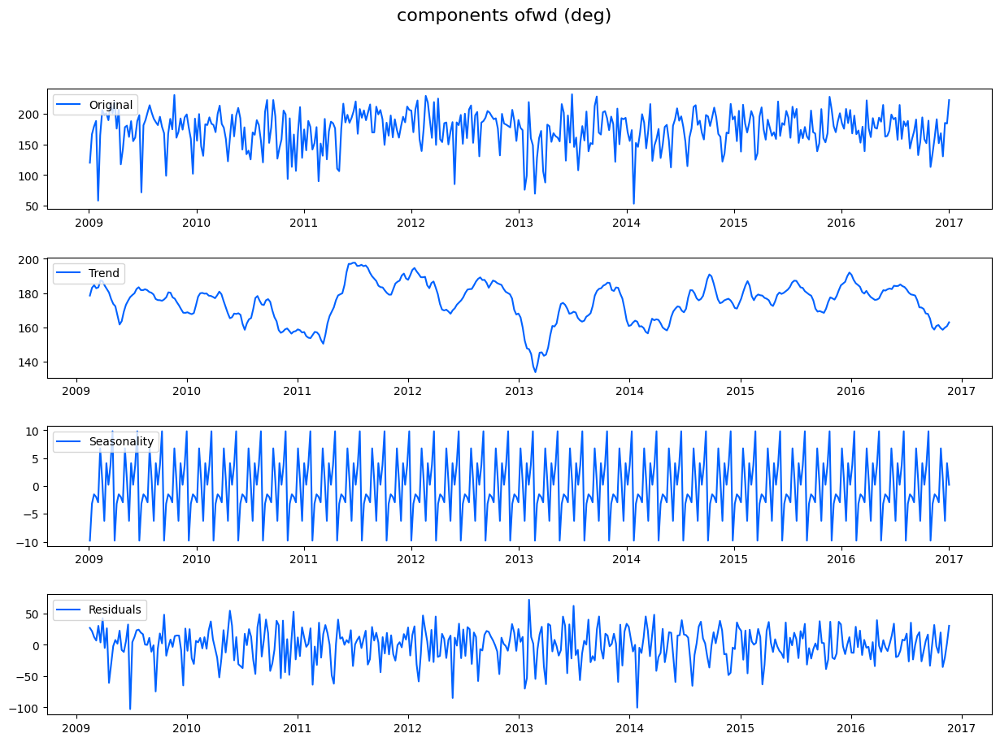

In [39]:
from statsmodels.tsa.seasonal import seasonal_decompose
for col in df_new:
    ss_decomposition = seasonal_decompose(x=df_weekly[col], model='additive', period=12)
    estimated_seasonal = ss_decomposition.seasonal
    estimated_residual = ss_decomposition.resid
    estimated_trend = ss_decomposition.trend
    
    
    fig, axes = plt.subplots(4, 1, sharex=False, sharey=False)
    fig.set_figheight(10)
    fig.set_figwidth(15)
    fig.suptitle('components of'+col, fontsize=16)

    axes[0].plot(df_weekly[col], label='Original')
    axes[0].legend(loc='upper left');

    axes[1].plot(estimated_trend, label='Trend')
    axes[1].legend(loc='upper left');

    axes[2].plot(estimated_seasonal, label='Seasonality')
    axes[2].legend(loc='upper left');

    axes[3].plot(estimated_residual, label='Residuals')
    axes[3].legend(loc='upper left');### Rolling Window Analysis



In this section, we perform rolling window analysis to compute the mean and standard deviation of the 1-hour, 1-week, and 1-month rolling averages for each climate data variable in the DataFrames `df_daily` and `df_weekly`.

#### 1-Hour Rolling Average:
- We iterate through each column in the DataFrame `df_new` using a for loop and calculate the mean and standard deviation of the 1-hour rolling average using the rolling window method (`rolling_window.mean()` and `rolling_window.std()`). We set the window size to 1 hour.

#### 1-Week Rolling Average:
- We repeat the process for the DataFrame `df_daily`, where we calculate the mean and standard deviation of the 1-week rolling average using the rolling window method with a window size of 7 days (`rolling_window_days.mean()` and `rolling_window_days.std()`).

#### 1-Month Rolling Average:
- Similarly, we perform rolling window analysis on the DataFrame `df_weekly` to compute the mean and standard deviation of the 1-month rolling average using the rolling window method with a window size of 4 weeks (`rolling_window_week.mean()` and `rolling_window_week.std()`).

For each analysis, we plot the mean and standard deviation of the rolling averages for each climate data variable, providing insights into the variability and trends over different time intervals.

These analyses help identify trends, patterns, and variations in the climate data, facilitating a deeper understanding of the underlying dynamics and informing further analysis and decision-making.



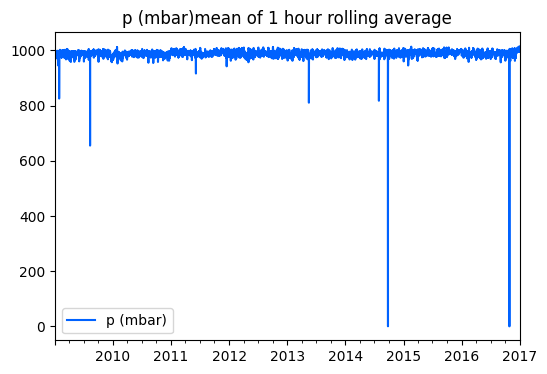

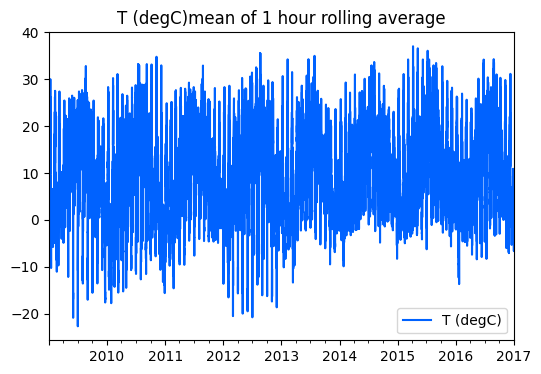

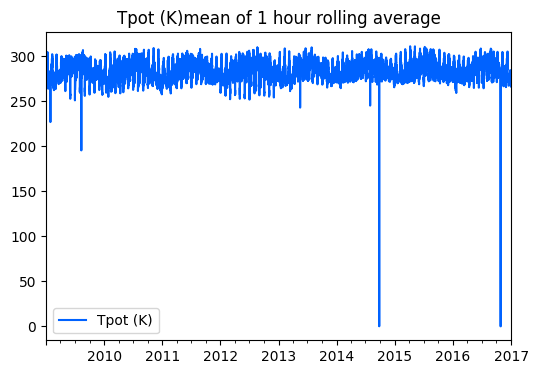

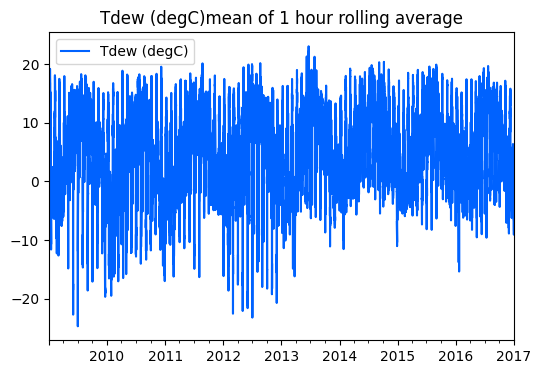

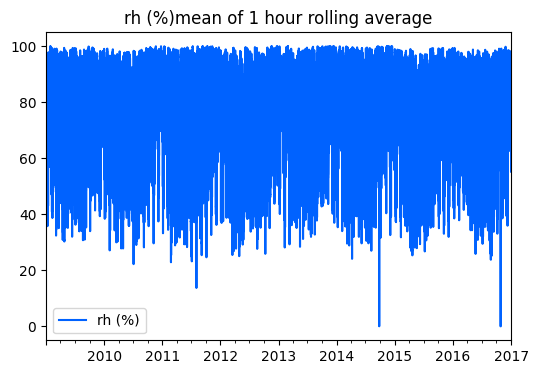

...

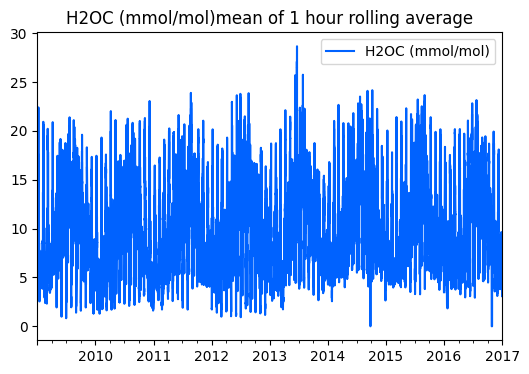

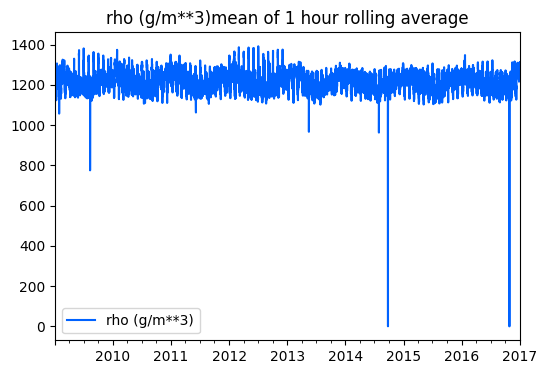

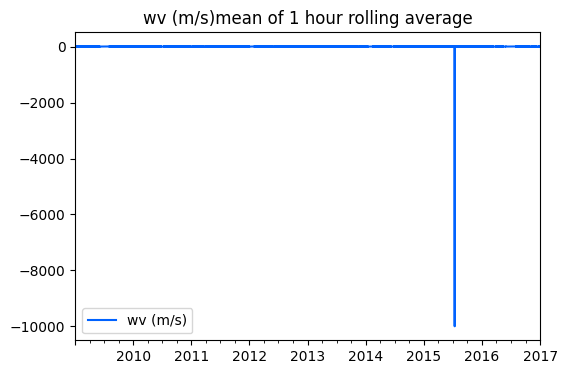

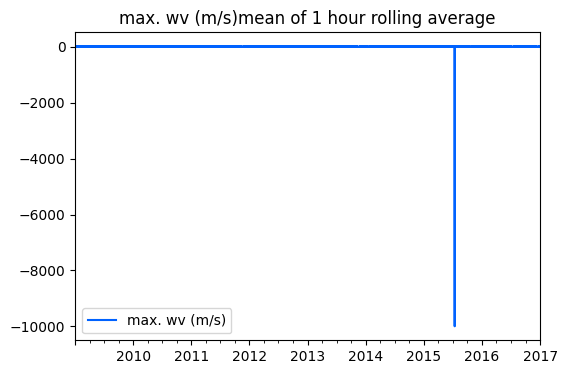

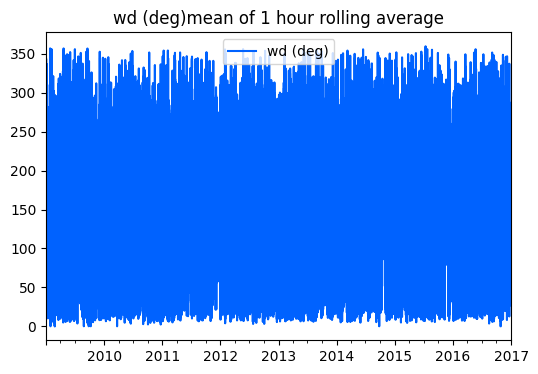

In [40]:

for col in df_new.columns:
    rolling_window.mean().plot(y=col,figsize=plotsize,title=col+'mean of 1 hour rolling average')

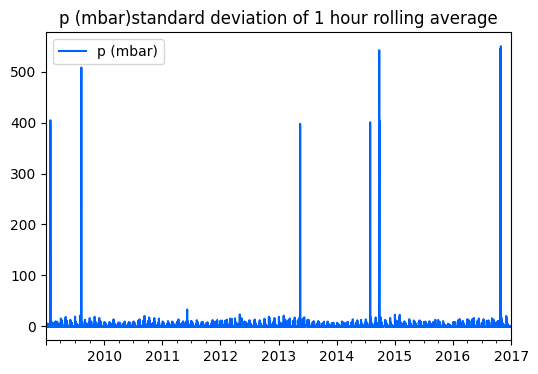

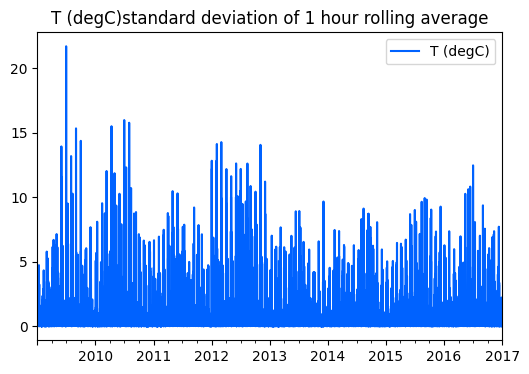

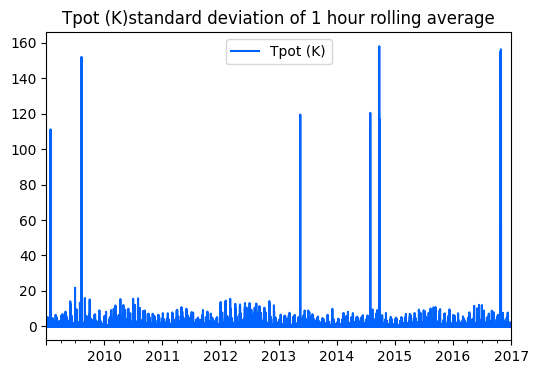

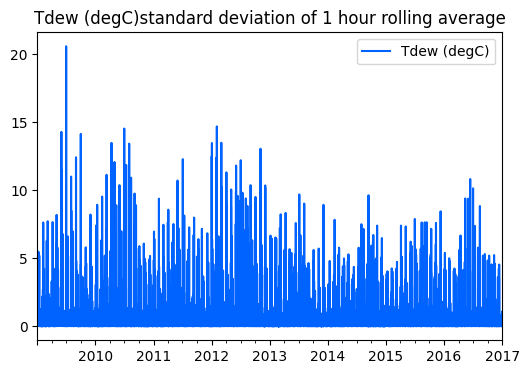

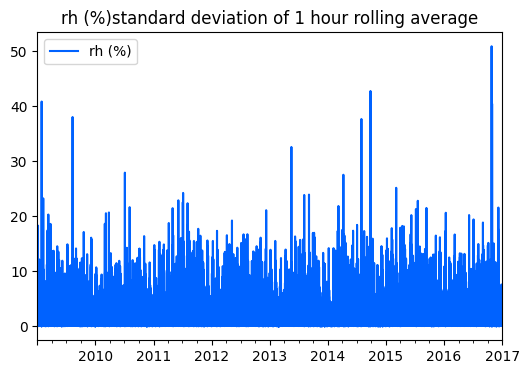

...

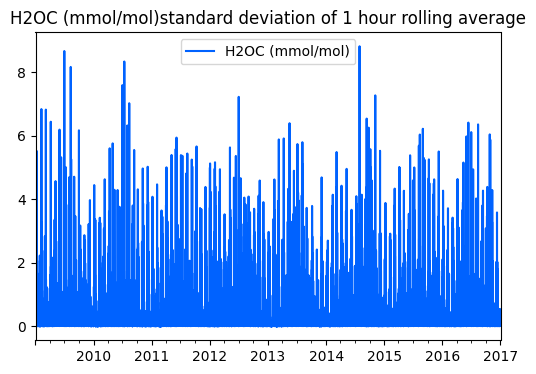

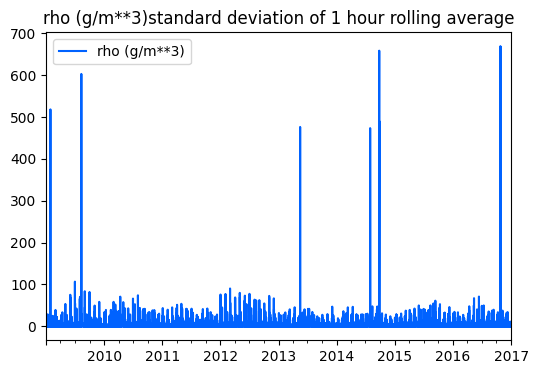

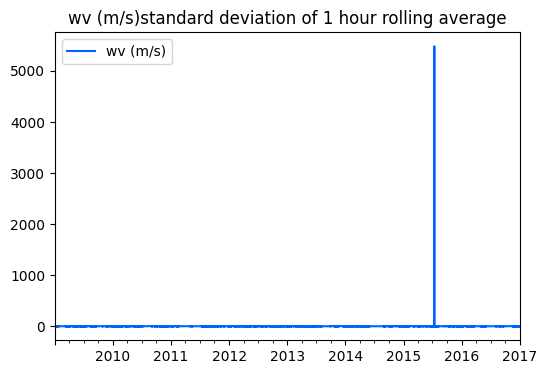

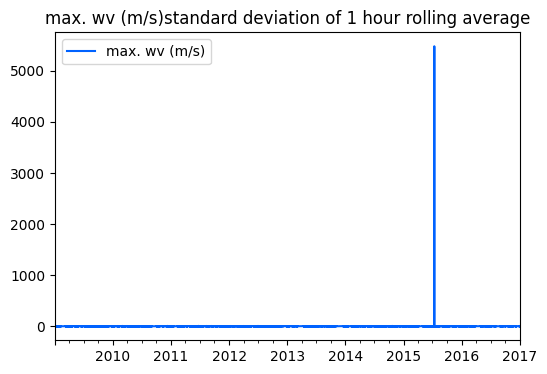

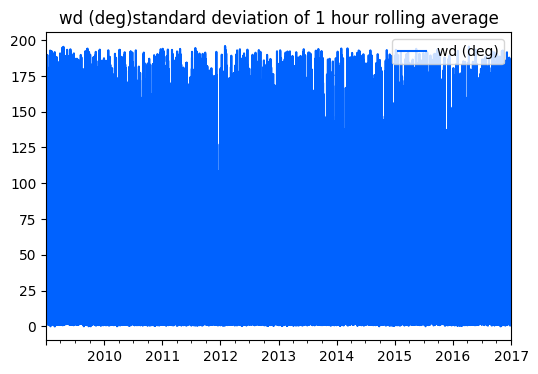

In [41]:

for col in df_new.columns:
    rolling_window.std().plot(y=col,figsize=plotsize,title=col+'standard deviation of 1 hour rolling average')

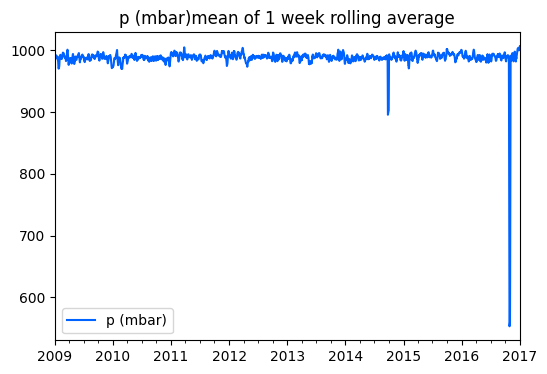

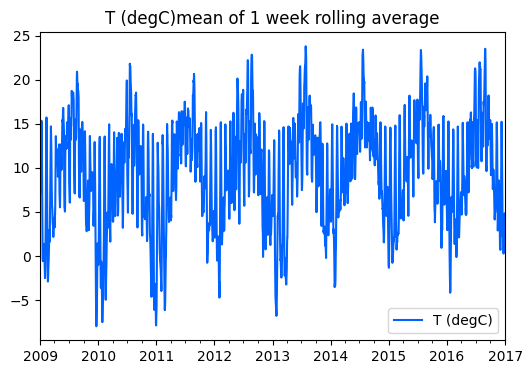

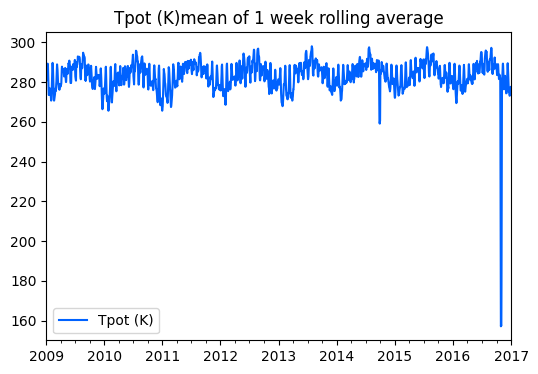

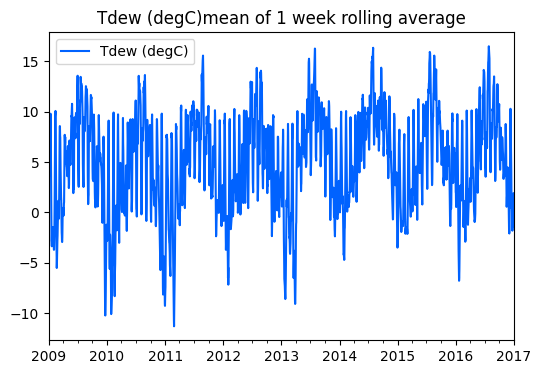

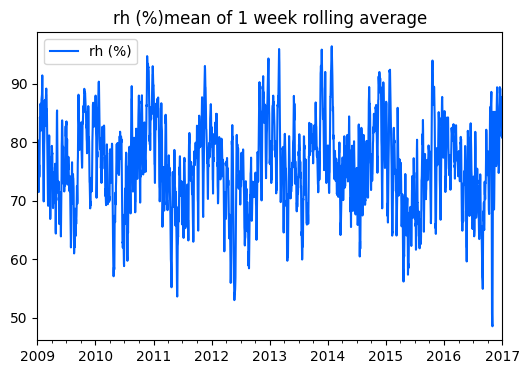

...

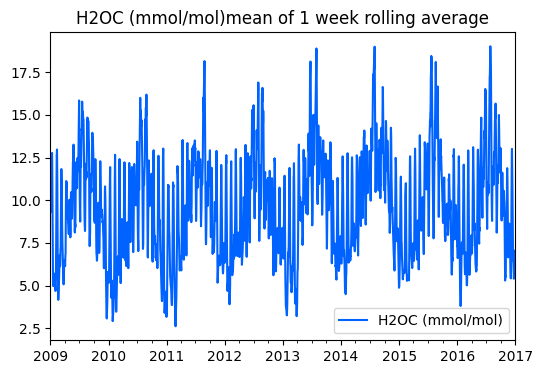

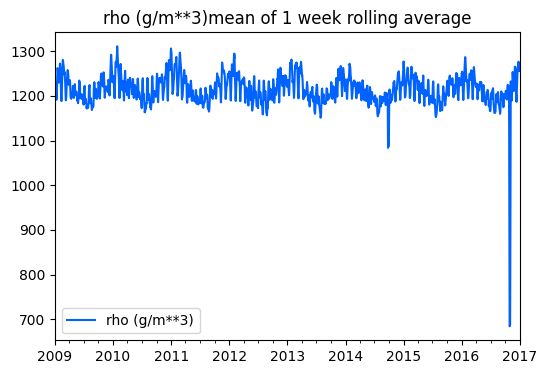

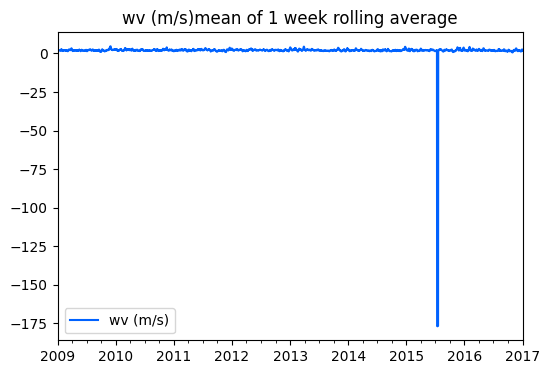

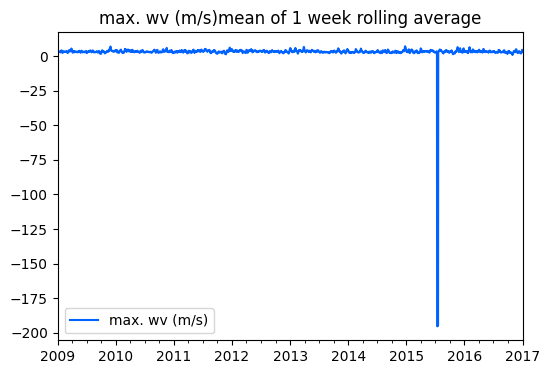

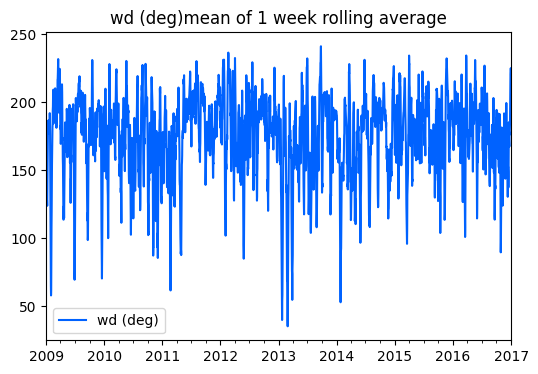

In [42]:
win_size=7
rolling_window_days=df_daily.rolling(win_size)
for col in df_new.columns:
    rolling_window_days.mean().plot(y=col,figsize=plotsize,title=col+'mean of 1 week rolling average')

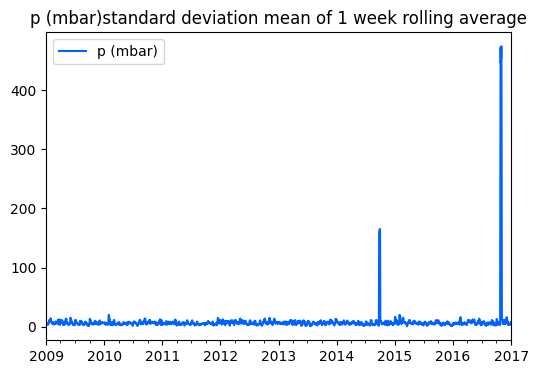

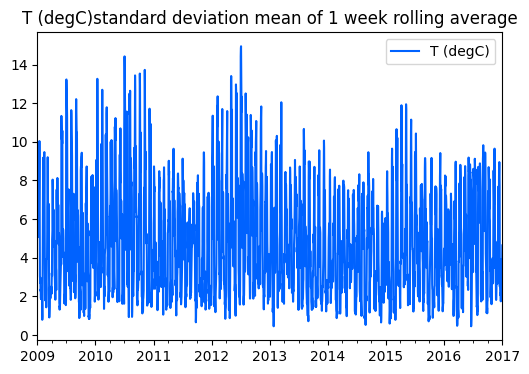

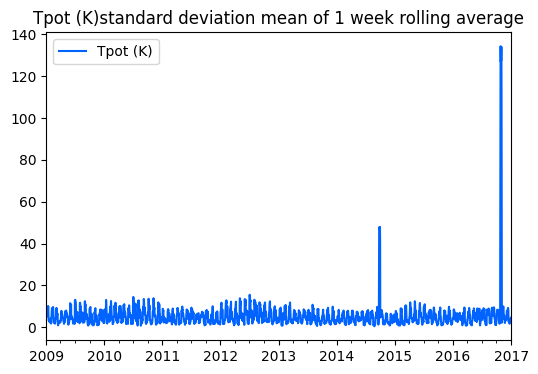

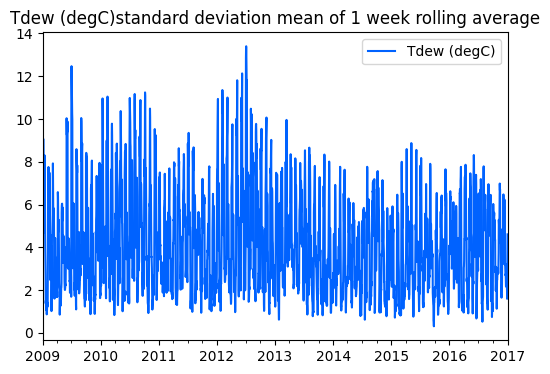

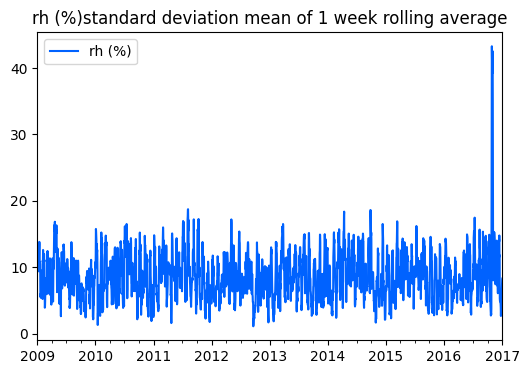

...

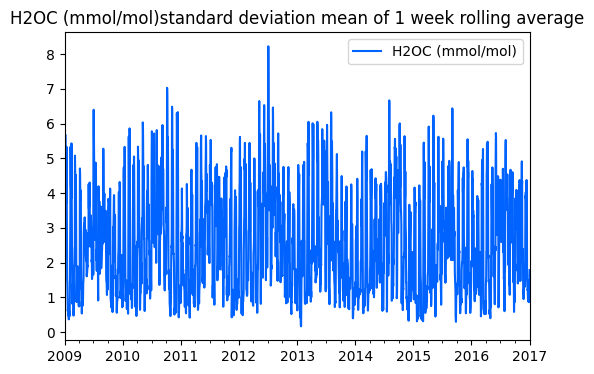

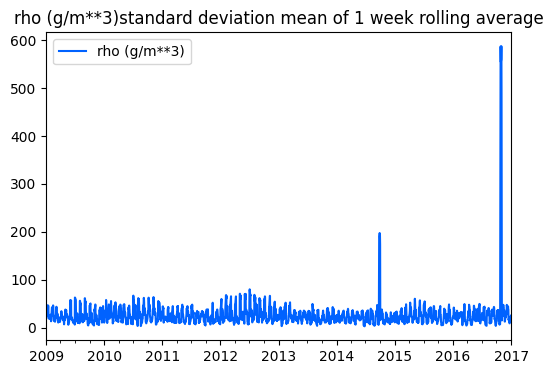

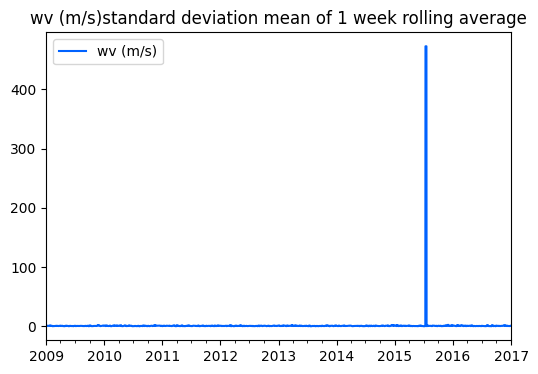

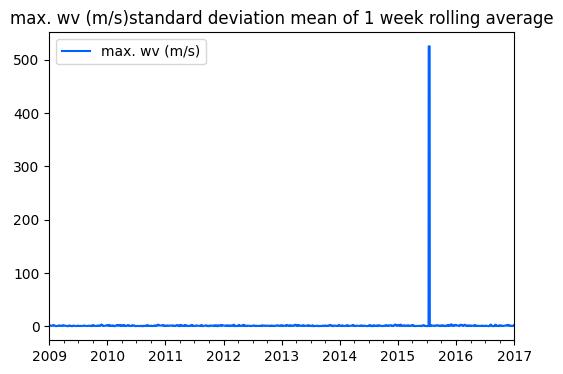

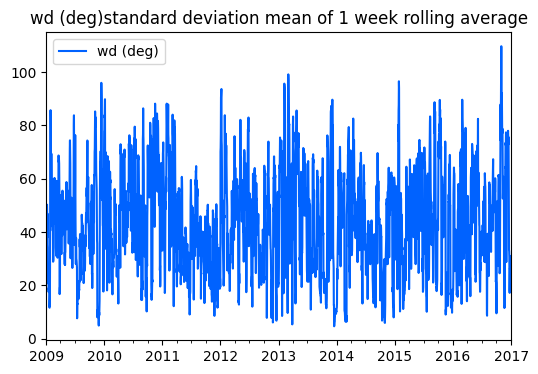

In [43]:
win_size=7
rolling_window_days=df_daily.rolling(win_size)
for col in df_new.columns:
    rolling_window_days.std().plot(y=col,figsize=plotsize,title=col+'standard deviation mean of 1 week rolling average')

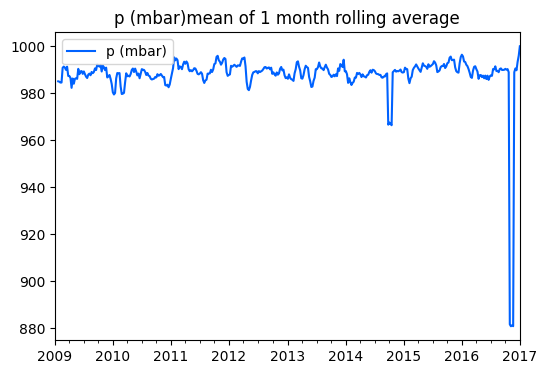

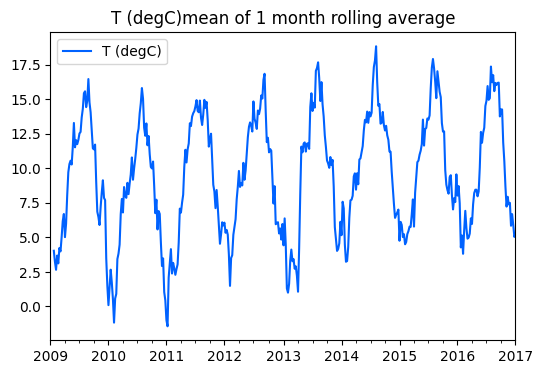

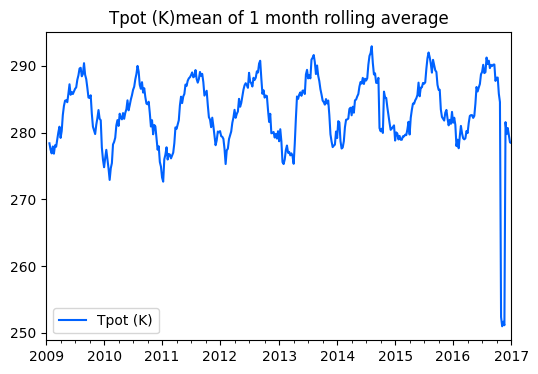

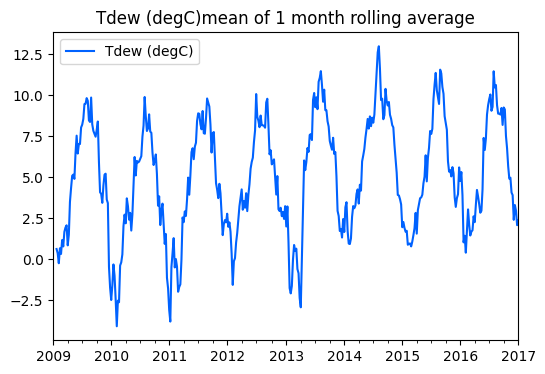

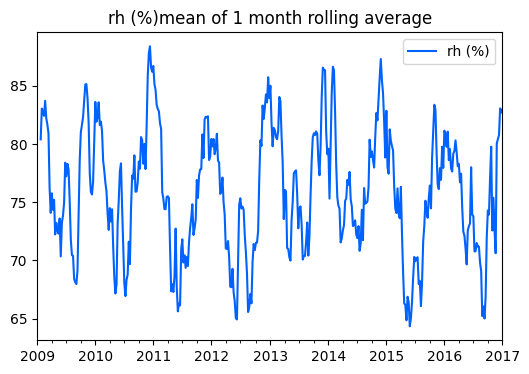

...

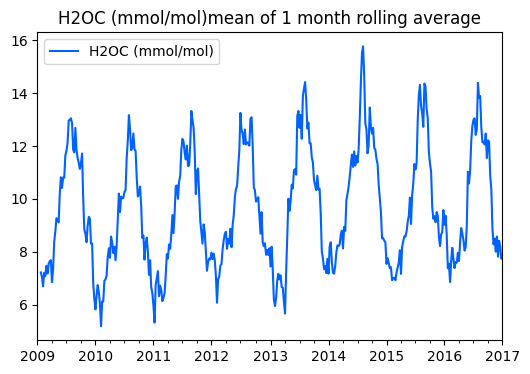

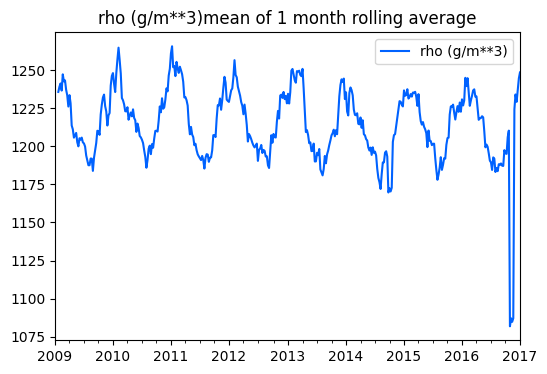

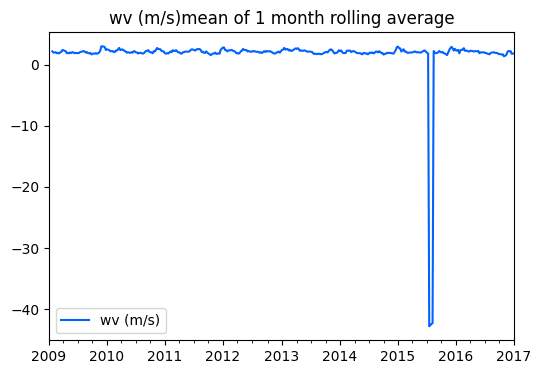

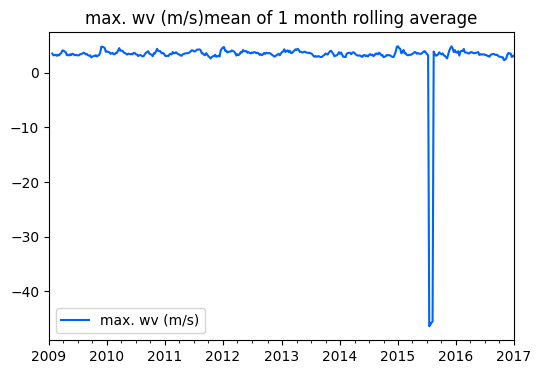

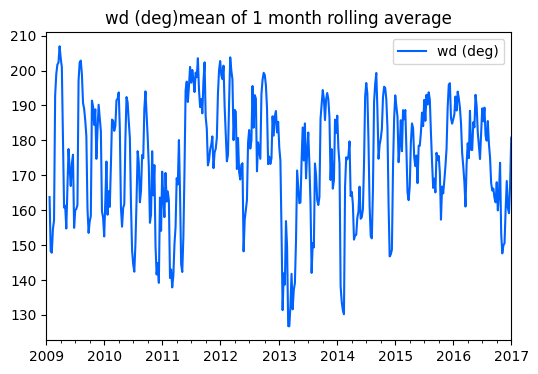

In [44]:
win_size=4
rolling_window_week=df_weekly.rolling(win_size)
for col in df_new.columns:
    rolling_window_week.mean().plot(y=col,figsize=plotsize,title=col+'mean of 1 month rolling average')

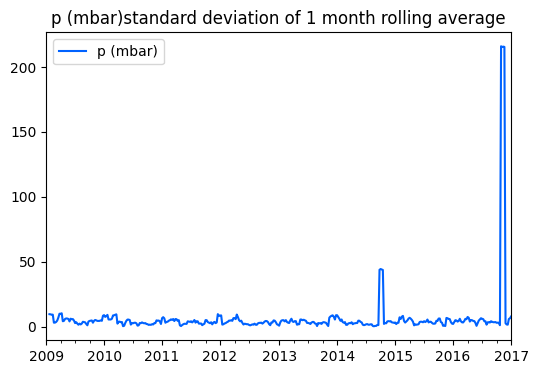

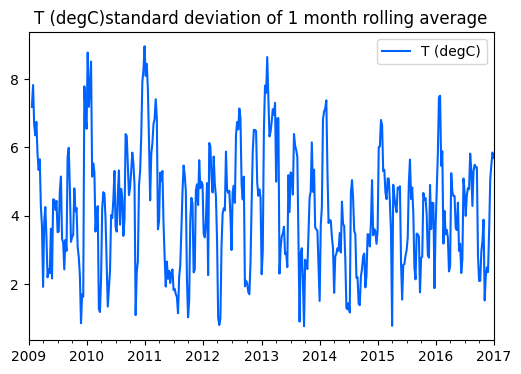

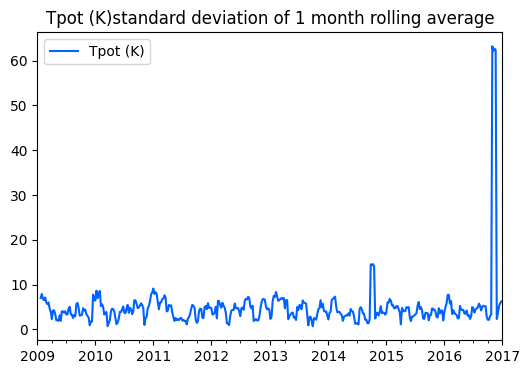

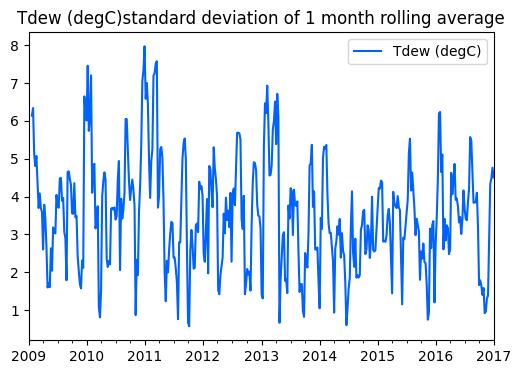

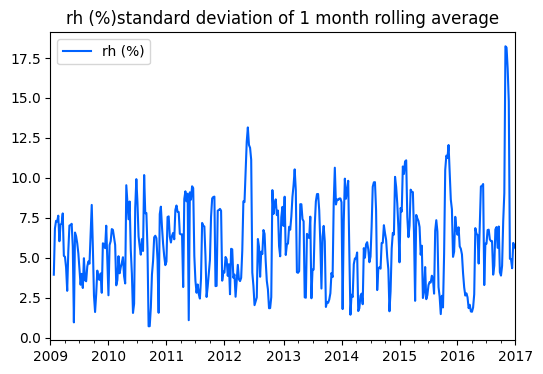

...

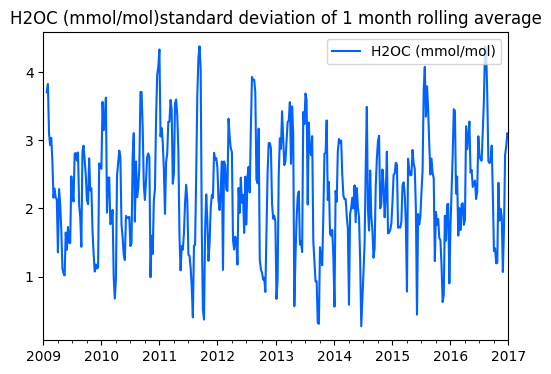

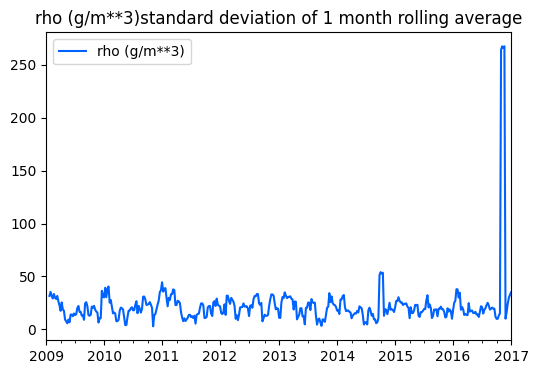

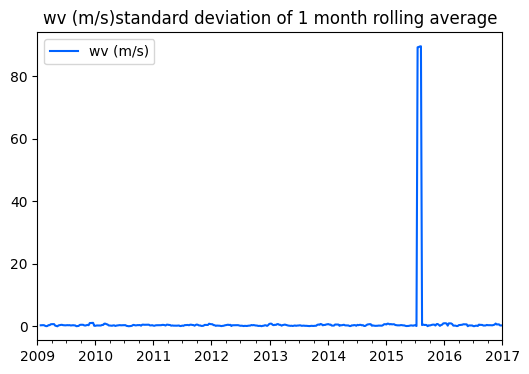

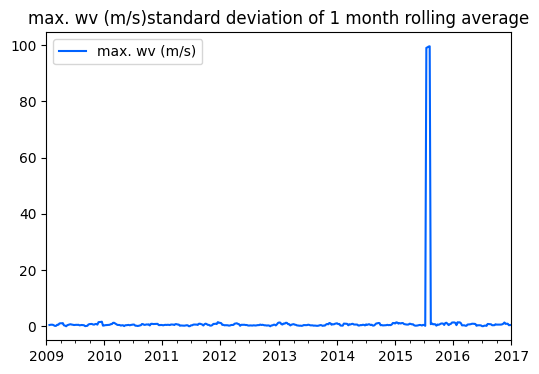

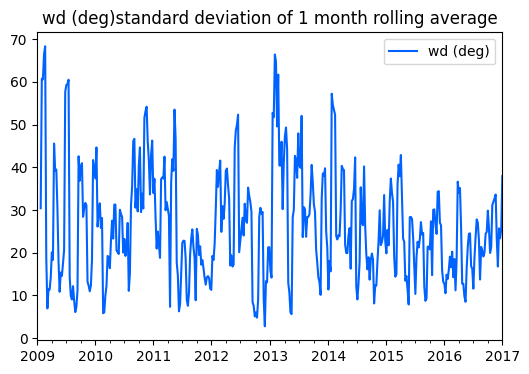

In [45]:
win_size=4
rolling_window_week=df_weekly.rolling(win_size)
for col in df_new.columns:
    rolling_window_week.std().plot(y=col,figsize=plotsize,title=col+'standard deviation of 1 month rolling average')

**Stationary Analysis:**

Before proceeding with further analysis, it's crucial to assess the stationarity of the climate data. Stationarity is a fundamental assumption in time series analysis, indicating that the statistical properties of the data, such as mean, variance, and autocorrelation, remain constant over time. Non-stationary data may exhibit trends, seasonality, or other patterns that can confound analysis and forecasting efforts.

To evaluate stationarity, we conduct several tests and analyses:

1.  **Histogram Analysis:** We generate histograms for each climate data variable to visualize the distribution of values. This allows us to inspect the frequency distribution and central tendency of the data, providing insights into its stationarity.

2.  **Augmented Dickey-Fuller (ADF) Test:** The ADF test examines whether a time series has a unit root, which indicates non-stationarity. We calculate the ADF statistic and p-value for each climate variable, along with other diagnostic information like the number of lags used and critical values.

3. **Moving Average Smoothing:** Another approach to assess stationarity involves applying moving average smoothing to the data. By smoothing out short-term fluctuations, we can better identify underlying trends or patterns that may suggest non-stationarity.

These stationarity analyses provide valuable insights into the nature of the climate data, helping us understand its behavior and inform subsequent analysis steps.


### Histogram Analysis

In this section, we generate histograms for each climate data variable in the DataFrame `df_weekly`.

We iterate through each column in the DataFrame `df_new` using a for loop. For each column, we create a new figure and subplot using `plt.subplots()`. We set the title of the figure to the name of the column (`col`) and set the font size to 16.

Next, we plot the histogram of the weekly data for the current variable using the `.hist()` method on the DataFrame `df_weekly[col]`. This histogram provides a visual representation of the distribution of values for the climate data variable over weekly intervals.

Histogram analysis helps us understand the frequency distribution and central tendency of the climate data, aiding in identifying any skewness, outliers, or patterns in the distribution.


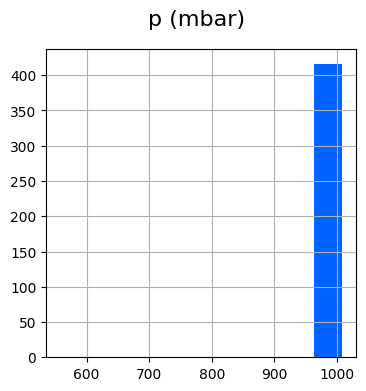

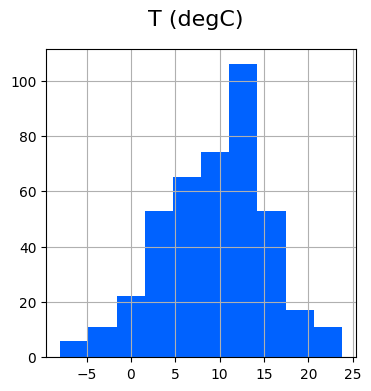

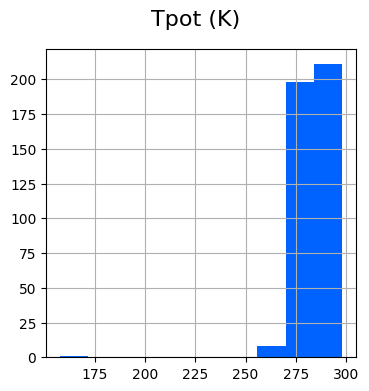

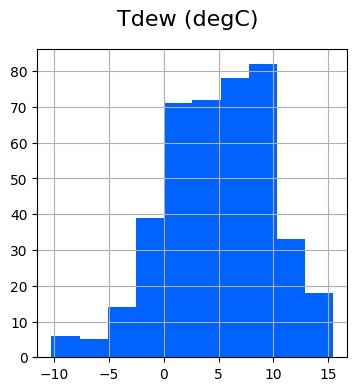

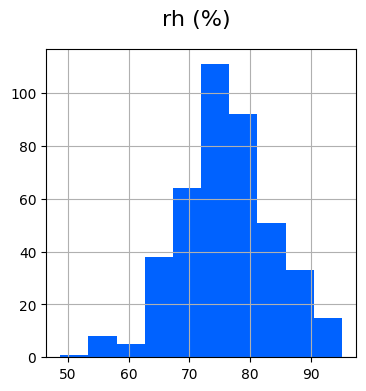

...

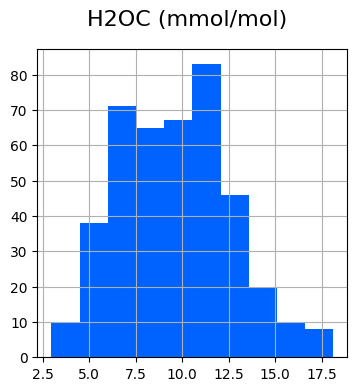

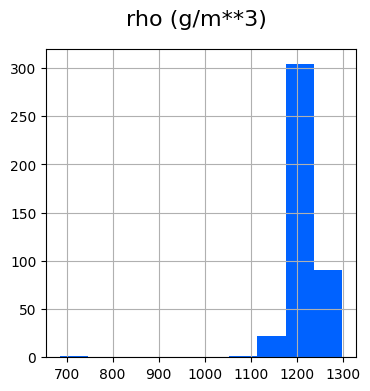

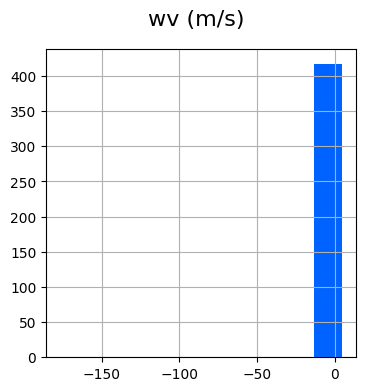

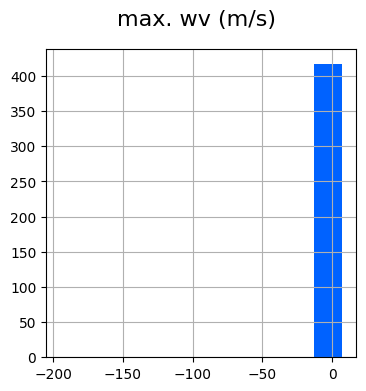

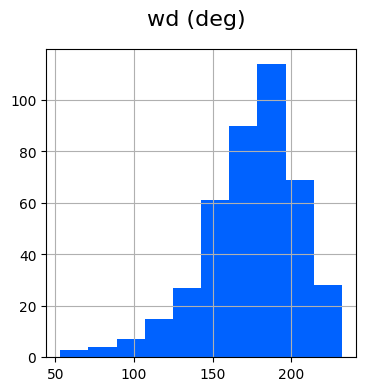

In [46]:
for col in df_new.columns:
    fig, axes = plt.subplots(1, 1, sharex=False, sharey=False)
    fig.suptitle(col, fontsize=16)
    fig
    df_weekly[col].hist()

### Augmented Dickey-Fuller Test

In this section, we perform the Augmented Dickey-Fuller (ADF) test for stationarity on each climate data variable in the DataFrame `df_daily`.

We iterate through each column in the DataFrame `df_new` using a for loop. For each column, we apply the ADF test using the `adfuller()` function from `statsmodels.tsa.stattools`. This test is used to determine whether a time series is stationary or not by examining the unit root hypothesis.

We store the results of the ADF test, including the ADF statistic, p-value, number of lags used, number of observations, critical values, and the maximized information criterion, in a DataFrame named `adf_test_df`.

The ADF test results help us assess the stationarity of each climate data variable, which is essential for many time series analysis techniques and forecasting models.


In [47]:
from statsmodels.tsa.stattools import adfuller
adf_test_df=pd.DataFrame(columns=('column','adf', 'pvalue', 'usedlag', 'nobs', 'critical_values', 'icbest' ))
for col in df_new.columns:
    adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df_daily[col])
    
    adf_test_df.loc[len(adf_test_df.index)] = [col,adf, pvalue, usedlag, nobs, critical_values, icbest]


In [48]:
adf_test_df=pd.concat([adf_test_df.drop(['critical_values'], axis=1), adf_test_df['critical_values'].apply(pd.Series)], axis=1)

In [49]:
adf_test_df

,column,adf,pvalue,usedlag,nobs,icbest,1%,5%,10%
0,p (mbar),-17.0,0.0,7,2915,"24,941.8",-3.4,-2.9,-2.6
1,T (degC),-3.2,0.0,28,2894,"17,089.7",-3.4,-2.9,-2.6
2,Tpot (K),-5.9,0.0,28,2894,"19,683.1",-3.4,-2.9,-2.6
3,Tdew (degC),-3.4,0.0,28,2894,"16,421.5",-3.4,-2.9,-2.6
4,rh (%),-5.7,0.0,28,2894,"21,310.7",-3.4,-2.9,-2.6
5,VPmax (mbar),-3.4,0.0,28,2894,"16,503.7",-3.4,-2.9,-2.6
6,VPact (mbar),-3.4,0.0,28,2894,"13,531.6",-3.4,-2.9,-2.6
7,VPdef (mbar),-4.5,0.0,28,2894,"13,945.9",-3.4,-2.9,-2.6
8,sh (g/kg),-3.4,0.0,28,2894,"10,922.7",-3.4,-2.9,-2.6
9,H2OC (mmol/mol),-3.4,0.0,28,2894,"13,621.7",-3.4,-2.9,-2.6


### Moving Average Smoothing

In this section, we apply moving average smoothing to the climate data variables in both daily (`df_daily`) and weekly (`df_weekly`) time series.

#### Smoothing Function:
We define a function `moving_average()` that calculates the moving average of a given array of observations. The function takes parameters for the array of observations, the window size for the moving average, and an optional parameter to indicate if the smoothing is for forecasting purposes.

#### Daily Smoothing:
We apply the moving average smoothing function to each column in the daily DataFrame `df_daily`. We create a new DataFrame `smoothed_daily` to store the smoothed values.

#### Weekly Smoothing:
Similarly, we apply the moving average smoothing function to each column in the weekly DataFrame `df_weekly`. We create a new DataFrame `smoothed_weekly` to store the smoothed values.

#### Plotting Smoothing vs. Original Data:
For each climate data variable, we create subplots comparing the original data with the smoothed data for both daily and weekly intervals. We plot the original data and the smoothed data on the same plot for visual comparison.

Moving average smoothing helps reduce noise and reveal underlying trends in the climate data, making it easier to identify long-term patterns and variations.


In [50]:
def moving_average(observations, window=3, forecast=False):
    '''returns the smoothed version of an array of observations.'''
    cumulative_sum = np.cumsum(observations, dtype=float)
    cumulative_sum[window:] = cumulative_sum[window:] - cumulative_sum[:-window]
    if forecast:
        return np.insert(cumulative_sum[window - 1:] / window, 0, np.zeros(3))
    else:
        return cumulative_sum[window - 1:] / window

In [51]:
smoothed_daily=df_daily.iloc[2:]
for col in df_new.columns:
    smoothed_daily[col]=moving_average(pd.to_numeric(df_daily[col].values, errors='coerce'), window=3,)

In [52]:
smoothed_weekly=df_weekly.iloc[2:]
for col in df_new.columns:
    smoothed_weekly[col]=moving_average(pd.to_numeric(df_weekly[col].values, errors='coerce'), window=3,)

In [53]:
df_daily.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2923 entries, 2009-01-01 to 2017-01-01
Freq: D
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   p (mbar)         2923 non-null   float64
 1   T (degC)         2923 non-null   float64
 2   Tpot (K)         2923 non-null   float64
 3   Tdew (degC)      2923 non-null   float64
 4   rh (%)           2923 non-null   float64
 5   VPmax (mbar)     2923 non-null   float64
 6   VPact (mbar)     2923 non-null   float64
 7   VPdef (mbar)     2923 non-null   float64
 8   sh (g/kg)        2923 non-null   float64
 9   H2OC (mmol/mol)  2923 non-null   float64
 10  rho (g/m**3)     2923 non-null   float64
 11  wv (m/s)         2923 non-null   float64
 12  max. wv (m/s)    2923 non-null   float64
 13  wd (deg)         2923 non-null   float64
dtypes: float64(14)
memory usage: 342.5 KB


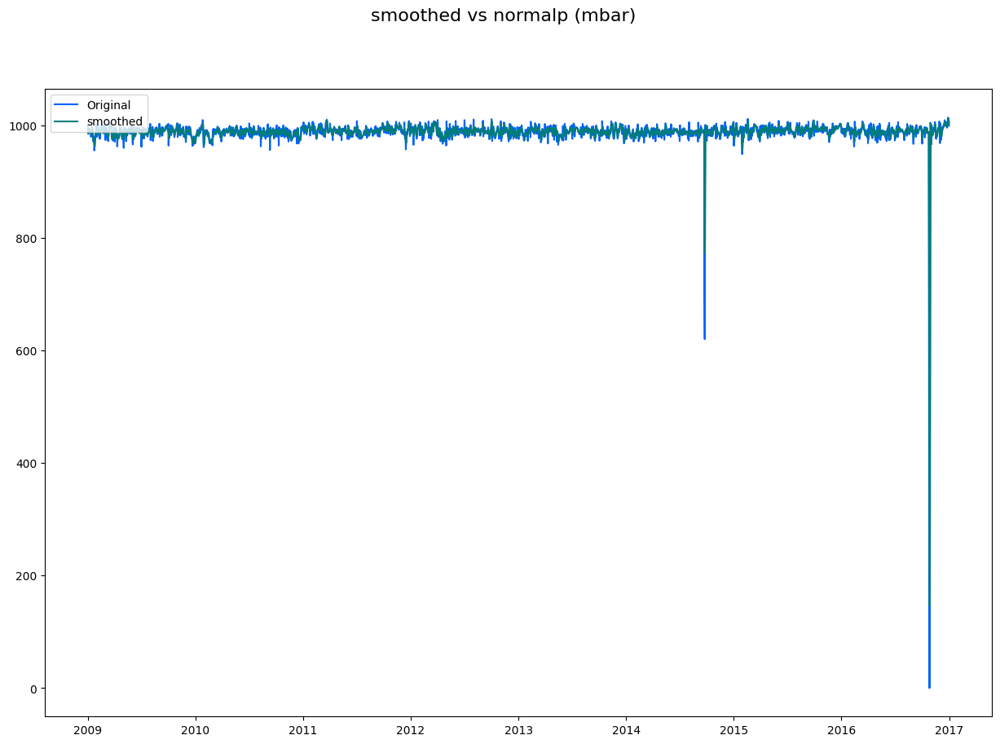

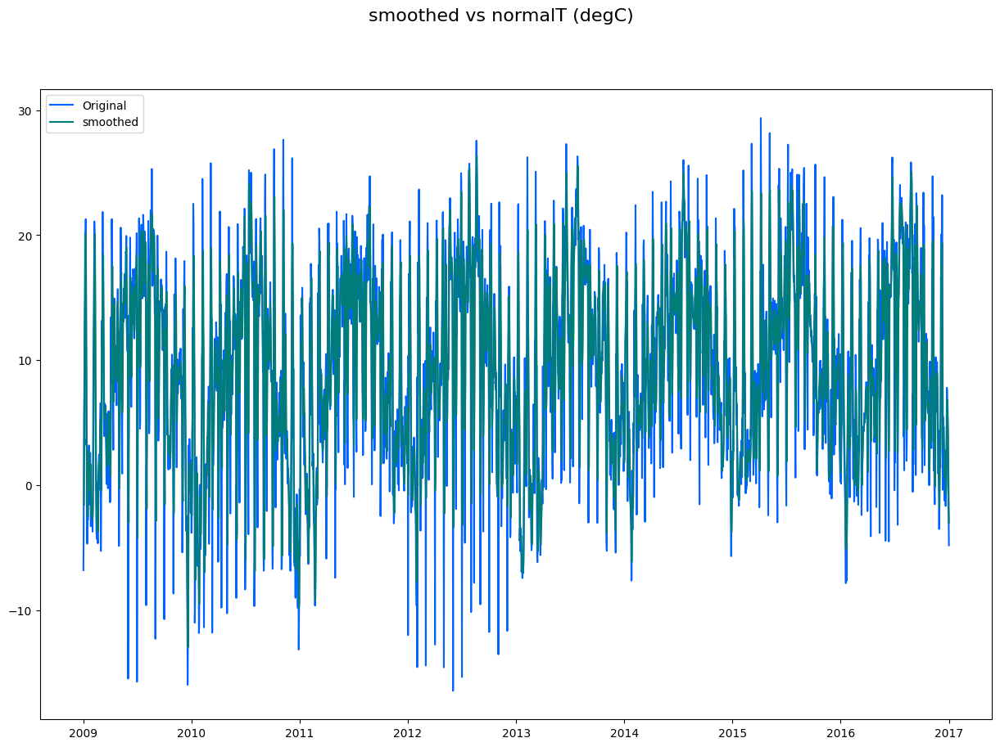

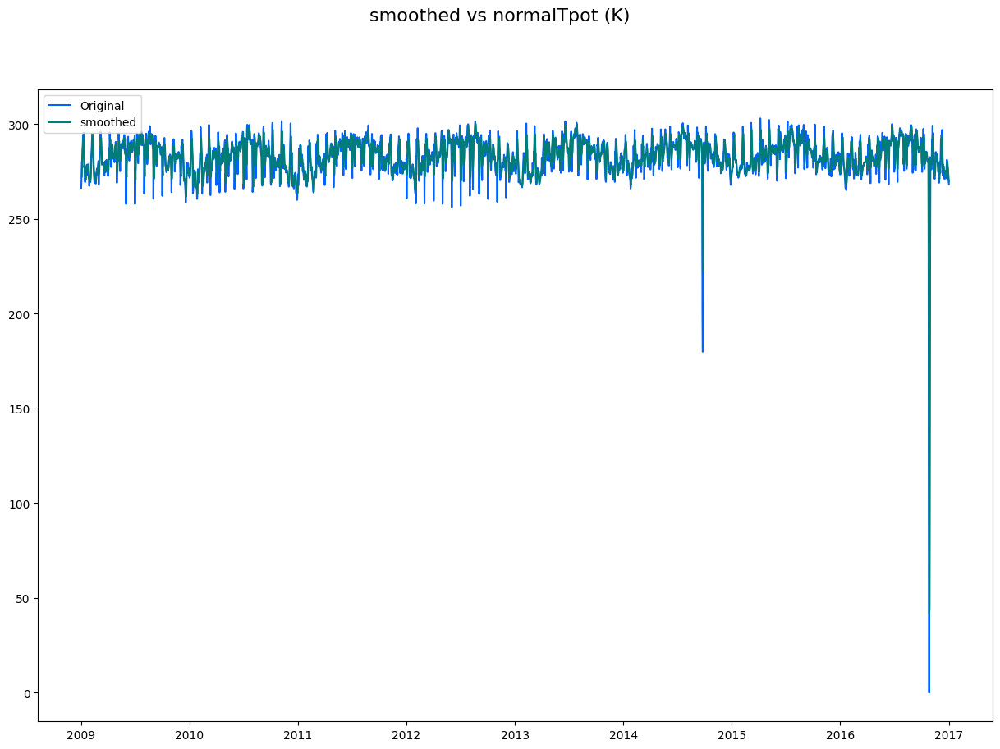

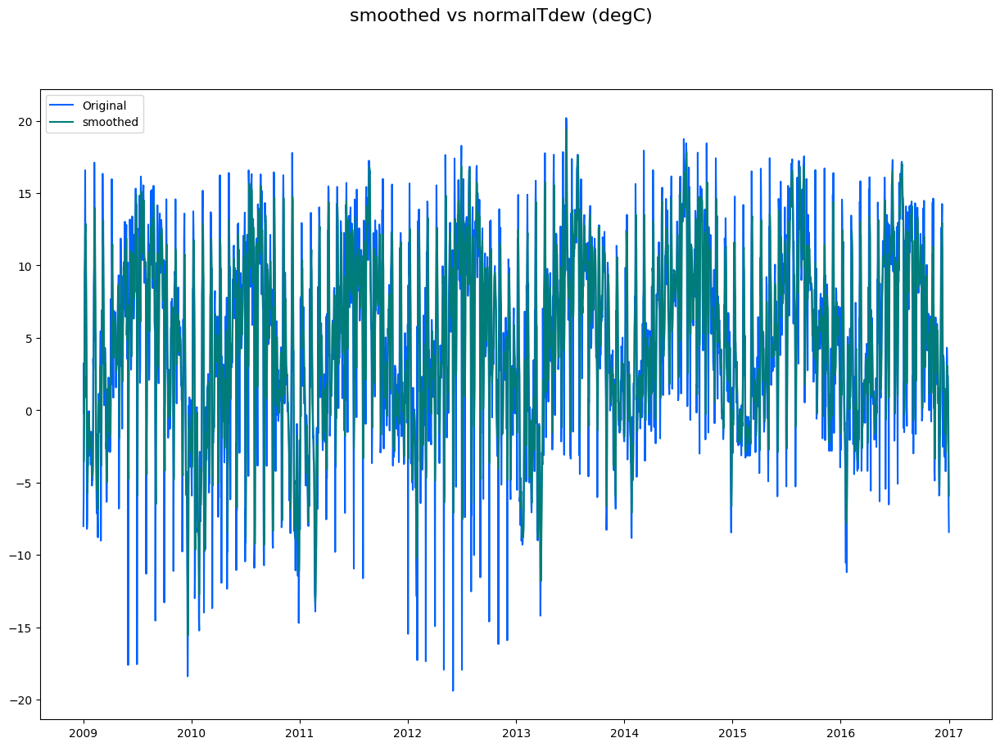

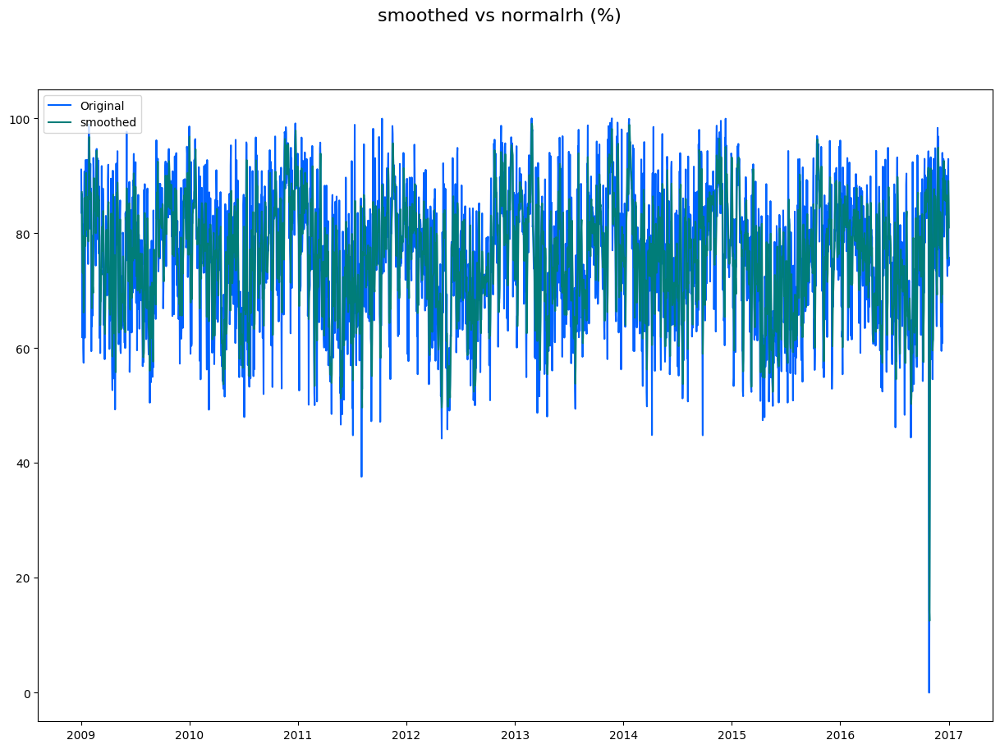

...

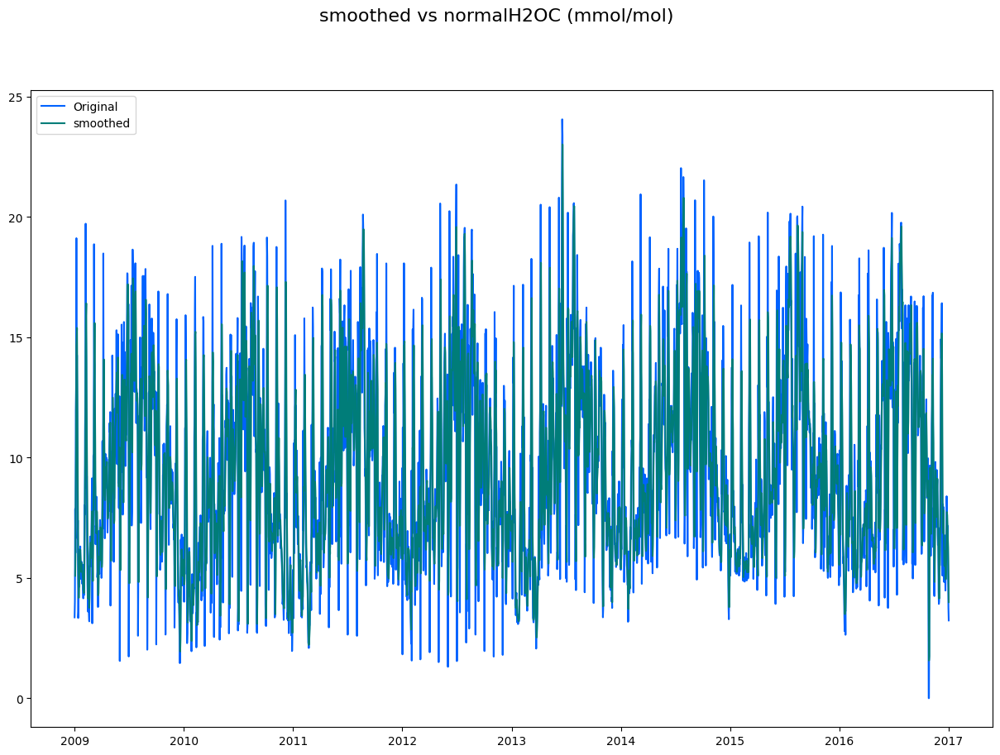

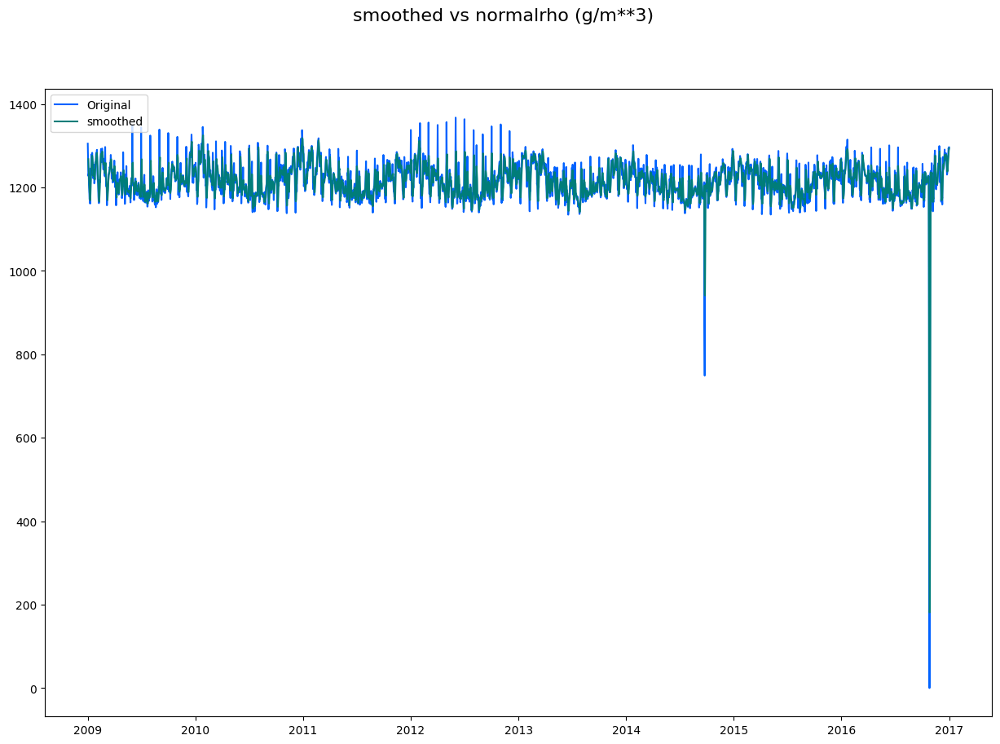

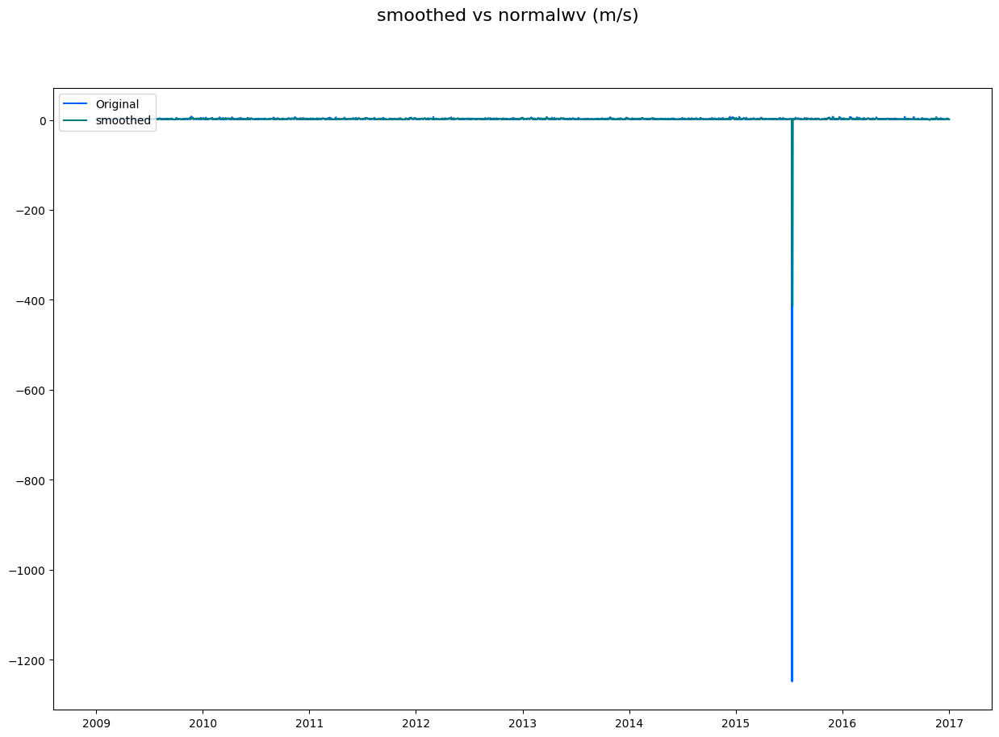

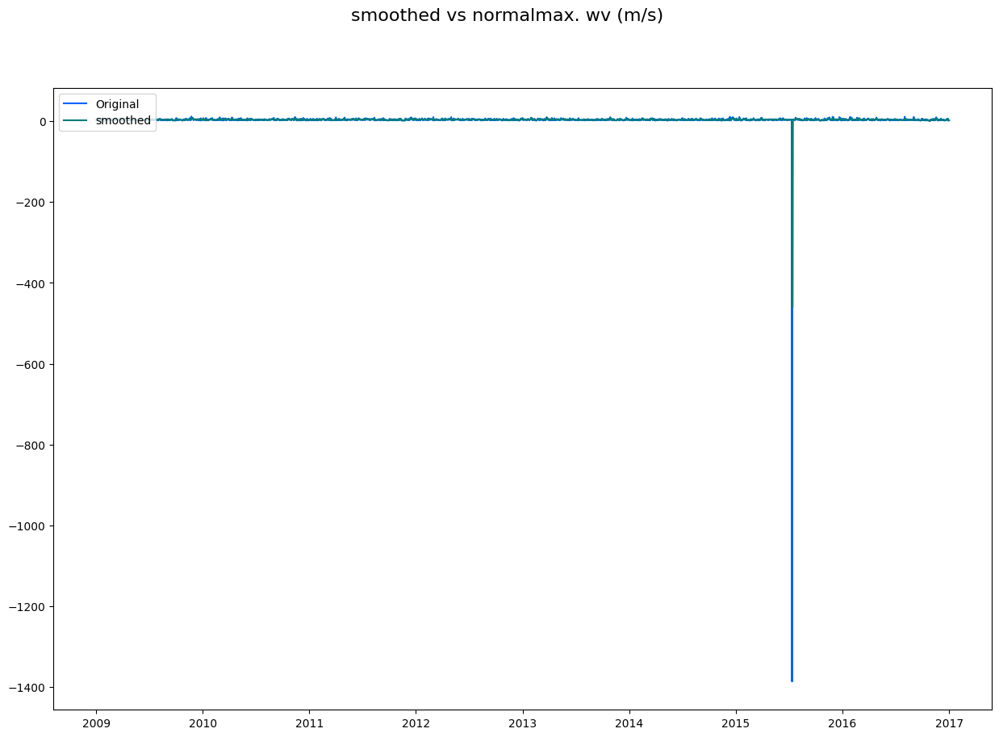

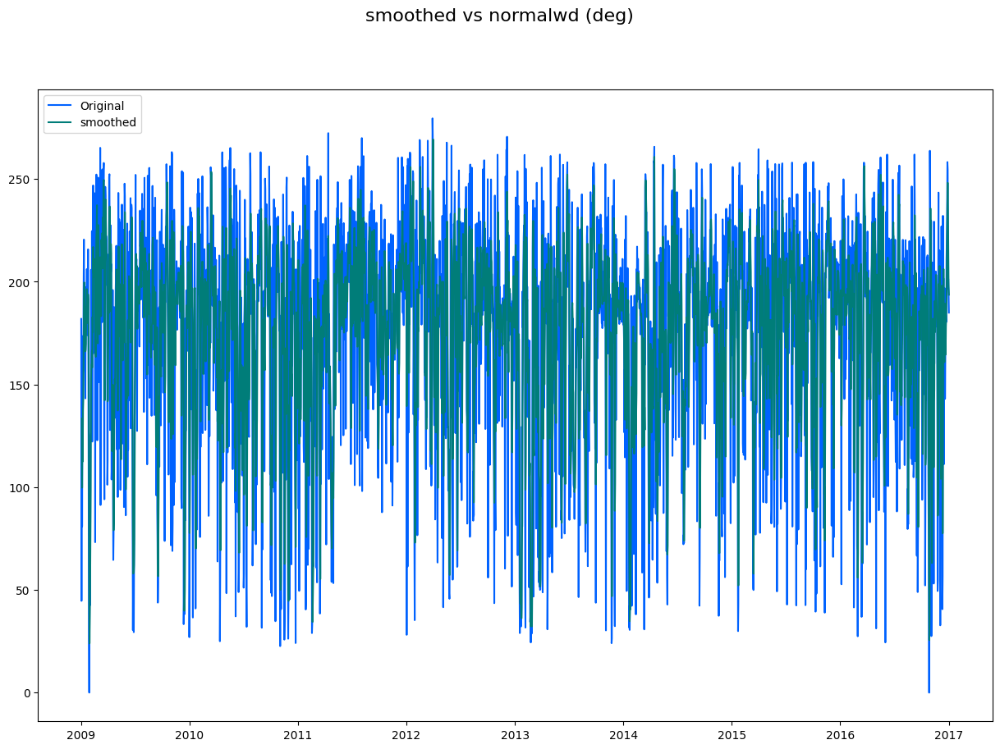

In [54]:
for col in df_new.columns:
    fig, axes = plt.subplots(1, 1, sharex=False, sharey=False)
    fig.set_figheight(10)
    fig.set_figwidth(15)
    fig.suptitle('smoothed vs normal'+col, fontsize=16)


    axes.plot(df_daily[col], label='Original')
    axes.legend(loc='upper left');
    axes.plot(smoothed_daily[col], label='smoothed')
    axes.legend(loc='upper left');


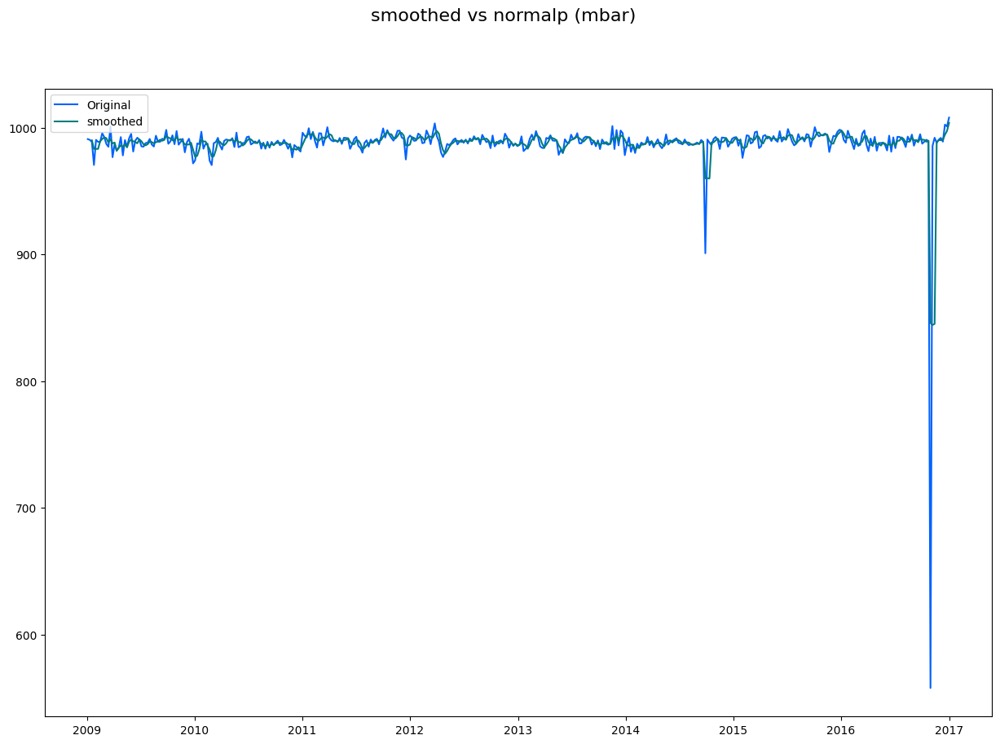

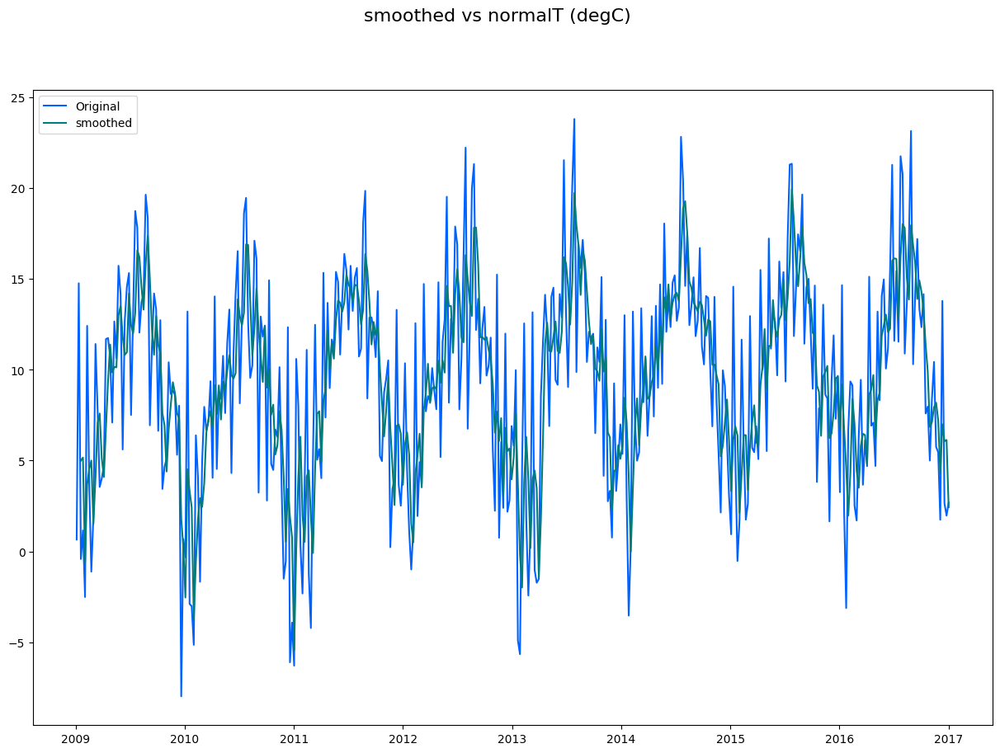

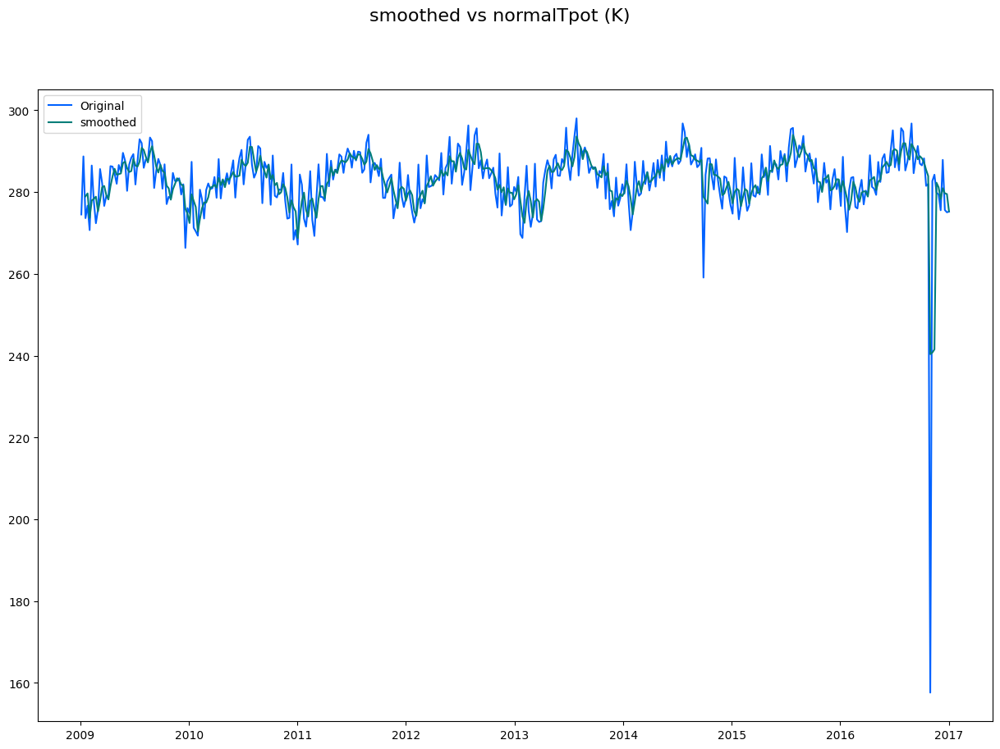

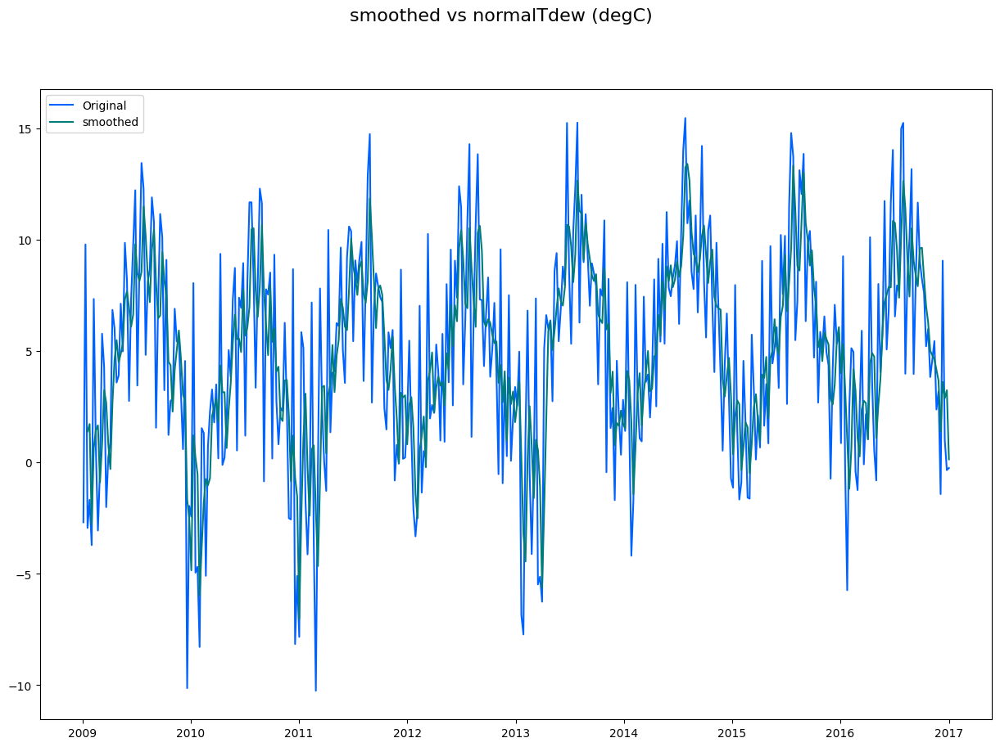

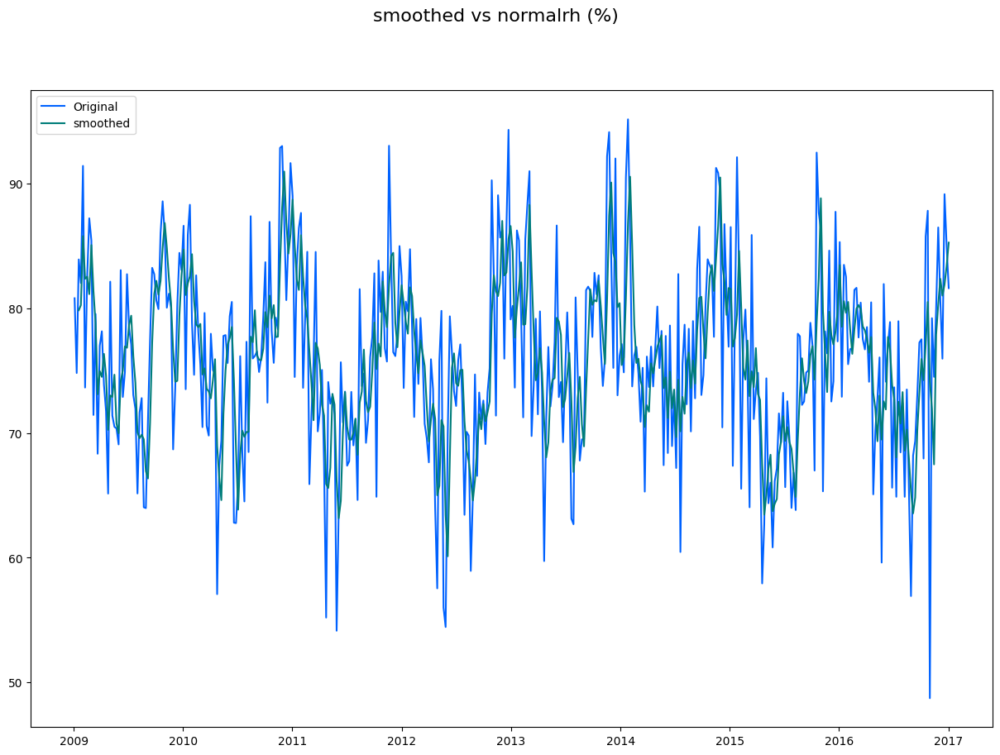

...

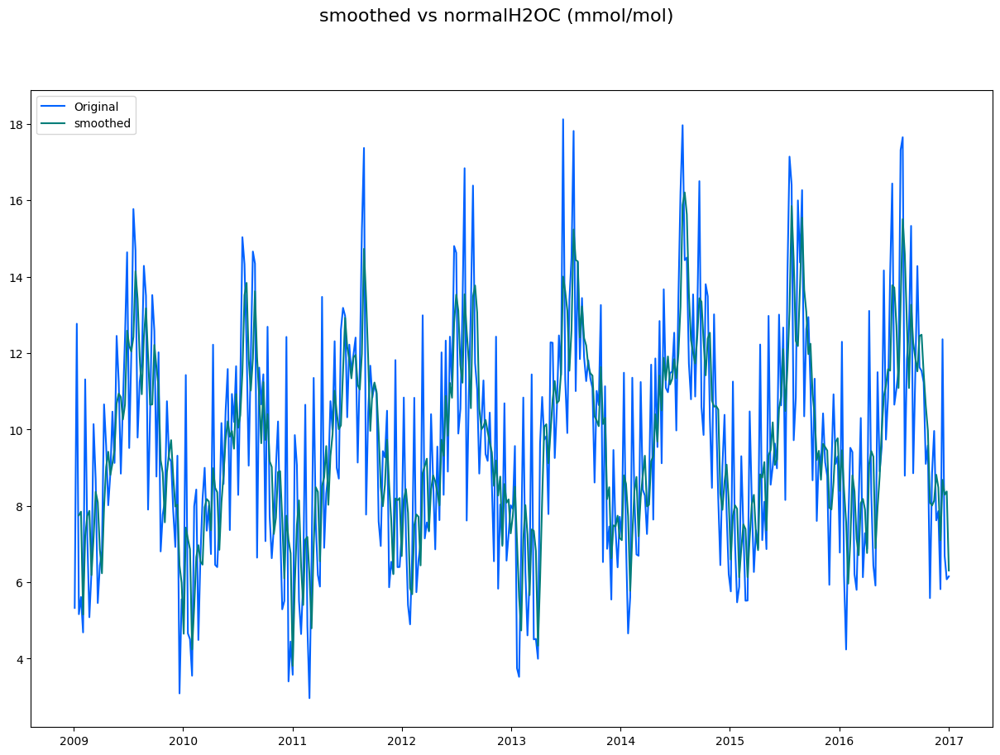

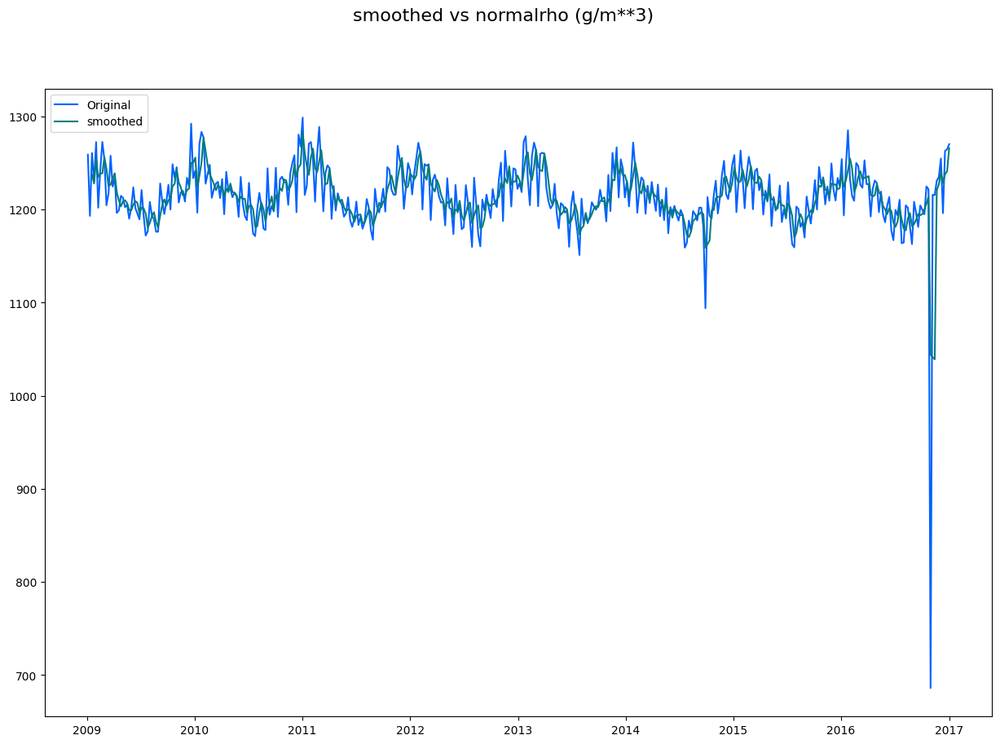

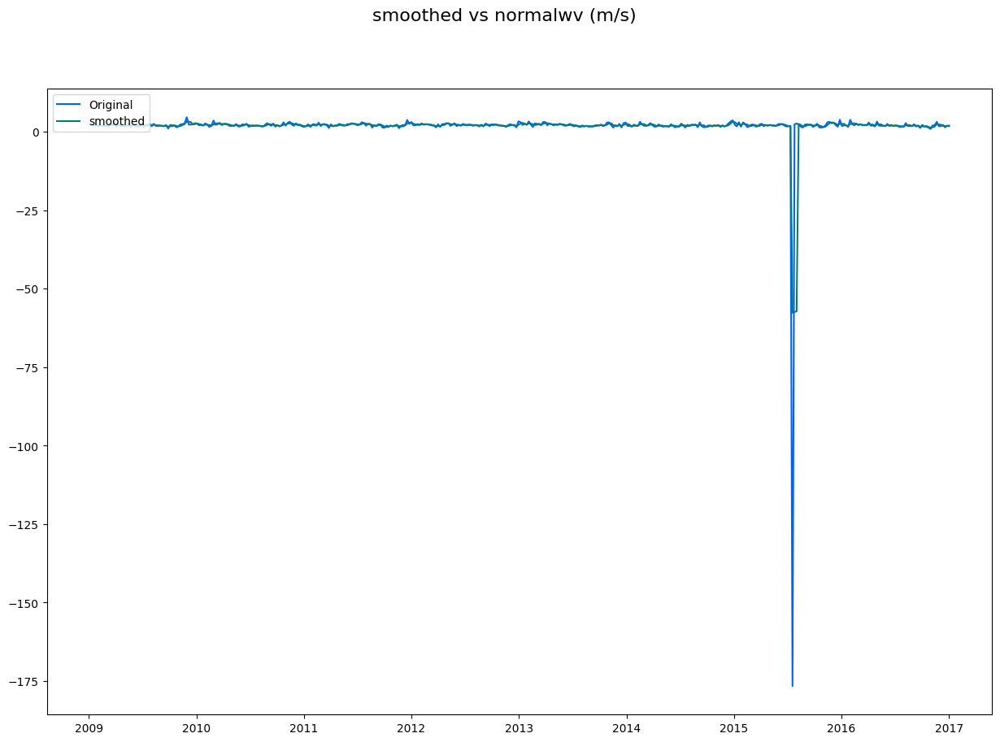

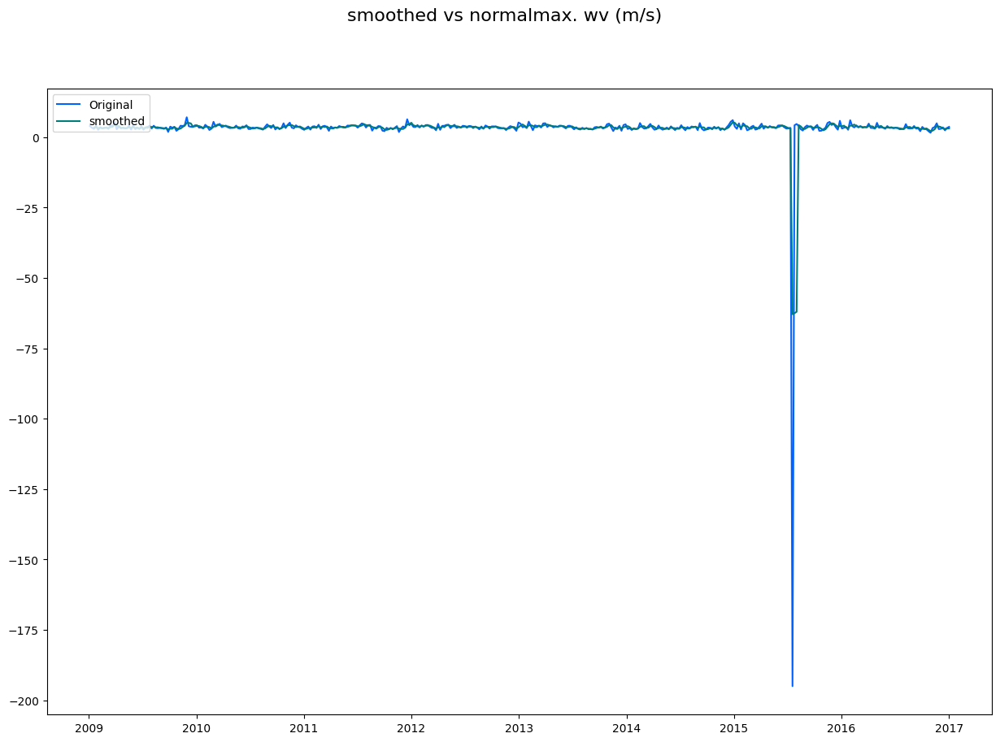

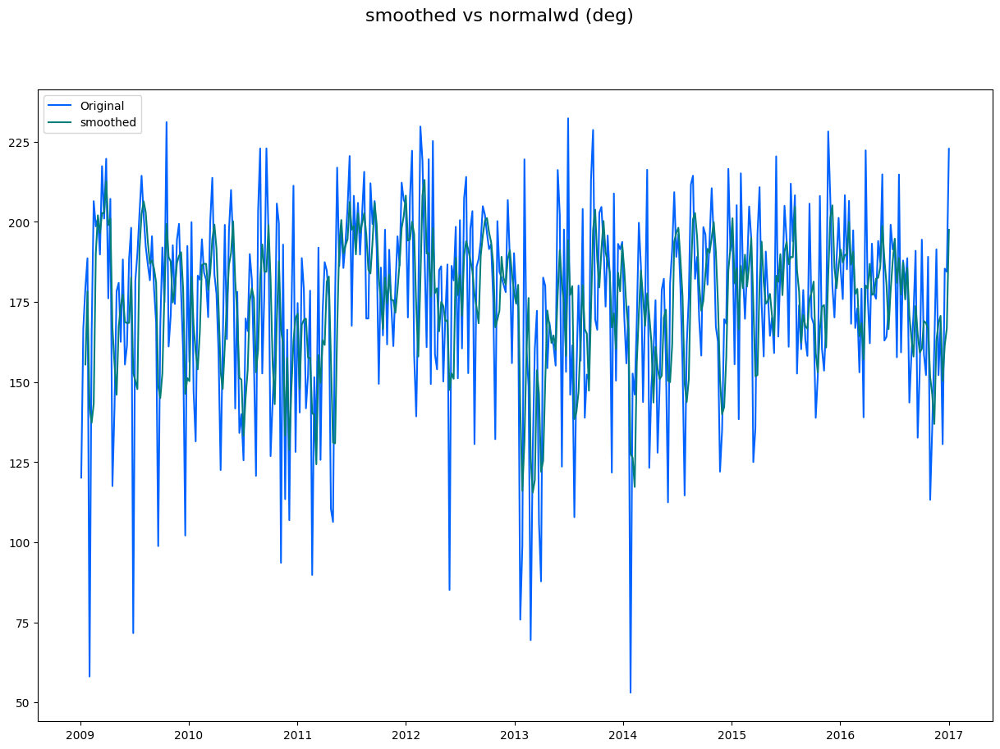

In [55]:
for col in df_new.columns:
    fig, axes = plt.subplots(1, 1, sharex=False, sharey=False)
    fig.set_figheight(10)
    fig.set_figwidth(15)
    fig.suptitle('smoothed vs normal'+col, fontsize=16)


    axes.plot(df_weekly[col], label='Original')
    axes.legend(loc='upper left');
    axes.plot(smoothed_weekly[col], label='smoothed')
    axes.legend(loc='upper left');



### Weekly Seasonal Decomposition

In this section, we perform weekly seasonal decomposition for each climate data variable in the DataFrame `df_weekly`.

We create a new DataFrame `decomposed_weekly` with the same shape as `df_weekly`, initially filled with zeros. This DataFrame will be used to store the residual components obtained from the seasonal decomposition.

We iterate through each column in the original DataFrame `df_weekly` using a for loop. For each column, we apply the `seasonal_decompose()` function from `statsmodels.tsa.seasonal` with an additive model and a seasonal period of 24 (assuming a daily time series with 24 hours). The resulting residual series is extracted and stored in the `decomposed_weekly` DataFrame.

The residual series represents the remaining variability in the weekly climate data after removing the trend and seasonality. Storing these residuals separately allows for further analysis and exploration of the underlying patterns and fluctuations in the data.

Additionally, by decomposing the data into its components, we prepare it for further analysis and modeling, including the use of neural networks. The residual components obtained from seasonal decomposition can serve as inputs or features for training neural network models, enabling the prediction of future climate data trends and patterns.


In [56]:
decomposed_weekly=df_weekly
num_rows, num_columns = df_weekly.shape

# Create a new DataFrame with the same shape, filled with NaN values
decomposed_weekly = pd.DataFrame(0, index=df_weekly.index, columns=df_weekly.columns)

for col in df_weekly:
    
    ss_decomposition = seasonal_decompose(x=df_weekly[col], model='additive', period=24)
    residual_series = pd.Series(ss_decomposition.resid, index=df_weekly.index)
    
    
    decomposed_weekly[col]=pd.Series(ss_decomposition.resid, index=df_weekly.index)
   

### LSTM Time Series Forecasting with Climate Data

In this code snippet, we demonstrate a workflow for building an LSTM (Long Short-Term Memory) neural network model to forecast climate data. Below is a breakdown of the steps involved:

#### Data Preparation:
- **Normalization**: The input features and target variables are normalized using Min-Max scaling to the range [0, 1].
- **Sequence Creation**: Time series sequences of a specified length are created from the normalized data, where each sequence contains a window of historical observations.

#### Model Building:
- **Sequential Model**: An LSTM model is built using the `Sequential` API from Keras.
- **LSTM Layers**: Multiple LSTM layers with dropout regularization are added to capture temporal dependencies in the data.
- **Dense Output Layer**: A dense output layer is added with the number of neurons equal to the number of target features.
- **Compilation**: The model is compiled with the Adam optimizer and Mean Squared Error (MSE) loss function.

#### Model Training:
- **Training Data Split**: The data is split into training and testing sets.
- **Model Training**: The model is trained on the training set with a specified number of epochs and batch size.

#### Model Evaluation:
- **Evaluation**: The model's performance is evaluated on the test set using the Mean Squared Error (MSE) loss function.

#### Making Predictions:
- **Prediction**: The trained model is used to make predictions on the test set.
- **Inverse Transformation**: The scaled predictions are inverse-transformed to obtain the actual forecasted values.

This code provides a comprehensive pipeline for training an LSTM neural network model for time series forecasting using climate data.


In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import SimpleRNN, Dense, Bidirectional
from keras.optimizers import Adam 
# Load your dataset
# Replace 'your_dataset.csv' with the actual path to your dataset
df = df_daily

# Select the features you mentioned
features = ['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
            'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
            'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
            'wd (deg)']

# Replace 'your_target_columns' with the actual names of the features to predict
target_columns = ['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
                  'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
                  'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
                  'wd (deg)']

# Select features and target
X = df[features].values
y = df[target_columns].values

# Normalize the features
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y)

# Create sequences for time series data
sequence_length = 10  # You may adjust this based on the characteristics of your data
X_sequences, y_sequences = [], []

for i in range(len(X_scaled) - sequence_length):
    X_sequences.append(X_scaled[i:i+sequence_length].tolist())  # Convert to list
    y_sequences.append(y_scaled[i+sequence_length].tolist())    # Convert to list

X_sequences, y_sequences = np.array(X_sequences), np.array(y_sequences)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_sequences, y_sequences, test_size=0.2, random_state=42)

# Build the LSTM model
model = Sequential()
model.add(Bidirectional(LSTM(1000, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True)))
model.add(Dropout(0.2))
model.add(LSTM(500, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(500))
model.add(Dense(len(target_columns)))
model.compile(optimizer=Adam(lr=0.001), loss='mse')
 # Output layer has the same number of neurons as target features
model.compile(optimizer='adam', loss='mse')

# Train the model
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test), verbose=1)

# Evaluate the model on the test set
loss = model.evaluate(X_test, y_test)
print(f'Mean Squared Error on Test Set: {loss}')

# Make predictions
predictions_scaled = model.predict(X_test)

# Inverse transform the scaled predictions to get the actual values
predictions = scaler_y.inverse_transform(predictions_scaled)
y_test_actual = scaler_y.inverse_transform(y_test)

# Now 'predictions' contains the forecasted feature values


In [63]:
df_weekly

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
2009-01-04,990.9,0.7,274.5,-2.7,80.8,7.1,5.3,1.8,3.3,5.3,"1,259.0",2.5,3.9,120.2
2009-01-11,990.3,14.8,288.7,9.8,74.8,18.5,12.6,5.8,8.0,12.8,"1,193.2",2.0,3.3,166.8
2009-01-18,988.6,-0.4,273.6,-2.9,83.9,6.1,5.1,1.0,3.2,5.2,"1,260.6",1.8,3.0,179.5
2009-01-25,970.5,1.2,276.7,-1.7,82.0,6.8,5.4,1.3,3.5,5.6,"1,230.0",2.6,4.0,188.6
2009-02-01,990.3,-2.5,270.7,-3.7,91.4,5.1,4.6,0.4,2.9,4.7,"1,272.4",1.6,2.6,58.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-04,991.9,1.7,275.6,-1.4,80.6,7.3,5.8,1.6,3.6,5.8,"1,254.7",1.8,2.9,168.4
2016-12-11,988.9,13.8,287.9,9.1,76.0,17.7,12.2,5.5,7.7,12.4,"1,196.1",2.2,3.4,130.6
2016-12-18,"1,002.3",2.6,275.6,1.0,89.2,7.5,6.7,0.8,4.2,6.7,"1,262.9",1.4,2.4,185.4
2016-12-25,"1,000.9",2.0,275.1,-0.3,85.0,7.2,6.1,1.2,3.8,6.1,"1,264.7",1.9,3.3,184.4


### LSTM Model Predictions vs Actual Values

In this code snippet, we visualize the predictions made by the LSTM model against the actual values for each target variable. The following steps are performed:

1. **Inverse Transformation**: The scaled target values (`y_test`) are inverse-transformed to obtain the actual values (`y_test_actual`) using the `inverse_transform` method of the MinMaxScaler.

2. **Plotting Predictions**: For each target variable in `target_columns`, a plot is generated to compare the actual values (`y_test_actual`) with the predicted values (`predictions`) made by the LSTM model.

3. **Visualization**: Each plot displays the actual values as a line plot with markers ('Actual') and the predicted values as a line plot with markers ('Predicted'). The title of each plot indicates the target variable being visualized.

These plots provide a visual comparison between the actual and predicted values for each target variable, allowing for an assessment of the model's performance in forecasting climate data.


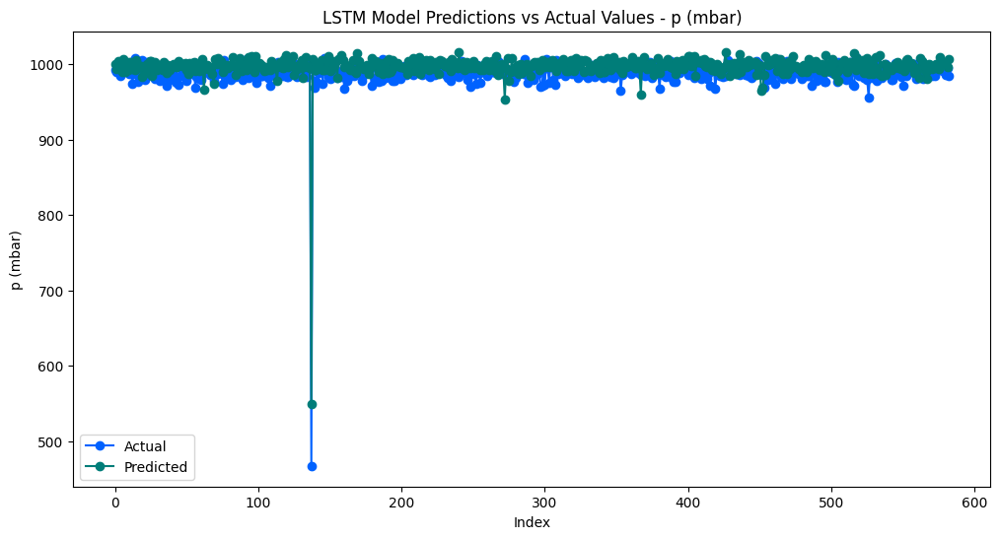

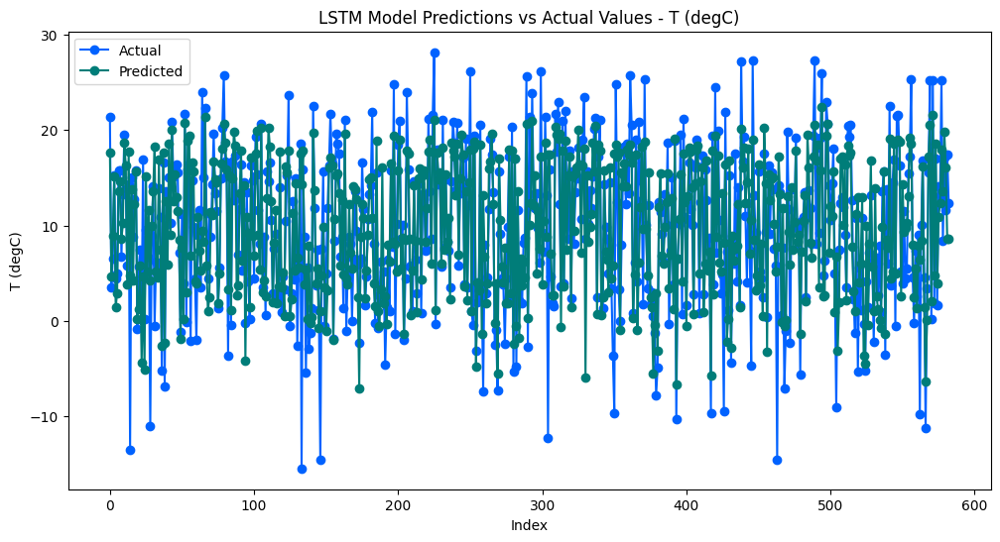

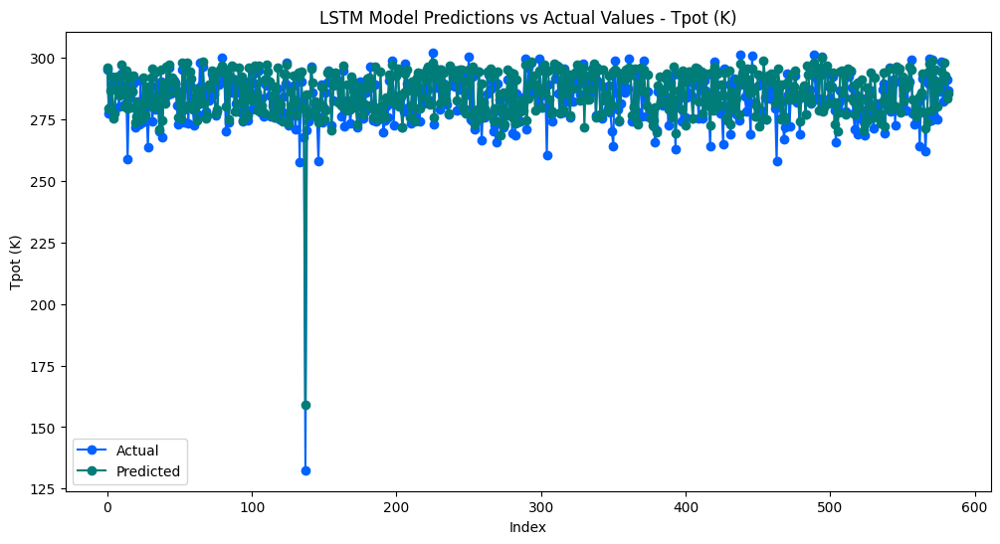

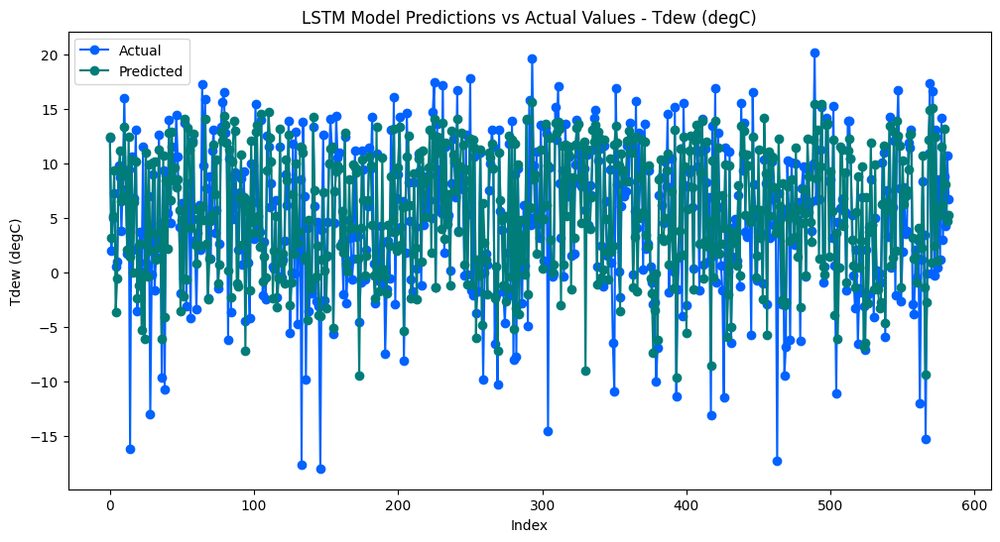

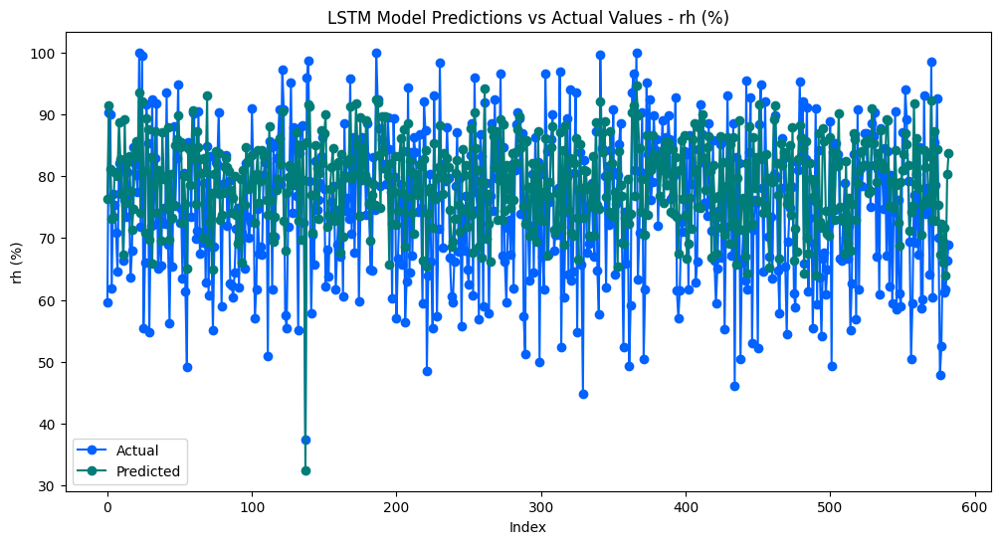

...

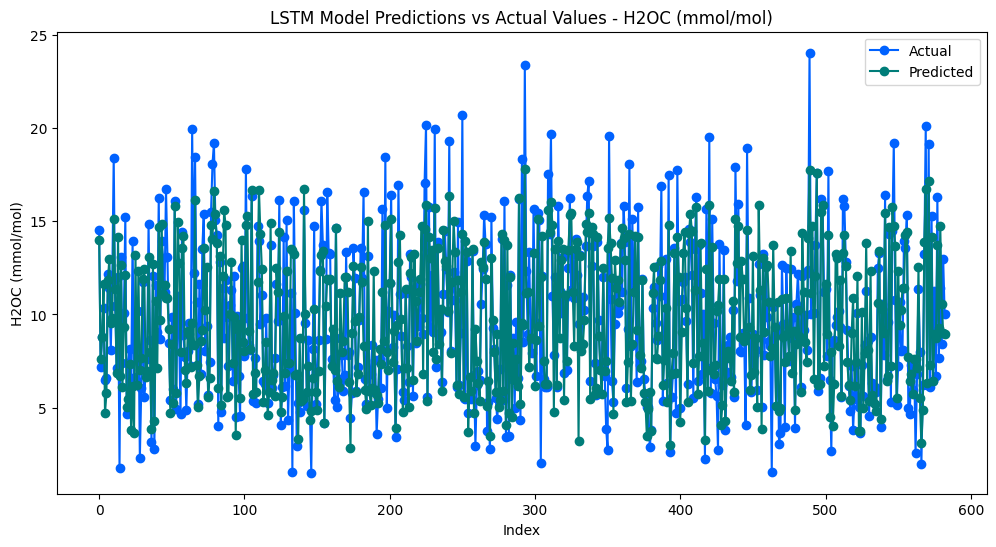

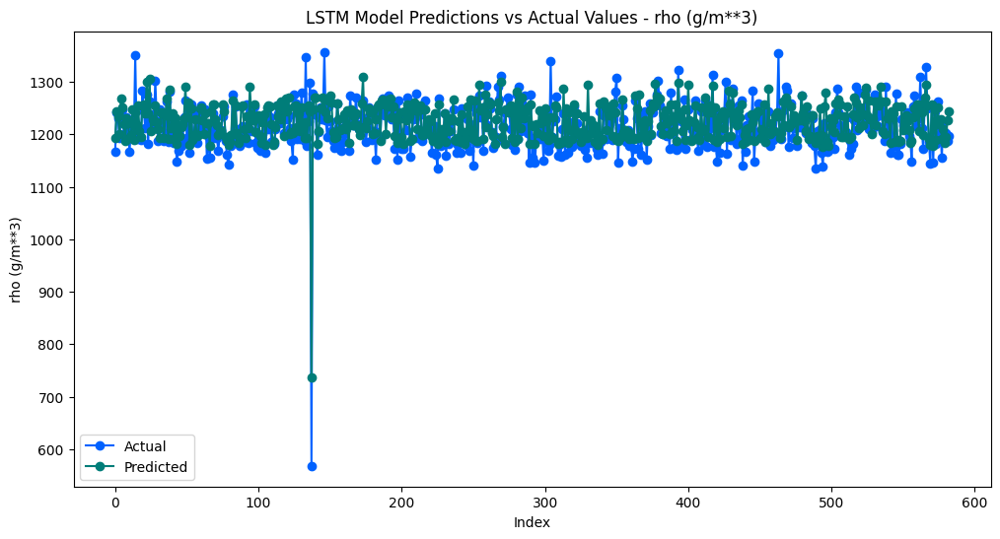

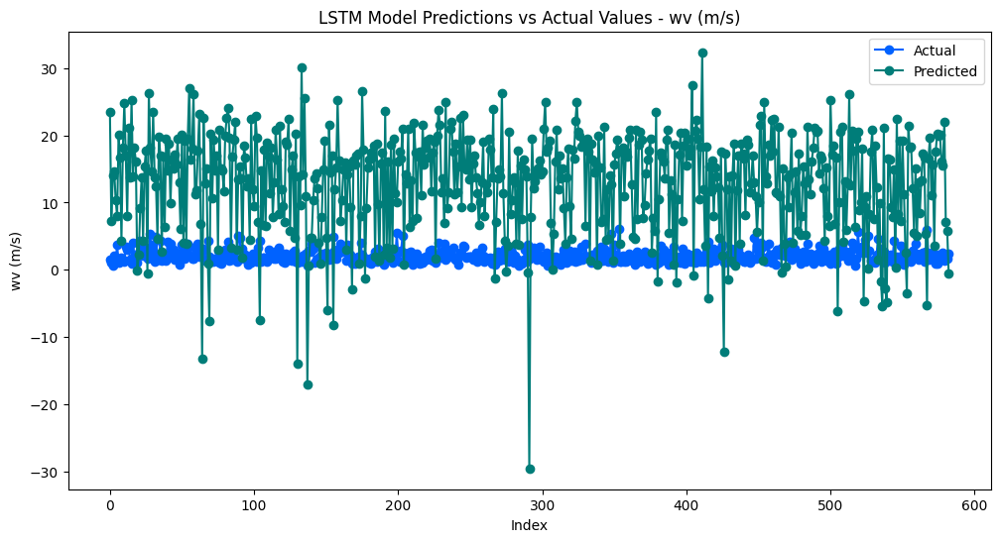

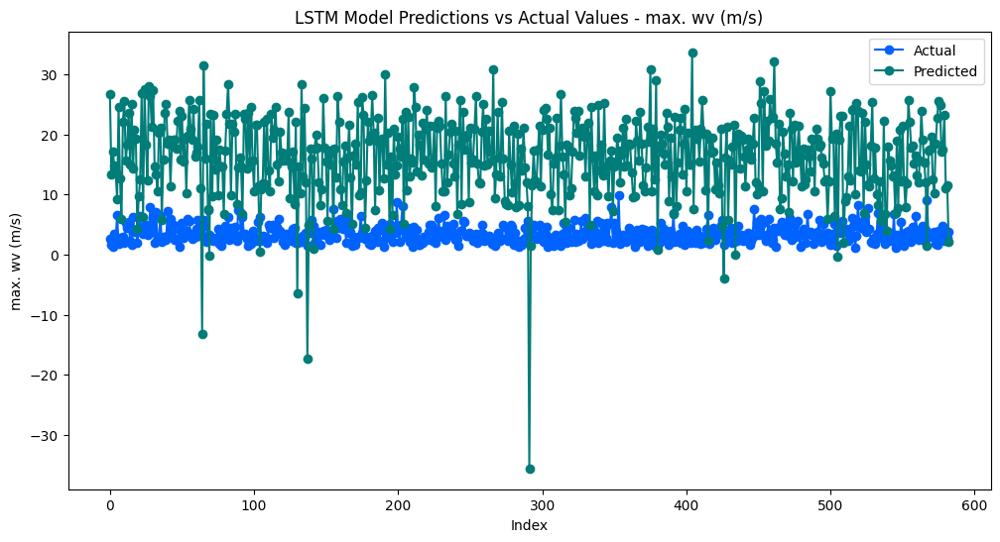

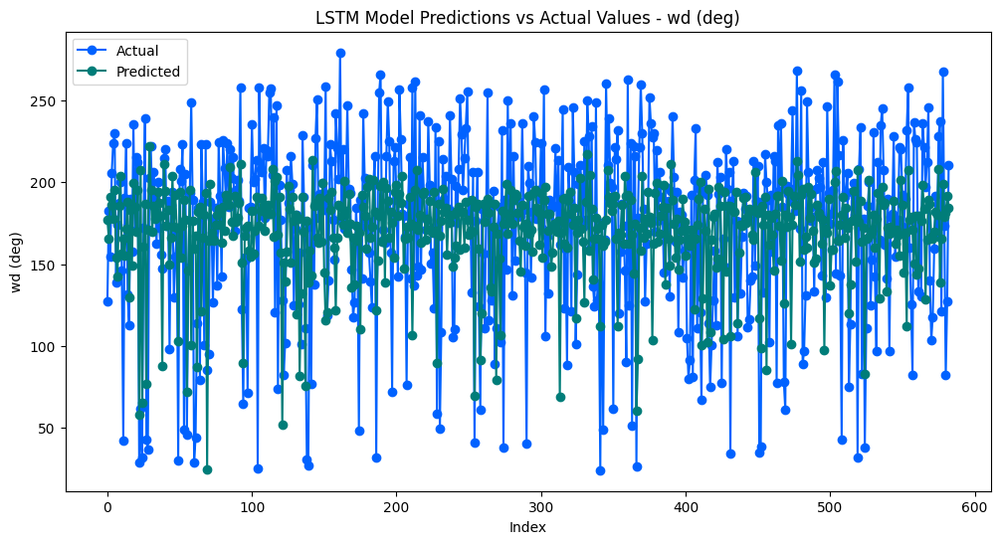

In [64]:
y_test_actual = scaler_y.inverse_transform(y_test)
for i, target_column in enumerate(target_columns):
    plt.figure(figsize=(12, 6))
    plt.plot(y_test_actual[:, i], label='Actual', marker='o')
    plt.plot(predictions[:, i], label='Predicted', marker='o')
    plt.title(f'LSTM Model Predictions vs Actual Values - {target_column}')
    plt.xlabel('Index')
    plt.ylabel(target_column)
    plt.legend()
    plt.show()

### LSTM Model Prediction for Future Climate Data

In this code block, we utilize a trained LSTM (Long Short-Term Memory) model to forecast future climate data based on historical daily data stored in the DataFrame `df_daily`.

#### Data Preparation:
- We duplicate the original DataFrame `df_daily`, storing daily climate data, into a new DataFrame `df` to preserve the original dataset.
- The chosen features for prediction encompass atmospheric pressure (`p (mbar)`), temperature (`T (degC)`), potential temperature (`Tpot (K)`), dew point temperature (`Tdew (degC)`), relative humidity (`rh (%)`), and other relevant meteorological variables.
- The features are normalized utilizing `MinMaxScaler` from scikit-learn to scale them within the range of 0 to 1.

#### Model Loading and Prediction:
- We assume the existence of a pre-trained LSTM model, which should be loaded prior to executing this code block. The model architecture and pre-trained weights are not included here but should be loaded appropriately.
- The input data is reshaped to conform to the input shape required by the LSTM model.
- We forecast future climate data for a period of 1 year (365 days), assuming daily data points.

#### Note:
- Before executing this code block, ensure that you possess a pre-trained LSTM model and have executed the necessary preprocessing steps for data normalization.


Upon execution, the variable `predictions_scaled` will contain the scaled predictions of future climate data. Further processing may be necessary to acquire the actual values through inverse transformation of the scaled predictions.


In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Bidirectional, LSTM, Dropout, Dense
from keras.optimizers import Adam

# Assuming df_daily is your original DataFrame with daily data
df = df_daily.copy()

# Select the features you mentioned
features = ['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
            'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
            'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
            'wd (deg)']

# Normalize the features
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df[features])

X_scaled = X_scaled[-sequence_length:]  # Use the last sequence_length data points for prediction

# Reshape the input data for LSTM
X_input = X_scaled.reshape(1, sequence_length, len(features))

# Load the trained model
"""
model = Sequential()
model.add(Bidirectional(LSTM(100, input_shape=(sequence_length, len(features)), return_sequences=True)))
model.add(Dropout(0.2))
model.add(LSTM(50, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(50))
model.add(Dense(len(features)))
model.compile(optimizer=Adam(lr=0.001), loss='mse')

# Load the pre-trained weights
model.load_weights('your_model_weights.h5')  # Replace with the actual path to your model weights
"""
# Predict 3 years into the future
predictions_scaled = []

for _ in range(365 * 1):  # Assuming daily data
    prediction_scaled = model.predict(X_input)
    predictions_scaled.append(prediction_scaled.flatten())
    X_input = np.roll(X_input, -1, axis=1)  # Shift the input for the next prediction
    X_input[0, -1, :] = prediction_scaled.flatten()

# Inverse transform the scaled predictions to get the actual values
predictions = scaler_y.inverse_transform(predictions_scaled)

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Bidirectional, LSTM, Dropout, Dense
from keras.optimizers import Adam

# Assuming df_daily is your original DataFrame with daily data
df = df_daily.copy()

# Select the features you mentioned
features = ['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
            'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
            'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
            'wd (deg)']

# Normalize the features
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(df[features])

X_scaled = X_scaled[-sequence_length:]  # Use the last sequence_length data points for prediction

# Reshape the input data for LSTM
X_input = X_scaled.reshape(1, sequence_length, len(features))

# Load the trained model
"""
model = Sequential()
model.add(Bidirectional(LSTM(100, input_shape=(sequence_length, len(features)), return_sequences=True)))
model.add(Dropout(0.2))
model.add(LSTM(50, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(50))
model.add(Dense(len(features)))
model.compile(optimizer=Adam(lr=0.001), loss='mse')

# Load the pre-trained weights
model.load_weights('your_model_weights.h5')  # Replace with the actual path to your model weights
"""
# Predict 3 years into the future
predictions_scaled = []

for _ in range(365 * 1):  # Assuming daily data
    prediction_scaled = model.predict(X_input)
    predictions_scaled.append(prediction_scaled.flatten())
    X_input = np.roll(X_input, -1, axis=1)  # Shift the input for the next prediction
    X_input[0, -1, :] = prediction_scaled.flatten()

# Inverse transform the scaled predictions to get the actual values


### Plotting Forecasted Climate Data Averages

In this block of code, we visualize the weekly, monthly, and quarterly averages of the forecasted climate data for each feature in the DataFrame `predicted_df`.

#### Weekly Averages:
- The weekly averages of each feature are calculated using the `resample` method with a frequency of 'W' (weekly).
- A line plot is generated to display the weekly averages of the forecasted climate data for the feature.
- The x-axis represents the dates, and the y-axis represents the average value of the feature.

#### Monthly Averages:
- Similarly, the monthly averages of each feature are calculated using the `resample` method with a frequency of 'M' (monthly).
- A line plot is created to visualize the monthly averages of the forecasted climate data for the feature.
- The x-axis displays the dates, while the y-axis displays the average value of the feature.

#### Quarterly Averages:
- The quarterly averages of each feature are computed using the `resample` method with a frequency of 'Q' (quarterly).
- A line plot is plotted to illustrate the quarterly averages of the forecasted climate data for the feature.
- The x-axis shows the dates, and the y-axis shows the average value of the feature.

These plots provide insights into the trend and variability of the forecasted climate data at different temporal resolutions (weekly, monthly, and quarterly) for each feature.

Please ensure that `predicted_df` contains the forecasted climate data, and the features listed in the `features` 


     p (mbar)  T (degC)  Tpot (K)  Tdew (degC)  rh (%)  VPmax (mbar)  \
0       985.2      -1.3     272.1         -4.8    79.8           5.4   
1       988.8      -0.7     273.6         -3.8    82.3           5.6   
2       988.1      -0.9     273.7         -3.4    85.2           5.4   
3       986.2      -1.4     273.4         -3.6    86.8           5.1   
4       984.8      -1.8     273.1         -3.9    86.7           5.1   
..        ...       ...       ...          ...     ...           ...   
360     989.8      -3.2     272.9         -5.8    85.1           4.8   
361     989.8      -3.2     272.9         -5.8    85.1           4.8   
362     989.8      -3.2     272.9         -5.8    85.1           4.8   
363     989.8      -3.2     272.9         -5.8    85.1           4.8   
364     989.8      -3.2     272.9         -5.8    85.1           4.8   

     VPact (mbar)  VPdef (mbar)  sh (g/kg)  H2OC (mmol/mol)  rho (g/m**3)  \
0             4.3           1.2        2.8              4.

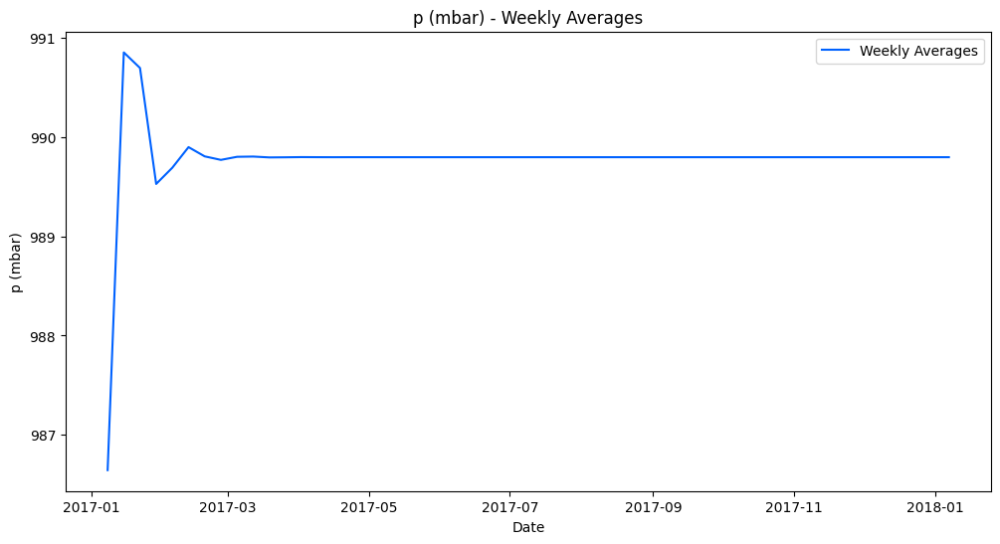

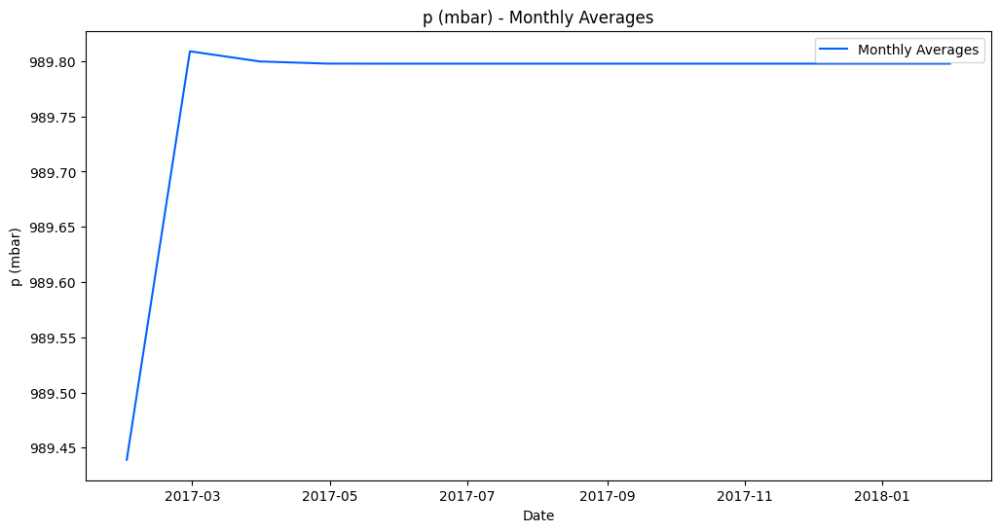

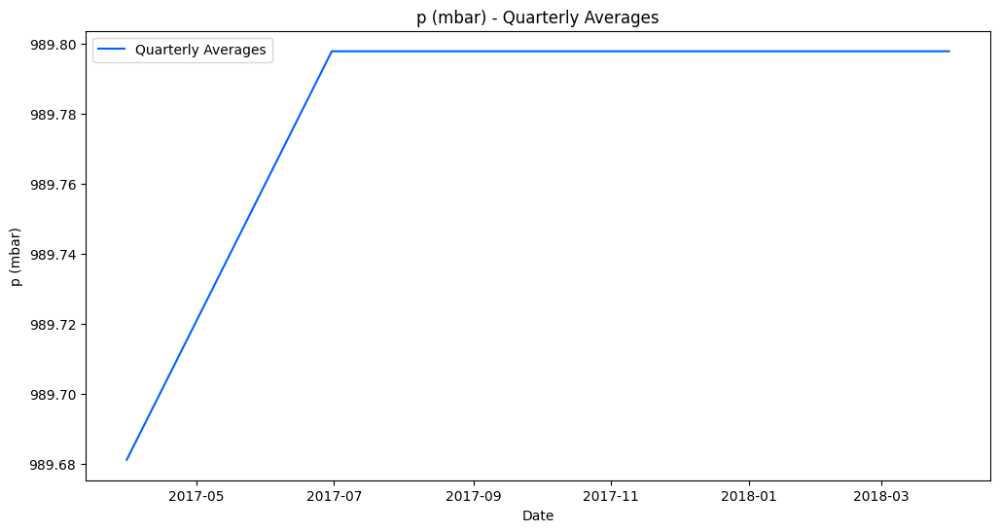

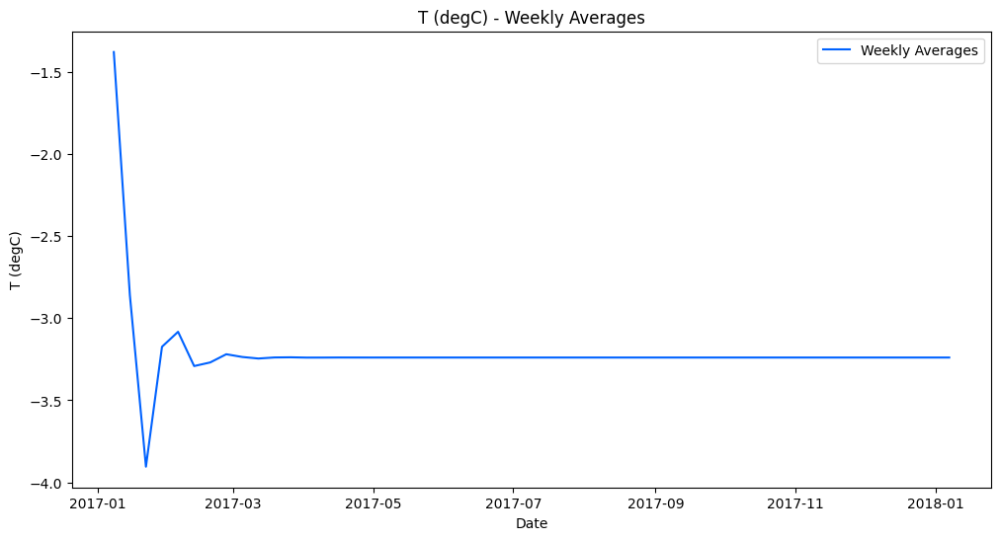

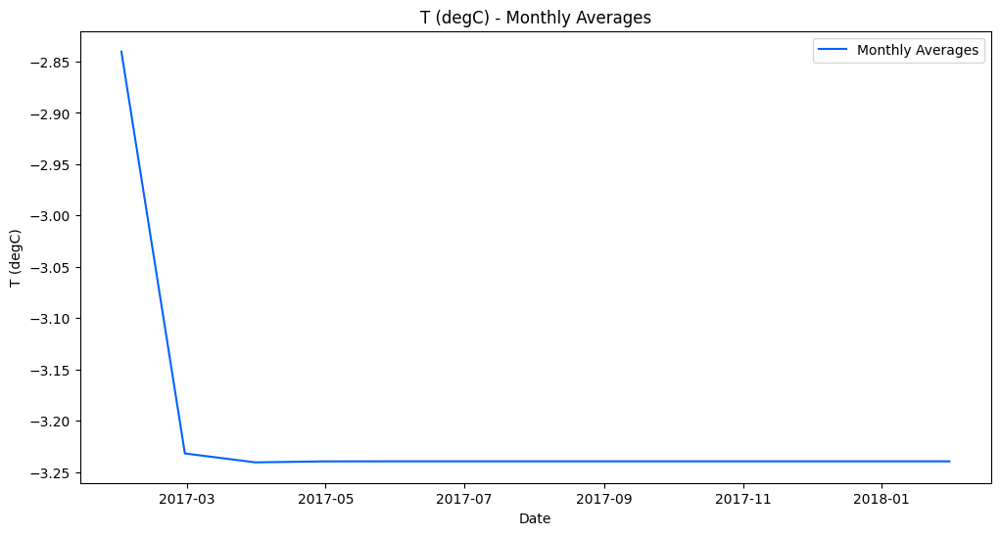

...

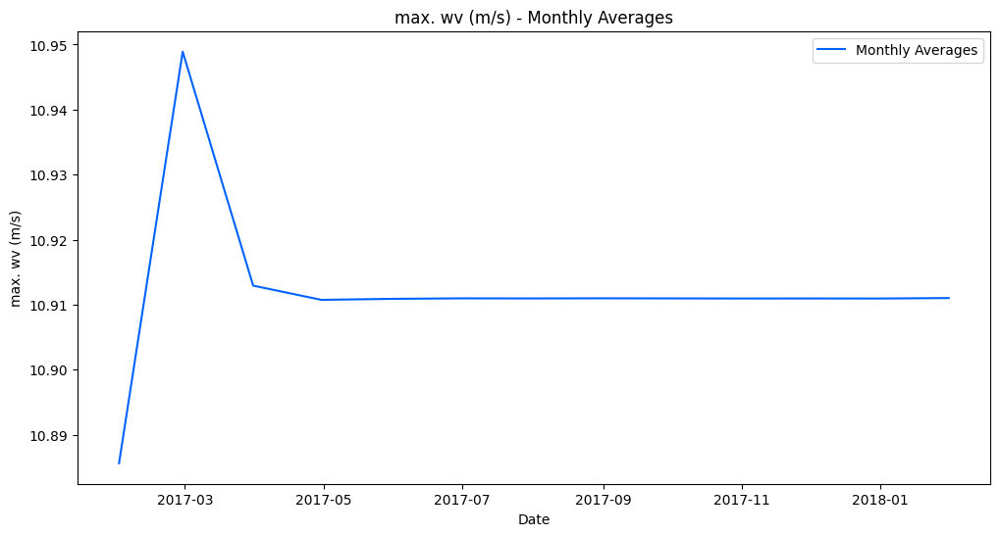

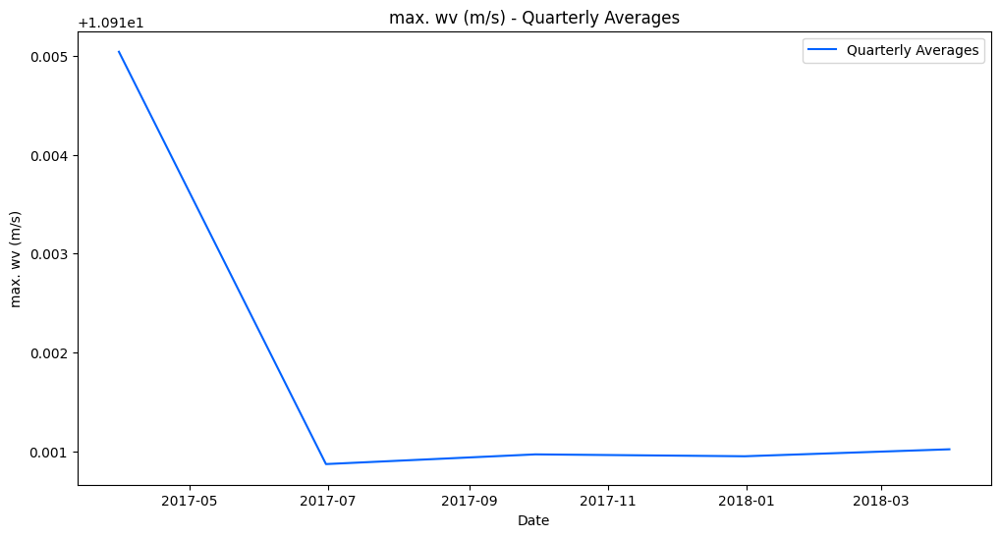

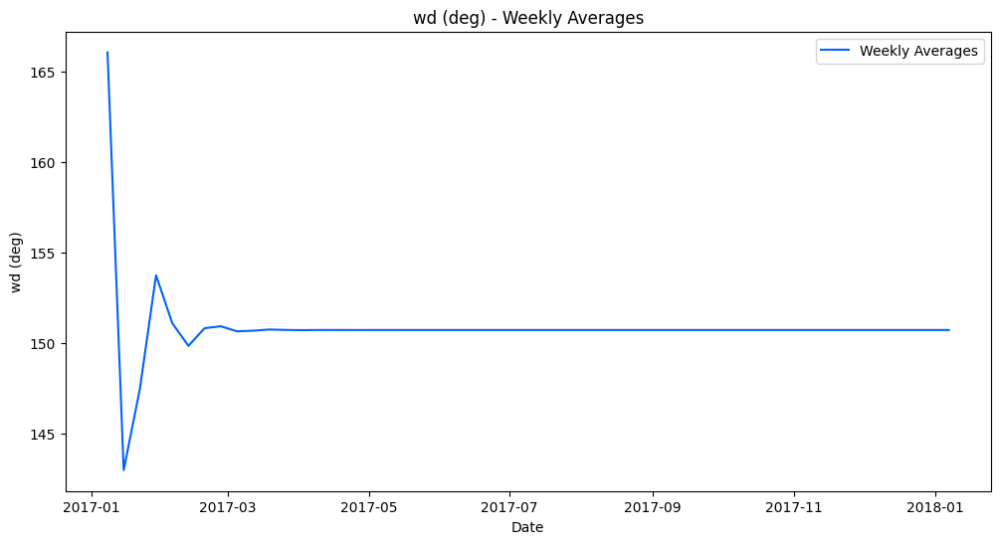

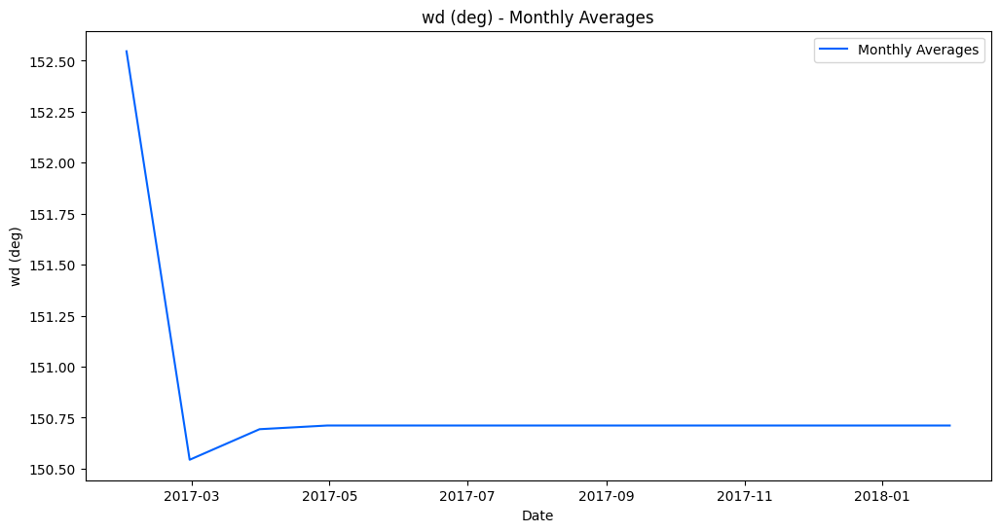

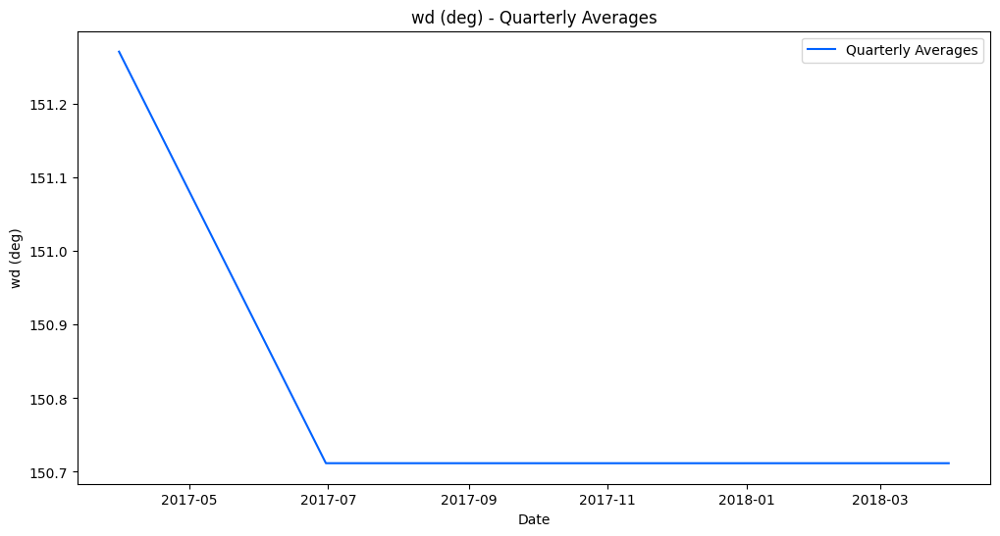

In [68]:
import pandas as pd

# Assuming predictions_scaled is a list of predicted values from the previous code

# Create a DataFrame to store the predicted values
predicted_df = pd.DataFrame(predictions_scaled, columns=features)

# Inverse transform the scaled predictions to get the actual values
scaler_y.fit_transform(y)
predicted_values = scaler_y.inverse_transform(predicted_df.values)

# Update the DataFrame with the actual values
predicted_df.loc[:, :] = predicted_values

# Display the predicted DataFrame
print(predicted_df)

for feature in features:
    predicted_df[feature].index = pd.date_range(start=df.index[-1] + pd.Timedelta(days=1), periods=len(predicted_df))
    predicted_df[feature].index.name = 'Date'

    # Plot weekly averages
    weekly_averages = predicted_df[feature].resample('W').mean()
    plt.figure(figsize=(12, 6))
    plt.plot(weekly_averages, label='Weekly Averages')
    plt.title(f'{feature} - Weekly Averages')
    plt.xlabel('Date')
    plt.ylabel(feature)
    plt.legend()
    plt.show()

    # Plot monthly averages
    monthly_averages = predicted_df[feature].resample('M').mean()
    plt.figure(figsize=(12, 6))
    plt.plot(monthly_averages, label='Monthly Averages')
    plt.title(f'{feature} - Monthly Averages')
    plt.xlabel('Date')
    plt.ylabel(feature)
    plt.legend()
    plt.show()

    # Plot quarterly averages
    quarterly_averages = predicted_df[feature].resample('Q').mean()
    plt.figure(figsize=(12, 6))
    plt.plot(quarterly_averages, label='Quarterly Averages')
    plt.title(f'{feature} - Quarterly Averages')
    plt.xlabel('Date')
    plt.ylabel(feature)
    plt.legend()
    plt.show()

### Conclusion: Limitations of the LSTM Model for Long-Term Climate Prediction

While the LSTM (Long Short-Term Memory) model presented in this analysis demonstrates promise in forecasting future climate data based on historical daily records, it exhibits limitations when predicting long-term or future values. Several factors contribute to the model's inability to accurately forecast climate data over extended time horizons:

1. **Complexity of Climate Systems:**
   Climate systems are highly complex and influenced by numerous interconnected variables and processes. The LSTM model, while capable of capturing temporal dependencies in the data, may struggle to account for the intricate interactions and nonlinear dynamics inherent in climate systems.

2. **Limited Historical Data:**
   The LSTM model relies on historical data to learn patterns and make predictions. However, the availability of historical climate data may be limited, especially for longer time horizons. Insufficient historical data can hinder the model's ability to capture long-term trends and variations accurately.

3. **Non-Stationarity and External Factors:**
   Climate data often exhibit non-stationarity, characterized by changing statistical properties over time. Additionally, external factors such as natural disasters, human activities, and climate change can introduce unpredictability and disrupt historical patterns, making long-term forecasting challenging for the LSTM model.

4. **Model Complexity and Scope:**
   The LSTM model employed in this analysis may have limitations in capturing the full complexity of climate systems and incorporating all relevant variables and factors affecting climate dynamics. A more sophisticated model or a different approach, such as ensemble methods, hybrid models, or integrating domain knowledge, may be necessary to improve long-term climate predictions.

### Future Directions and Recommendations:

1. **Explore Advanced Modeling Techniques:**
   Researchers and practitioners in the field of climate science should explore advanced modeling techniques beyond LSTM, such as hybrid models combining machine learning and physics-based models, to improve the accuracy of long-term climate predictions.

2. **Incorporate Domain Knowledge:**
   Integrating domain knowledge from climate science and meteorology into modeling approaches can enhance the understanding of climate dynamics and improve the performance of predictive models. Incorporating relevant features and variables based on domain expertise can help capture complex interactions in climate systems more effectively.

3. **Enhance Data Collection and Quality:**
   Efforts to enhance the collection, aggregation, and quality of historical climate data are essential for improving the performance of predictive models. Access to comprehensive and high-quality datasets spanning longer time periods can facilitate the development of more accurate long-term climate prediction models.

4. **Interdisciplinary Collaboration:**
   Collaboration between experts in climate science, data science, machine learning, and related disciplines is crucial for developing robust and reliable long-term climate prediction models. Interdisciplinary approaches can leverage diverse expertise and perspectives to address the multifaceted challenges of climate forecasting effectively.

In conclusion, while the LSTM model provides valuable insights and short-term predictions based on historical climate data, its limitations in forecasting long-term or future values highlight the need for more sophisticated modeling approaches, interdisciplinary collaboration, and a deeper understanding of climate systems to address the complexities of climate prediction effectively.
